# Import files

If you run this notebook on google colab you need to upload python scripts on the left panel.
To that end click on the left "Files" (or "Fichiers" in French) and drag and drop :
- python scripts from "Code" folder of github repository.
- csv files or xls files from "data" folder.
- Tensorflow model (files with .data or .index extensions) in the "Results" folder if you want to use neural network while avoiding the training step.
- csv files in "Results" folder if you want load Results presented in our paper.


In [ ]:
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
import sklearn as skl


import bootstrapping
import dataSetConstruction
import backtest
import BS
import loadData
import plotTools
import SSVI
import neuralNetwork


import importlib

Instructions for updating:
non-resource variables are not supported in the long term


# Load data

In order to reproduce our paper experiments, execute cells from part "Load preformatted data". 

Each source of data produces the following objects : 
- bootstrap manages discounting and dividend.
- dataSet contains the training set.
- dataSetTest contains the testing set.
- $S0$ the spot value of the underlying 

#### DAX Data

For each day you need to load six csv files :
- *underlying.csv* for the stock value.
- *locvol.csv* for the local volatility calibrated with tree pricing and tikhonov volatility (see Crépey (2002)).
- *dividend.csv* for dividend extracted from put-call parity.
- *discount.csv* for zero-coupon curve. 
- *dataTrain.csv* for prices and/or implied volatility used in training set.
- *dataTest.csv* for prices and/or implied volatility used in testing set.
- "8_8_2001__filterdax.dat" for tikohnov local volatility.

In [ ]:
workingFolder = "./data/09082001/"

In [ ]:
#Read csv files as dataFrames
trainingSet, testingSet, bootstrap, S0 = loadData.loadDataFromCSV(workingFolder,
                                                                  "9_8_2001__filterdax")

#### From Dat files (DAX data)
For a day x you must load :
- "x.dat.modelparam.dat"
- "x.dat.impliedvol.dat"
- "x.dat.calibr.out.dat"
- "x.dat"

In [ ]:
trainingSet, testingSet, bootstrap, S0 = loadData.loadDataFromDat(workingFolder,
                                                                  "9_8_2001__filterdax")

In [ ]:
importlib.reload(loadData)

In [ ]:
pd.options.mode.chained_assignment = 'raise'

#### SPX Data

File required : 
- yieldCurve.dat.
- Option_SPX_18_Mai_2019Feuille2.xlsm

In [ ]:
workingFolder = "./"#"./data/"
fileName = "Option_SPX_18_Mai_2019Feuille2.xlsm"
asOfDate = "2019-05-18"
trainingSet, testingSet, bootstrap, S0 = loadData.loadCBOTData(workingFolder, fileName, asOfDate)

In [ ]:
importlib.reload(loadData)

####  Eurostoxx data

File required : Data_EuroStoxx50_20190110_all_for_Marc.xlsx

In [ ]:
workingFolder = "./data/"
asOfDate = "2019-01-10"
filename = "Data_EuroStoxx50_20190110_all_for_Marc.xlsx"
trainingSet, testingSet, bootstrap, S0 = loadData.loadESXData(workingFolder, filename, asOfDate)

In [ ]:
bootstrap.discountShortRate(10)

#### Load preformatted data

File required : 
- testingDataSet.csv
- trainingDataSet.csv
- dfCurve.csv

In [ ]:
workingFolder = "./"#"./data/"
trainingSet, testingSet, bootstrap, S0 = loadData.loadFormattedData(workingFolder)

# Formatting data

### Bootstrapping Rate Curve methodology


We assume a piecewise constant discount short rate $r$ and a piecewise constant dividend short rate $q$.

We estimate the "zero coupon dividend" $D(T) = e^{-\int_{0}^{T} q_s ds}$ by regressing it against maturity :
$$e^{-\int_{0}^{T} q_s ds} = \frac{C(T,K) - P(T,K) + K e^{-\int_{0}^{T} r_s ds}}{S_0}$$


Then we have $\hat{q}_t = - \frac{ \log{D(\overline{T})} - \log{D(\underline{T})} }{ \overline{T} - \underline{T} }$ with $\overline{T}$ the smallest discretized maturity greater than $T$ and $\underline{T}$ the grestest discretized maturity inferior than $T$.

bootstrap object has several members :
- **riskFreeIntegral** corresponds to $I_T = \int_{0}^{T} r_u du$.
- **riskFreeSpline**  corresponds to $r_u$ evaluated on a subgrid. Interpolated as step function from zero coupons
- **divSpreadIntegral** corresponds to $I_T = \int_{0}^{T} q_u du$, can be negative.
- **divSpline**  corresponds to $q_u$ evaluated on a subgrid, can be negative.

These curve should satisfy the call-put parity.

#### Change of variable

Neural network on modified prices with modified strike as input such that discounting and dividend don't intervene in Dupire formula calculation.


- In presence of dividend rate $d$ and risk free rate $r$ Dupire formula is :   $$\sigma^2(T,K) = 2 \frac{ \partial_T P(T,K) + (r-q) K \partial_K P(T,K) + qP(T,K)}{K² \partial_{K}^2 P(T,K)}$$ 
with Strike $K$, Maturity $T$, dividend rate $q$ and risk-free rate $r$, $P$ our pricing function. 
- We apply the following change of variable : $$ w(T,k) = \exp{(\int_{0}^{T} q_t dt)} P(T,K)$$ with $K = k \exp{(\int_{0}^{T} (r_t - q_t) dt)} $.
- Then Dupire equation becomes :  $\sigma^2(T,K) = 2 \frac{ \partial_T w(T,k)}{k² \partial_{k}^2 w(T,k)}$. 
- If we learn the mapping $v$ with a neural network then we obtain quickly by adjoint differentiation $\partial_T w$ and $\partial_{k²}^2 w$ and therefore $\sigma$.
- $k$ corresponds to "ChangedStrike" column.
- $\exp{(\int_{0}^{T} q_t dt)}$ corresponds to "DividendFactor" column.


In [ ]:
#dataSetConstruction.checkCallPutParity(pd.concat([trainingSet, testingSet]), 
#                                       S0, 
#                                       bootstrap)

In [ ]:
dataSet = trainingSet #Training set
dataSetTest = testingSet #Testing set
dataSet.head()

,,Price,Delta,Vega,Delta Strike,Gamma Strike,Theta,ChangedStrike,DividendFactor,Strike,Maturity,ImpliedVol,VegaRef,OptionType,logMoneyness,impliedTotalVariance
Strike,Maturity,,,,,,,,,,,,,,,
2200.0,0.419,9.95,-0.047968,184.678147,0.094049,-9.963916e-07,103.538454,2194.553900,0.994628,2200.0,0.419,0.2586,169.246997,-1.0,-0.264678,0.028020
2325.0,0.112,1.65,-0.015858,38.013410,0.027412,-3.969604e-05,73.268907,2323.142879,1.000111,2325.0,0.112,0.2958,15.762704,-1.0,-0.207736,0.009800
2400.0,0.093,1.60,-0.017779,38.199664,0.029753,-4.470370e-05,88.192154,2398.742294,1.000292,2400.0,0.093,0.2798,22.362901,-1.0,-0.175713,0.007281
2510.0,0.170,9.15,-0.074660,166.318158,0.128221,5.540400e-05,230.171845,2506.841932,0.999189,2510.0,0.170,0.2289,194.599716,-1.0,-0.131634,0.008907
2525.0,0.036,0.55,-0.010731,15.378146,0.016613,-5.456899e-05,87.679835,2524.212274,1.000312,2525.0,0.036,0.2893,6.408137,-1.0,-0.124728,0.003013


In [ ]:
importlib.reload(loadData)

<module 'loadData' from '/content/loadData.py'>

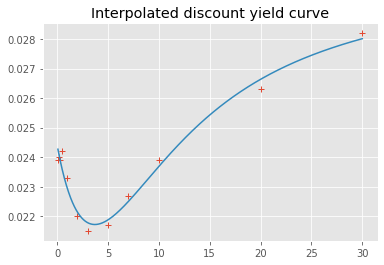

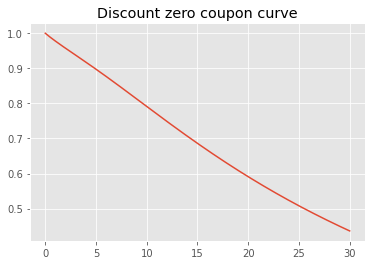

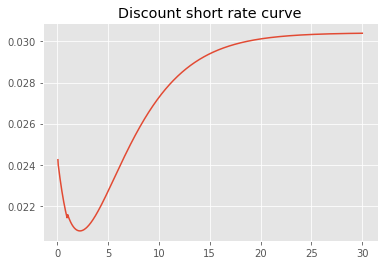

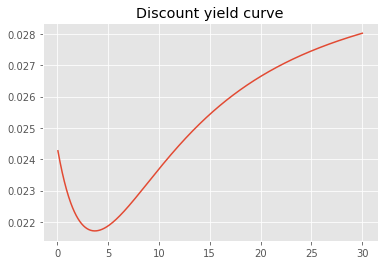

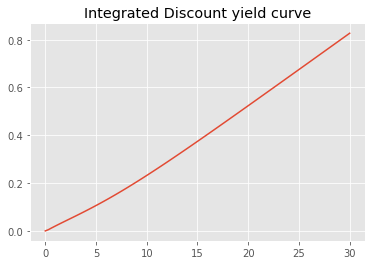

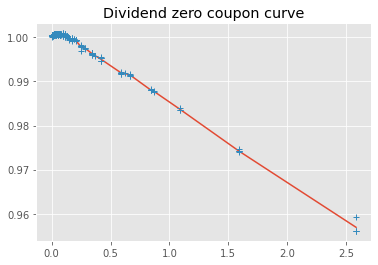

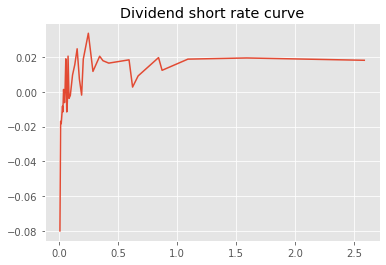

/content/bootstrapping.py:271: RuntimeWarning: invalid value encountered in double_scalars
  return (1 / x - 1) / float(t)


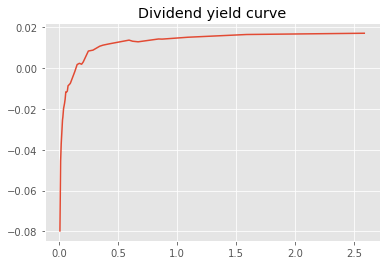

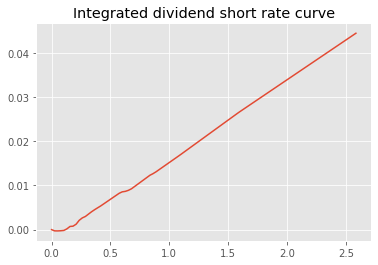

In [ ]:
workingFolder = "./"#"./data/"
fileName = "Option_SPX_18_Mai_2019Feuille2.xlsm"
asOfDate = "2019-05-18"
dataSet2, dataSetTest2 = loadData.completeCBOTData(workingFolder, fileName, asOfDate, dataSet, dataSetTest)

In [ ]:
print(dataSet.shape)
print(dataSetTest.shape)
print(dataSet2.shape)
print(dataSetTest2.shape)

(135, 15)
(144, 15)
(135, 20)
(144, 20)


In [ ]:
dataSetTest2.head()

Price     Delta  ...  ImpVolAsk  ImpVolCalibrated
Strike Maturity                   ...                             
1700.0 0.246      0.80 -0.004171  ...   0.417025          0.414192
2300.0 0.419     14.30 -0.069169  ...   0.242761          0.241534
2350.0 0.093      1.20 -0.013019  ...   0.299000          0.295657
       0.112      1.85 -0.018041  ...   0.289619          0.287296
2400.0 0.419     20.55 -0.099289  ...   0.226640          0.225549

[5 rows x 20 columns]

In [ ]:
dataSet2.head()

,,Price,Delta,Vega,Delta Strike,Gamma Strike,Theta,ChangedStrike,DividendFactor,Strike,Maturity,ImpliedVol,VegaRef,OptionType,logMoneyness,impliedTotalVariance,Bid,Ask,ImpVolBid,ImpVolAsk,ImpVolCalibrated
Strike,Maturity,,,,,,,,,,,,,,,,,,,,
2200.0,0.419,9.95,-0.047968,184.678147,0.094049,-9.963916e-07,103.538454,2194.553900,0.994628,2200.0,0.419,0.2586,169.246997,-1.0,-0.264678,0.028020,9.70,10.20,0.256366,0.259111,0.257748
2325.0,0.112,1.65,-0.015858,38.013410,0.027412,-3.969604e-05,73.268907,2323.142879,1.000111,2325.0,0.112,0.2958,15.762704,-1.0,-0.207736,0.009800,1.55,1.75,0.292955,0.298232,0.295645
2400.0,0.093,1.60,-0.017779,38.199664,0.029753,-4.470370e-05,88.192154,2398.742294,1.000292,2400.0,0.093,0.2798,22.362901,-1.0,-0.175713,0.007281,1.50,1.70,0.276697,0.281968,0.279385
2510.0,0.170,9.15,-0.074660,166.318158,0.128221,5.540400e-05,230.171845,2506.841932,0.999189,2510.0,0.170,0.2289,194.599716,-1.0,-0.131634,0.008907,8.90,9.40,0.226110,0.229151,0.227640
2525.0,0.036,0.55,-0.010731,15.378146,0.016613,-5.456899e-05,87.679835,2524.212274,1.000312,2525.0,0.036,0.2893,6.408137,-1.0,-0.124728,0.003013,NaN,NaN,0.200000,0.200000,0.286947


In [ ]:
concatDf = pd.concat([dataSet2, dataSetTest2]).sort_index()
concatDf = concatDf[~concatDf.index.duplicated(keep='first')]
concatDf.index = loadData.roundMultiIndex(concatDf.index).rename(["Strike", "Maturity"])

GPTest = pd.read_csv('GPTesting.csv').set_index(["Strike", "Maturity"]) 
GPTrain = pd.read_csv('GPTraining.csv').set_index(["Strike", "Maturity"])
GPResults = pd.concat([GPTrain, GPTest]).sort_index() 
GPResults.index = loadData.roundMultiIndex(GPResults.index).rename(["Strike", "Maturity"])

NeuralTest = pd.read_csv('NeuralImpliedVolTest.csv').set_index(["Strike", "Maturity"]) 
NeuralTrain = pd.read_csv('NeuralImpliedVolTrain.csv').set_index(["Strike", "Maturity"])
NeuralResults = pd.concat([NeuralTrain, NeuralTest]).sort_index()
NeuralResults.index = loadData.roundMultiIndex(NeuralResults.index).rename(["Strike", "Maturity"])

SSVITest = pd.read_csv('SSVITesting.csv').set_index(["Strike", "Maturity"]) 
SSVITrain = pd.read_csv('SSVITraining.csv').set_index(["Strike", "Maturity"])
SSVIResults = pd.concat([SSVITrain, SSVITest]).sort_index()
SSVIResults.index = loadData.roundMultiIndex(SSVIResults.index).rename(["Strike", "Maturity"])

NeuralResults.head()

,,Price,LocalVolatility,ImpliedVol
Strike,Maturity,,,
1700.0,0.246,99.073440,0.219740,0.283870
2200.0,0.419,238.037017,0.416036,0.258601
2300.0,0.419,265.539626,0.374586,0.243686
2325.0,0.112,315.626190,0.348550,0.285146
2350.0,0.093,333.696687,0.361102,0.290986


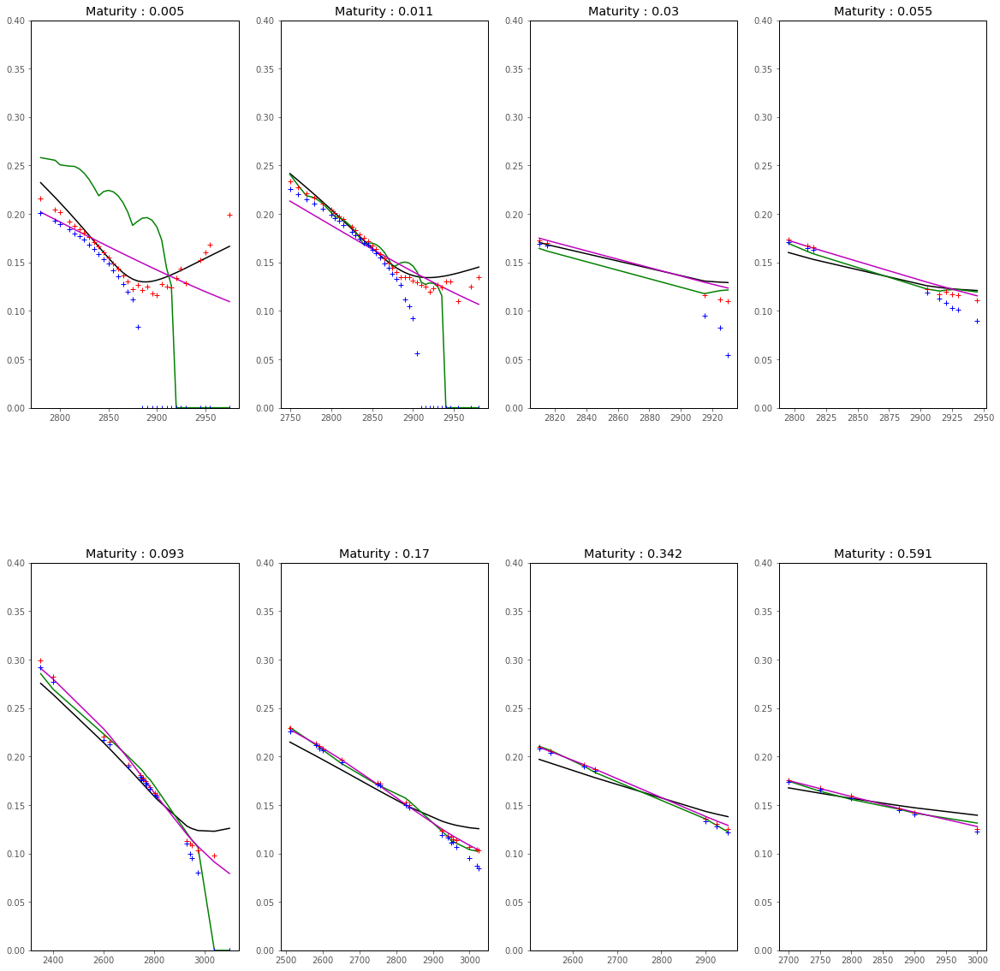

In [ ]:
plotTools.plot2dSmiles(SSVIResults,
                       GPResults,
                       NeuralResults,
                       concatDf,
                       plotMarketData = False,
                       nbObservationThreshold = 5)

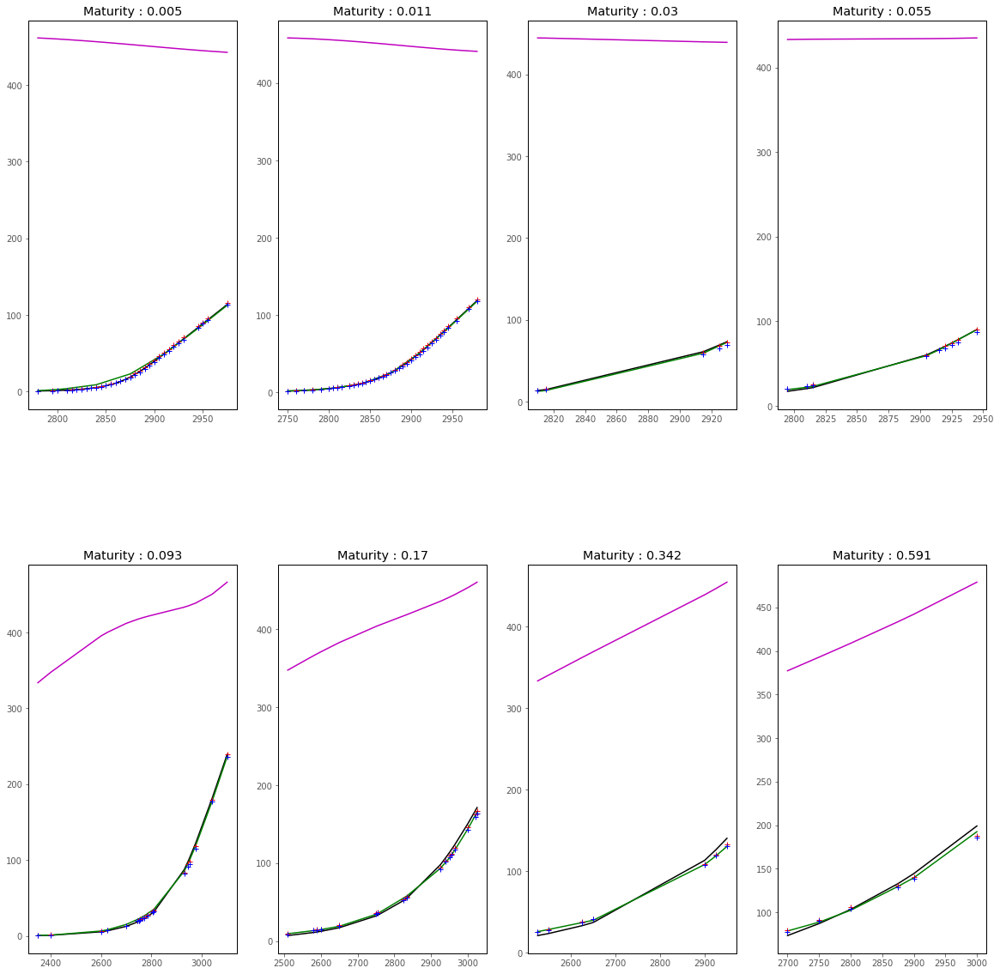

In [ ]:
plotTools.plot2dPriceSmiles(SSVIResults,
                            GPResults,
                            NeuralResults,
                            concatDf,
                            plotMarketData = False,
                            nbObservationThreshold = 5)

In [ ]:
#Run this cell if you want to record your datasets
dfCurve = dataSetConstruction.savingData(bootstrap, 
                                         dataSet, 
                                         dataSetTest, 
                                         workingFolder)

Saving bootstrapping under dfCurve.csv
Saving training set under trainingDataSet.csv
Saving bootstrapping under testingDataSet.csv


In [ ]:
#Size of training set
dataSet.shape

(135, 15)

In [ ]:
#Size of testing set
dataSetTest.shape

(144, 15)

In [ ]:
S0

2859.53

In [ ]:
#Threshold for eliminating low prices 
threshold = pd.concat([dataSet, dataSetTest])["Price"].sort_values().iloc[int(0.05 * pd.concat([dataSet, dataSetTest]).shape[0])]

In [ ]:
def getCall(df):
    return df[df["OptionType"]==1]
def getPut(df):
    return df[df["OptionType"]==-1]

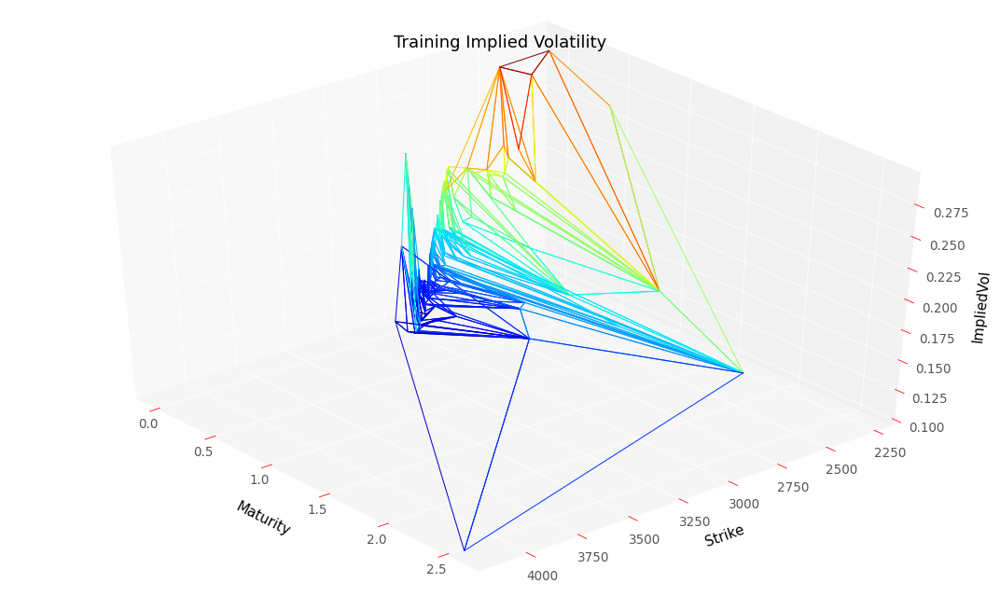

In [ ]:
plotTools.plotSerie(getPut(trainingSet)["ImpliedVol"], 
                    yMin=0,
                    yMax=3*S0, 
                    Title = 'Training Implied Volatility')

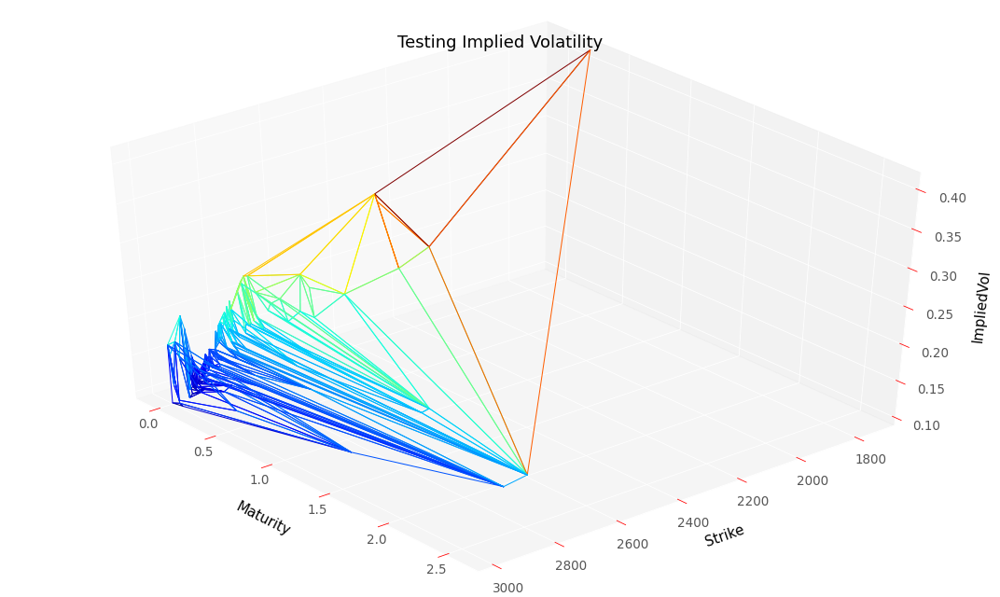

In [ ]:
plotTools.plotSerie(getPut(testingSet)["ImpliedVol"], 
                    yMin=0,
                    yMax=3*S0, 
                    Title = 'Testing Implied Volatility')

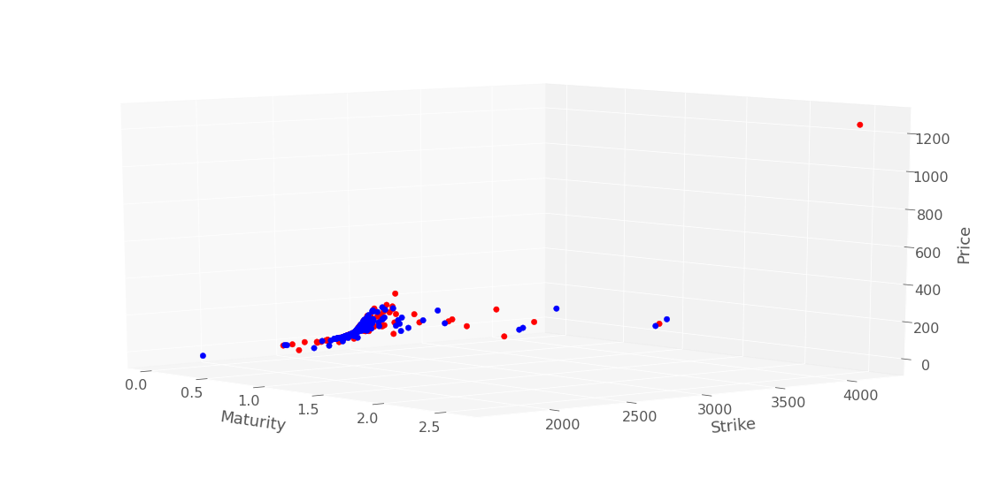

In [ ]:
plotTools.plot2Series(getPut(testingSet)["Price"], 
                      getPut(trainingSet)["Price"], 
                      yMin=0,
                      yMax=3*S0, 
                      Title = 'Price Surfaces')

In [ ]:
testingSet.shape

(144, 15)

In [ ]:
trainingSet.shape

(135, 15)

In [ ]:
dataSet.head()

,,Price,Delta,Vega,Delta Strike,Gamma Strike,Theta,ChangedStrike,DividendFactor,Strike,Maturity,ImpliedVol,VegaRef,OptionType,logMoneyness,impliedTotalVariance
Strike,Maturity,,,,,,,,,,,,,,,
2200.0,0.419,9.95,-0.047968,184.678147,0.094049,-9.963916e-07,103.538454,2194.553900,0.994628,2200.0,0.419,0.2586,169.246997,-1.0,-0.264678,0.028020
2325.0,0.112,1.65,-0.015858,38.013410,0.027412,-3.969604e-05,73.268907,2323.142879,1.000111,2325.0,0.112,0.2958,15.762704,-1.0,-0.207736,0.009800
2400.0,0.093,1.60,-0.017779,38.199664,0.029753,-4.470370e-05,88.192154,2398.742294,1.000292,2400.0,0.093,0.2798,22.362901,-1.0,-0.175713,0.007281
2510.0,0.170,9.15,-0.074660,166.318158,0.128221,5.540400e-05,230.171845,2506.841932,0.999189,2510.0,0.170,0.2289,194.599716,-1.0,-0.131634,0.008907
2525.0,0.036,0.55,-0.010731,15.378146,0.016613,-5.456899e-05,87.679835,2524.212274,1.000312,2525.0,0.036,0.2893,6.408137,-1.0,-0.124728,0.003013


## Scaling methods

Use min-max of scaling strike between 0 et 1 for improving stability of neural network training. 

Scaler is fitted on training set.

In [ ]:
dataSet["locvol"] = np.ones_like(dataSet["ImpliedVol"]) 
dataSetTest["locvol"] = np.ones_like(dataSetTest["ImpliedVol"]) 

In [ ]:
scaler = skl.preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler.fit(dataSet)
scaledDataSet = neuralNetwork.transformCustom(dataSet, scaler)
scaledDataSetTest = neuralNetwork.transformCustom(dataSetTest, scaler)

In [ ]:
scaledDataSet.head()

,,Price,Delta,Vega,Delta Strike,Gamma Strike,Theta,ChangedStrike,DividendFactor,Strike,Maturity,ImpliedVol,VegaRef,OptionType,logMoneyness,impliedTotalVariance,locvol
Strike,Maturity,,,,,,,,,,,,,,,,
2200.0,0.419,9.95,-0.047968,184.678147,0.094049,-9.963916e-07,103.538454,2194.553900,0.994628,2200.0,0.419,0.2586,169.246997,-1.0,-0.264678,0.028020,1.0
2325.0,0.112,1.65,-0.015858,38.013410,0.027412,-3.969604e-05,73.268907,2323.142879,1.000111,2325.0,0.112,0.2958,15.762704,-1.0,-0.207736,0.009800,1.0
2400.0,0.093,1.60,-0.017779,38.199664,0.029753,-4.470370e-05,88.192154,2398.742294,1.000292,2400.0,0.093,0.2798,22.362901,-1.0,-0.175713,0.007281,1.0
2510.0,0.170,9.15,-0.074660,166.318158,0.128221,5.540400e-05,230.171845,2506.841932,0.999189,2510.0,0.170,0.2289,194.599716,-1.0,-0.131634,0.008907,1.0
2525.0,0.036,0.55,-0.010731,15.378146,0.016613,-5.456899e-05,87.679835,2524.212274,1.000312,2525.0,0.036,0.2893,6.408137,-1.0,-0.124728,0.003013,1.0


In [ ]:
#Search strike for ATM option
midS0 = dataSet[dataSet.index.get_level_values("Strike") >= S0].index.get_level_values("Strike").min()

## Plot functions

Display original data.

In [ ]:
KMin = 0#0.7 * S0[0]
KMax = 2.0 * S0#1.3 * S0[0]


In [ ]:
dataSet.head()

,,Price,Delta,Vega,Delta Strike,Gamma Strike,Theta,ChangedStrike,DividendFactor,Strike,Maturity,ImpliedVol,VegaRef,OptionType,logMoneyness,impliedTotalVariance,locvol
Strike,Maturity,,,,,,,,,,,,,,,,
2200.0,0.419,9.95,-0.047968,184.678147,0.094049,-9.963916e-07,103.538454,2194.553900,0.994628,2200.0,0.419,0.2586,169.246997,-1.0,-0.264678,0.028020,1.0
2325.0,0.112,1.65,-0.015858,38.013410,0.027412,-3.969604e-05,73.268907,2323.142879,1.000111,2325.0,0.112,0.2958,15.762704,-1.0,-0.207736,0.009800,1.0
2400.0,0.093,1.60,-0.017779,38.199664,0.029753,-4.470370e-05,88.192154,2398.742294,1.000292,2400.0,0.093,0.2798,22.362901,-1.0,-0.175713,0.007281,1.0
2510.0,0.170,9.15,-0.074660,166.318158,0.128221,5.540400e-05,230.171845,2506.841932,0.999189,2510.0,0.170,0.2289,194.599716,-1.0,-0.131634,0.008907,1.0
2525.0,0.036,0.55,-0.010731,15.378146,0.016613,-5.456899e-05,87.679835,2524.212274,1.000312,2525.0,0.036,0.2893,6.408137,-1.0,-0.124728,0.003013,1.0


In [ ]:
importlib.reload(plotTools)

<module 'plotTools' from '/content/plotTools.py'>

In [ ]:
dataSet.shape

(135, 16)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


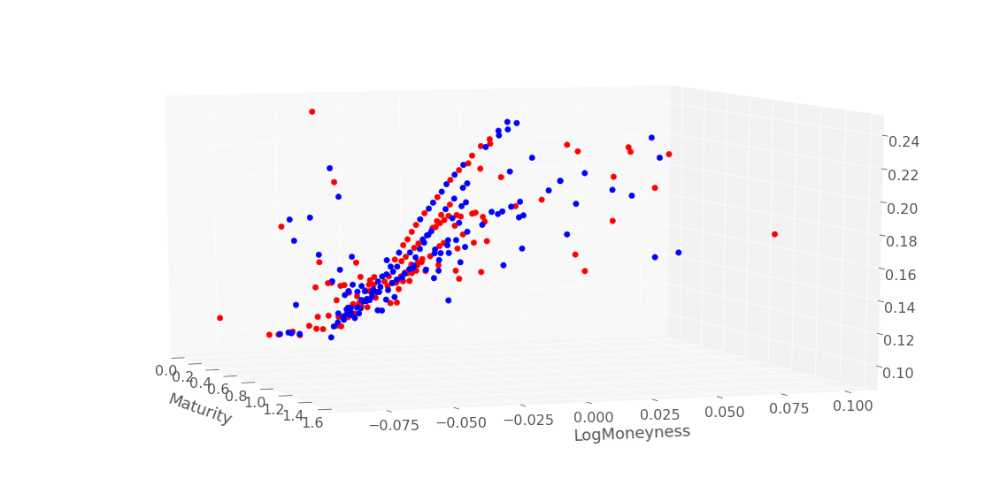

In [ ]:
filter = dataSet["Maturity"] <= 2.0
filterTest = dataSetTest["Maturity"] <= 2.0
logMin = np.log(KMin/S0)
logMax = 0.1 #np.log(KMax/S0), 
plotTools.plot2Series(plotTools.convertToLogMoneyness(dataSetTest[filterTest]["ImpliedVol"], S0), 
                      plotTools.convertToLogMoneyness(dataSet[filter]["ImpliedVol"], S0), 
                      yMin=logMin,
                      yMax=logMax,
                      az = 340,
                      Title = 'Implied Vol Surface')

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


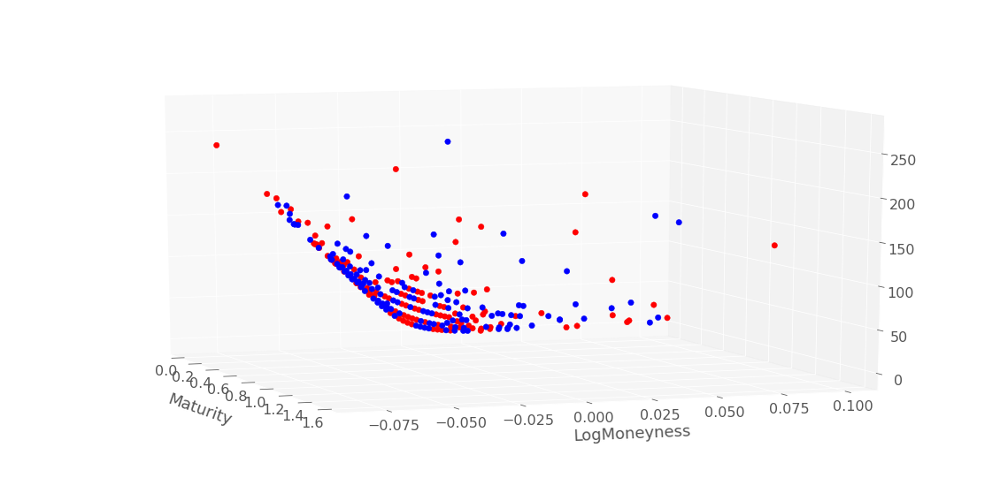

In [ ]:
filter = dataSet["Maturity"] <= 2.0
filterTest = dataSetTest["Maturity"] <= 2.0
logMin = np.log(KMin/S0), 
logMax = 0.1 #np.log(KMax/S0), 
plotTools.plot2Series(plotTools.convertToLogMoneyness(dataSetTest[filterTest]["Price"], S0), 
                      plotTools.convertToLogMoneyness(dataSet[filter]["Price"], S0), 
                      yMin=logMin,
                      yMax=logMax,
                      az = 340,
                      Title = 'Price Surface')

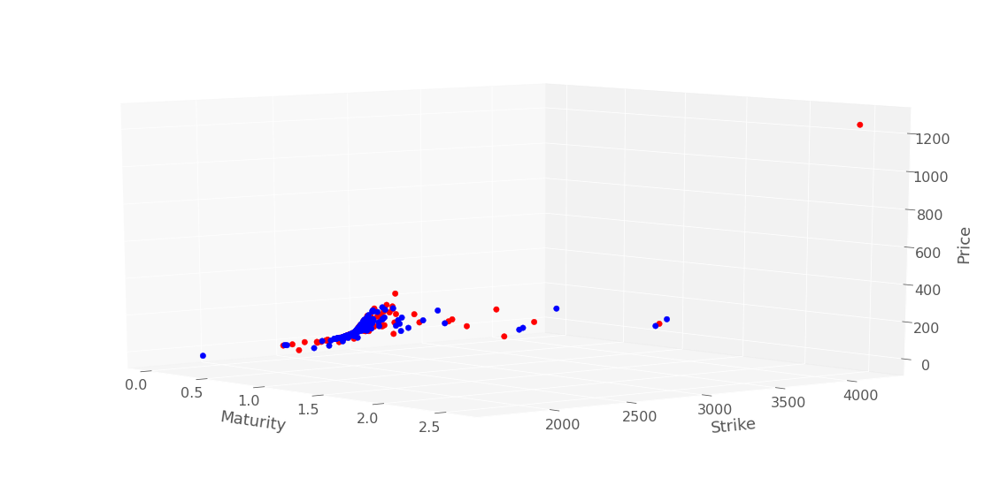

In [ ]:
plotTools.plot2Series(dataSetTest["Price"], 
                      dataSet["Price"], 
                      yMin=KMin,
                      yMax=KMax, 
                      Title = 'True Price Surface')

In [ ]:
importlib.reload(plotTools)

<module 'plotTools' from '/content/plotTools.py'>

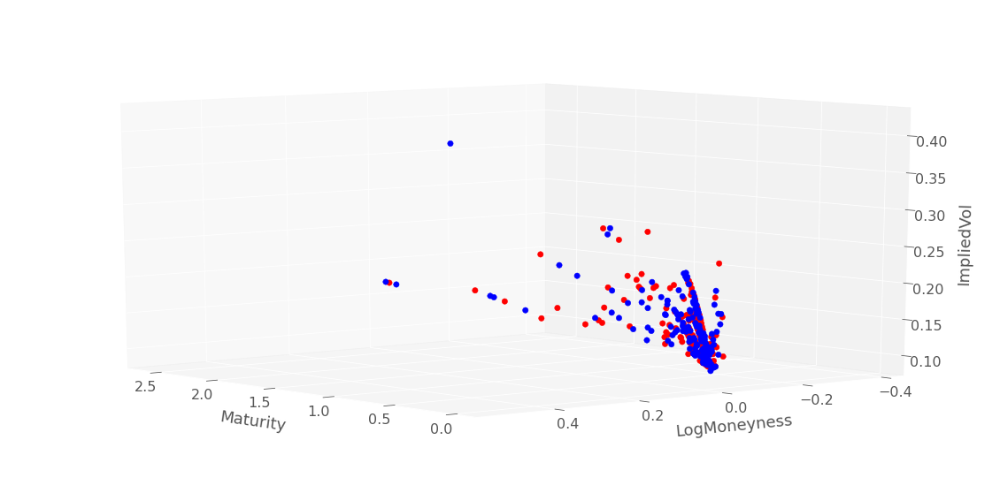

In [ ]:
plotTools.plot2Series(plotTools.convertToLogMoneyness(dataSetTest[dataSetTest.Maturity > 0], S0)["ImpliedVol"], 
                      plotTools.convertToLogMoneyness(dataSet[dataSet.Maturity > 0], S0)["ImpliedVol"], 
                      yMin=-1000,
                      yMax=1000, 
                      Title = 'Implied vol Surfaces', 
                      az=140)

In [ ]:
%matplotlib inline

# Learning Implied volatility
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [ ]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 0.11#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 1#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 10#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.0#0.01
hyperparameters["lowerBoundGamma"] = 0.0#0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10
hyperparameters["DupireVolLowerBound"] = 0.05
hyperparameters["DupireVolUpperBound"] = 0.40

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.1
hyperparameters["Patience"] = 100
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

In [ ]:
importlib.reload(neuralNetwork)

<module 'neuralNetwork' from '/content/neuralNetwork.py'>

In [ ]:
#Execute this cell if you want to fit neural network with implied volatilities
res = neuralNetwork.create_train_model_gatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                                scaledDataSet,
                                                True,
                                                hyperparameters,
                                                scaler,
                                                modelName = "convexSoftGatheralVolModel")
y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

Iteration :  355 new learning rate :  0.010000000000000002
Best loss (hidden nodes: 100, iterations: 356): -3.50
Best Penalization :  [0.030215995, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 3.1781143e-05]]
Iteration :  1091 new learning rate :  0.0010000000000000002
Best loss (hidden nodes: 100, iterations: 1092): -4.60
Best Penalization :  [0.009317406, [4.551939e-06, 0.0, 0.0004499783]]
Best Penalization (Refined Grid) :  [[0.00014977602, 0.0, 0.0005429561]]
Iteration :  2870 new learning rate :  0.00010000000000000003
Best loss (hidden nodes: 100, iterations: 2871): -4.79
Best Penalization :  [0.007822812, [1.767624e-05, 0.0, 9.728561e-05]]
Best Penalization (Refined Grid) :  [[0.00028959243, 0.0, 0.00020873113]]
Iteration :  3093 new learning rate :  1.0000000000000004e-05
Best loss (hidden nodes: 100, iterations: 3094): -4.79
Best Penalization :  [0.0078099347, [1.7677985e-05, 0.0, 0.00010157394]]
Best Penalization (Refined Grid) :  [[0.00028975398, 0.0, 0.0

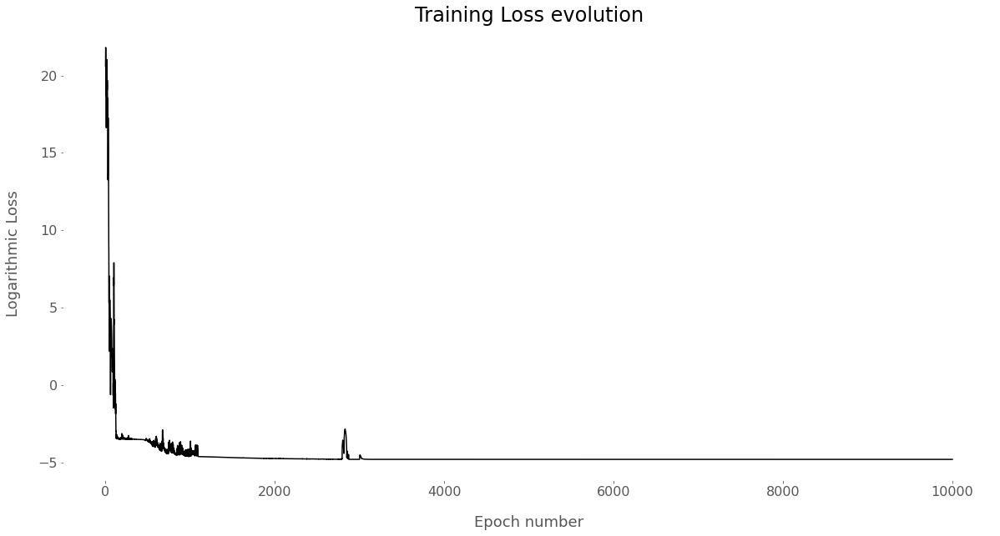

-4.791602611541748

In [ ]:
plotTools.plotEpochLoss(lossSerie4G)
lossSerie4G.iloc[-1]

In [ ]:
y_pred4G.head()

Strike  Maturity
2200.0  0.419       0.028020
2325.0  0.112       0.010105
2400.0  0.093       0.007925
2510.0  0.170       0.009105
2525.0  0.036       0.003005
Name: Price, dtype: float32

In [ ]:
[1,2,3][-3:]

[1, 2, 3]

Best loss (hidden nodes: 100, iterations: 0): -4.85
Best Penalization :  [0.0077710683, [0.0, 0.0, 2.7372242e-05]]
Best Penalization (Refined Grid):  [[0.0, 0.0, 2.3141181e-05]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


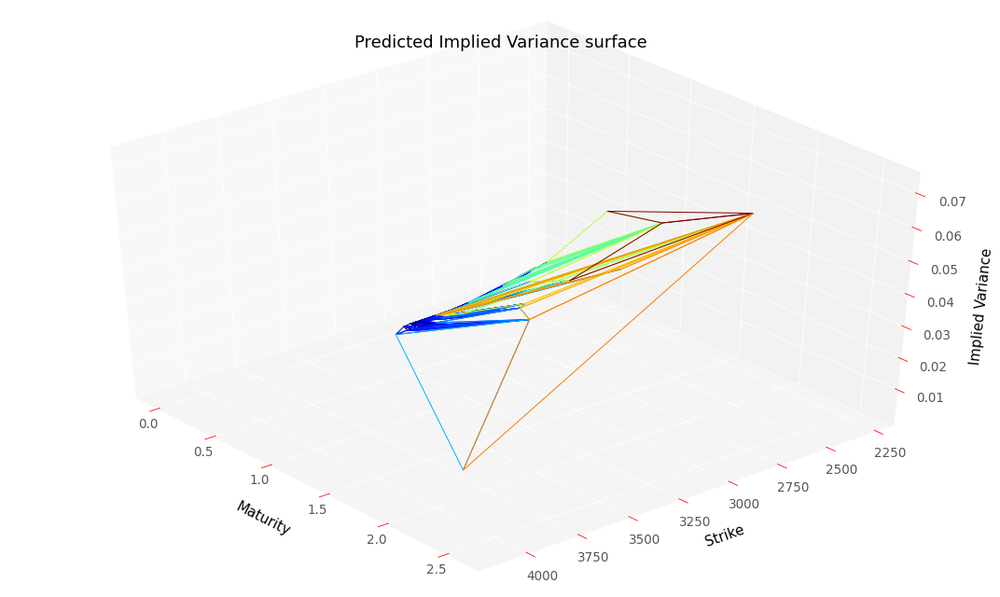

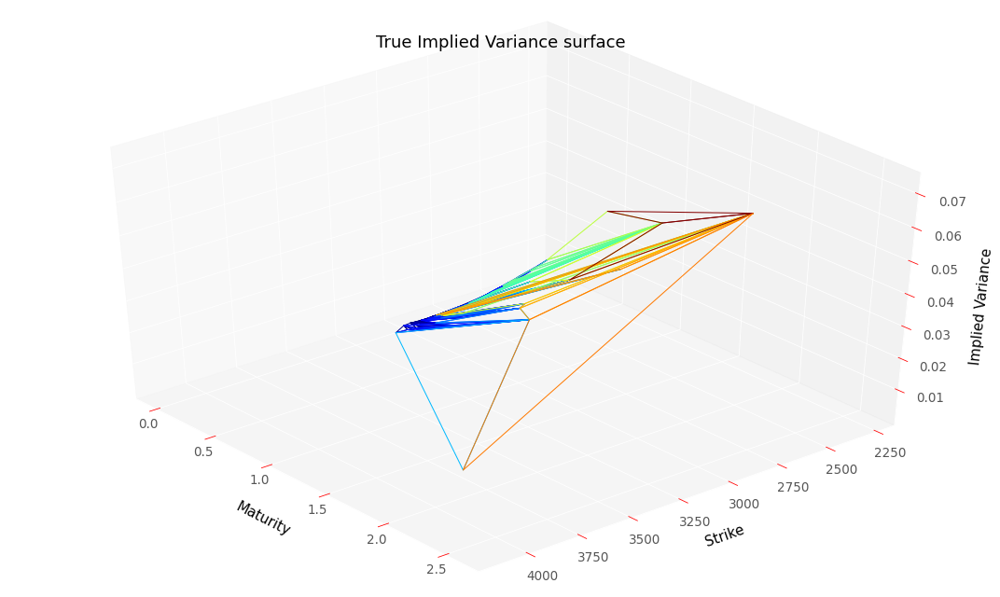

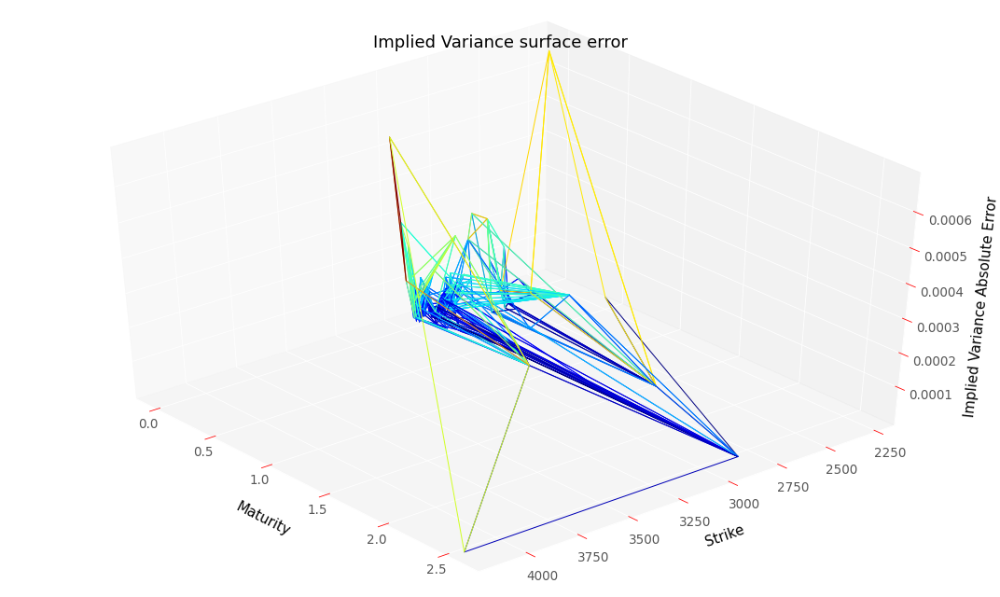

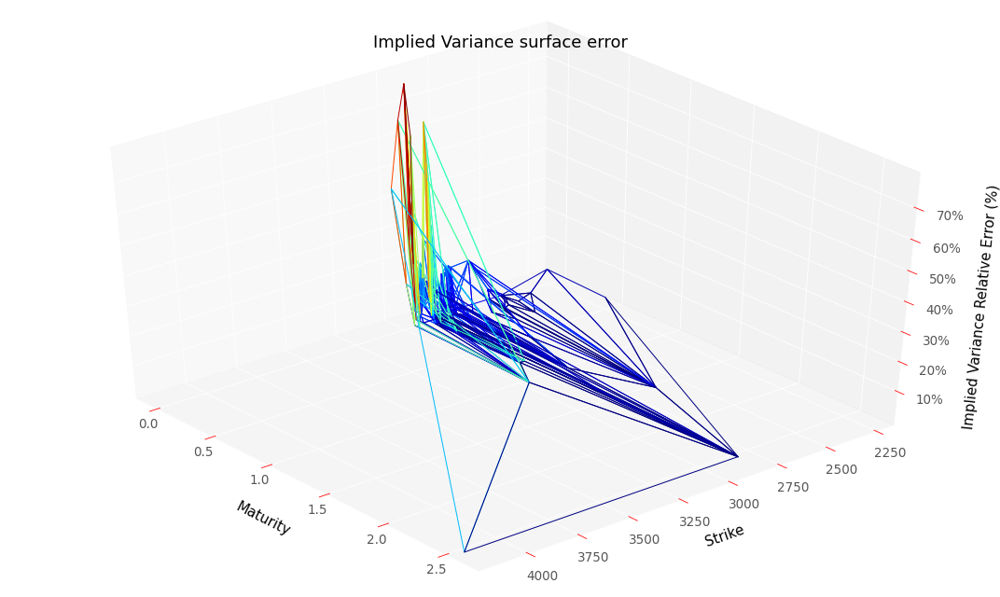

RMSE :  0.00011737072502775169
RMSE Relative:  0.17366689367316374


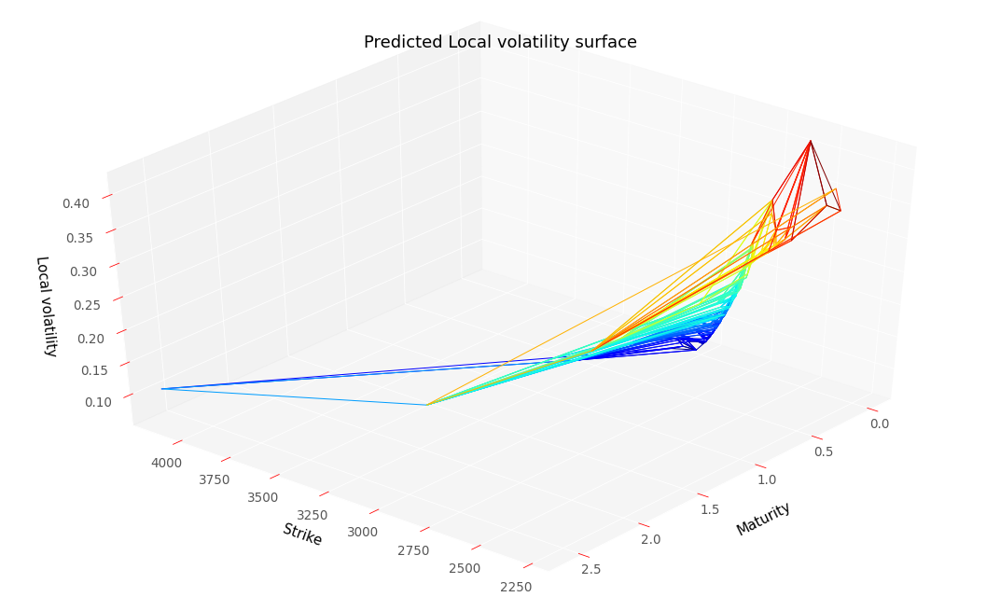

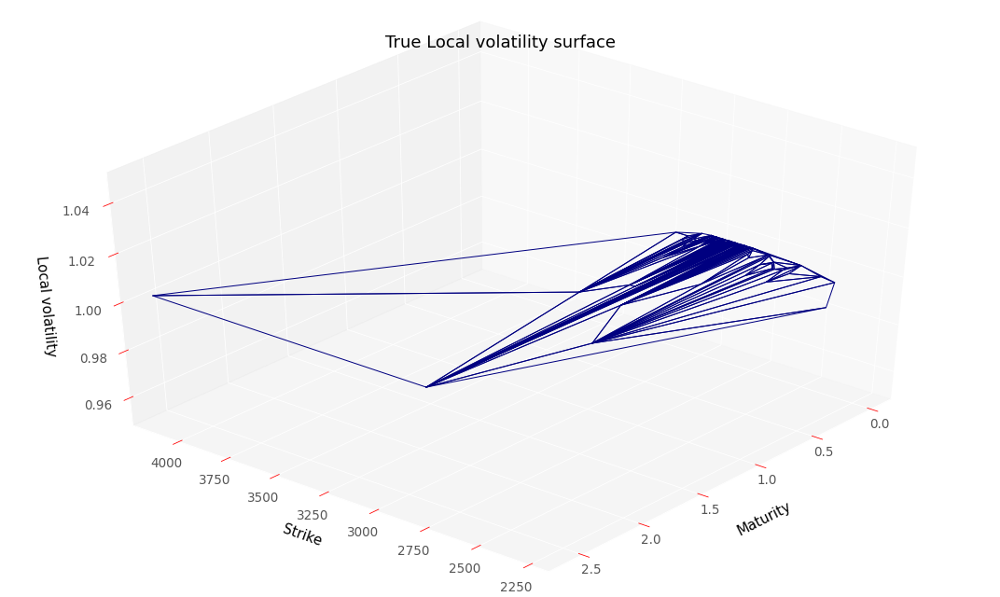

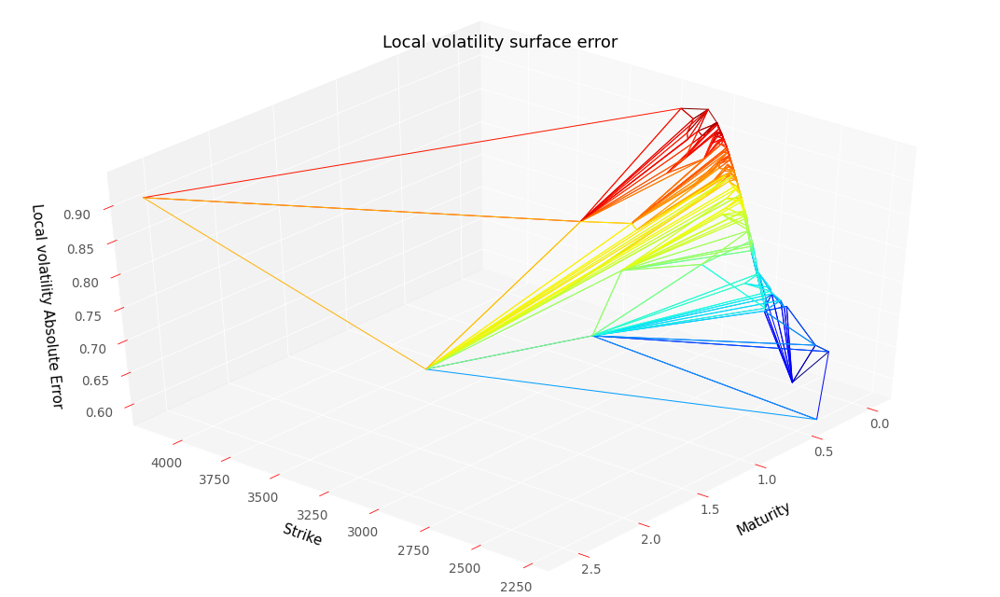

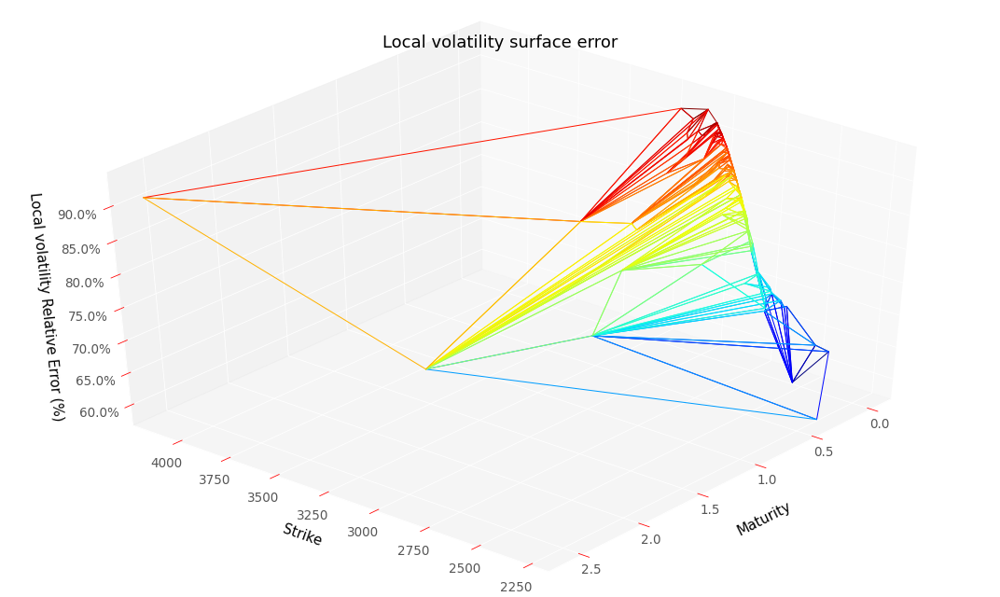

RMSE :  0.8422661937673223
RMSE Relative:  0.8422661937673223


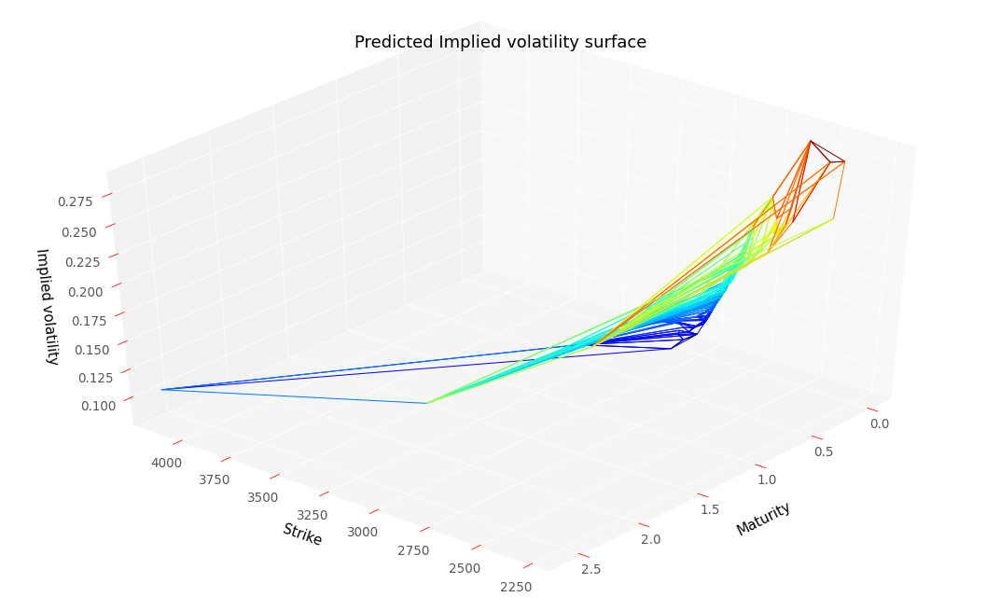

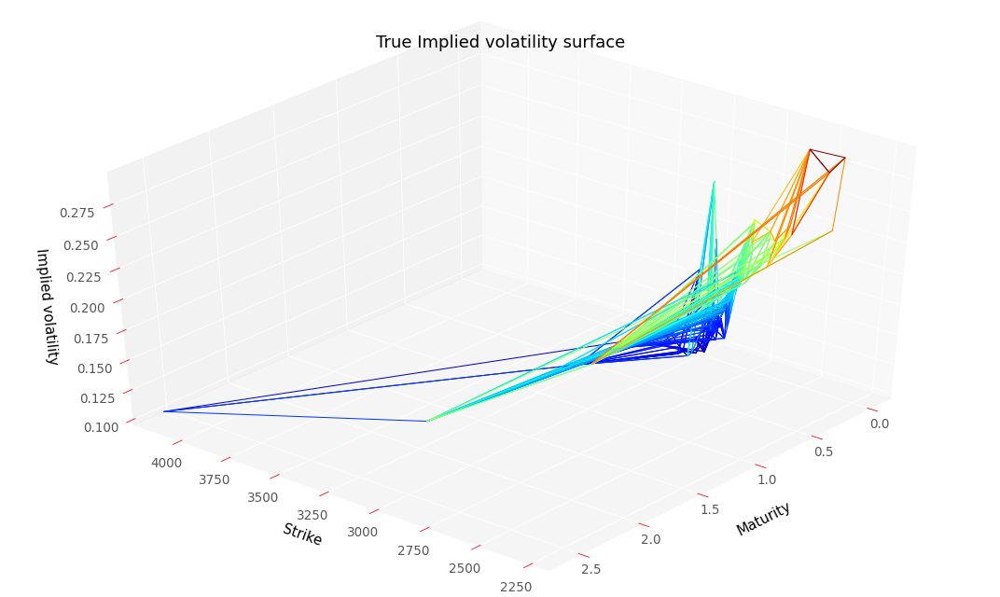

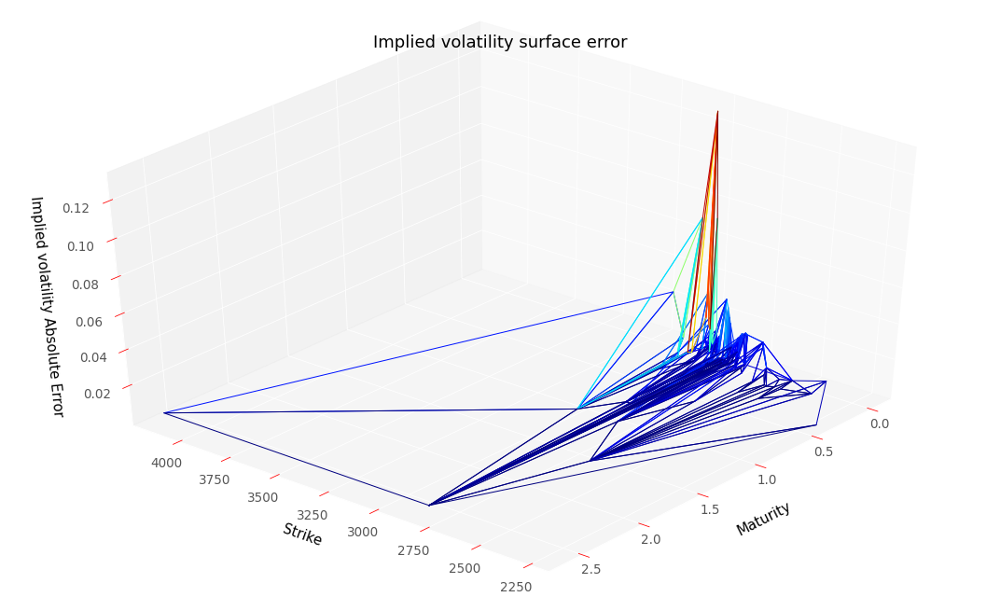

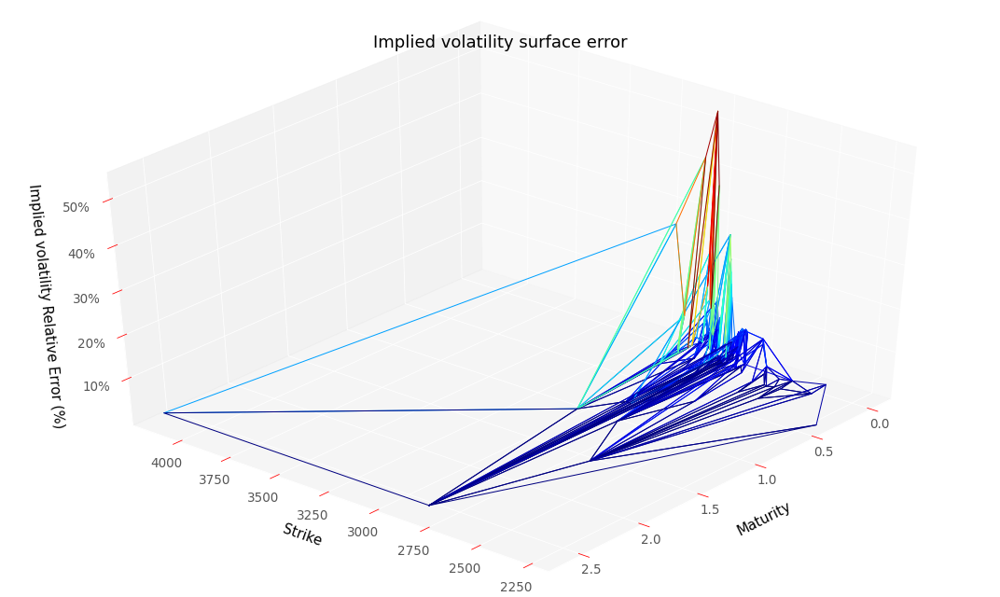

RMSE :  0.01729487649982604
RMSE Relative:  0.09700772649388352


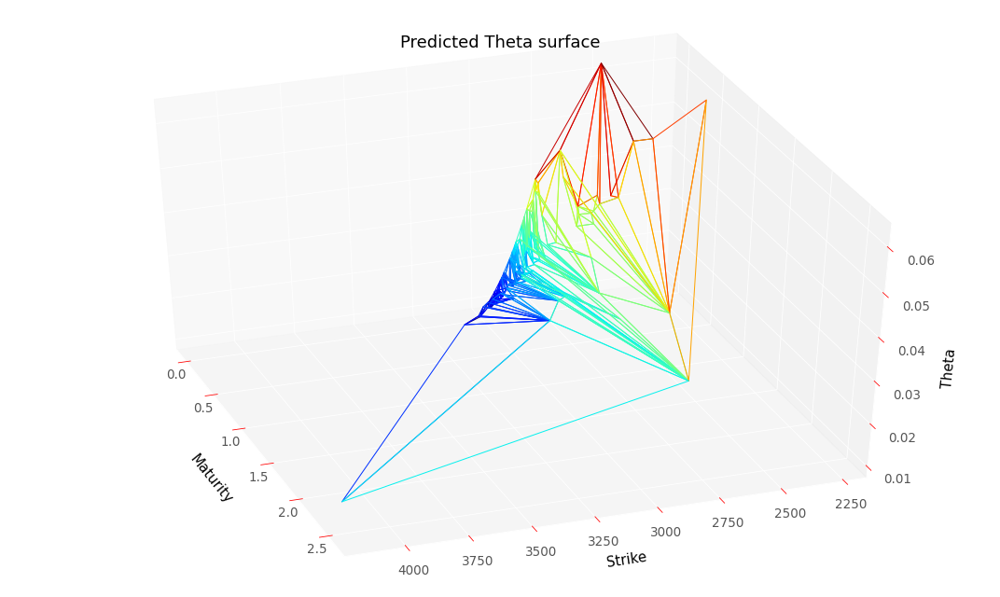

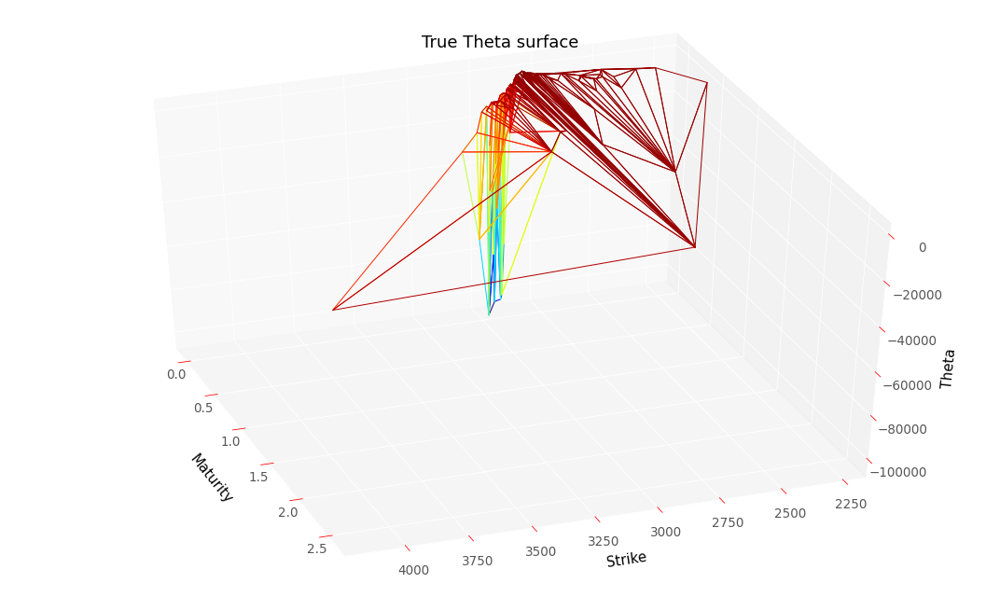

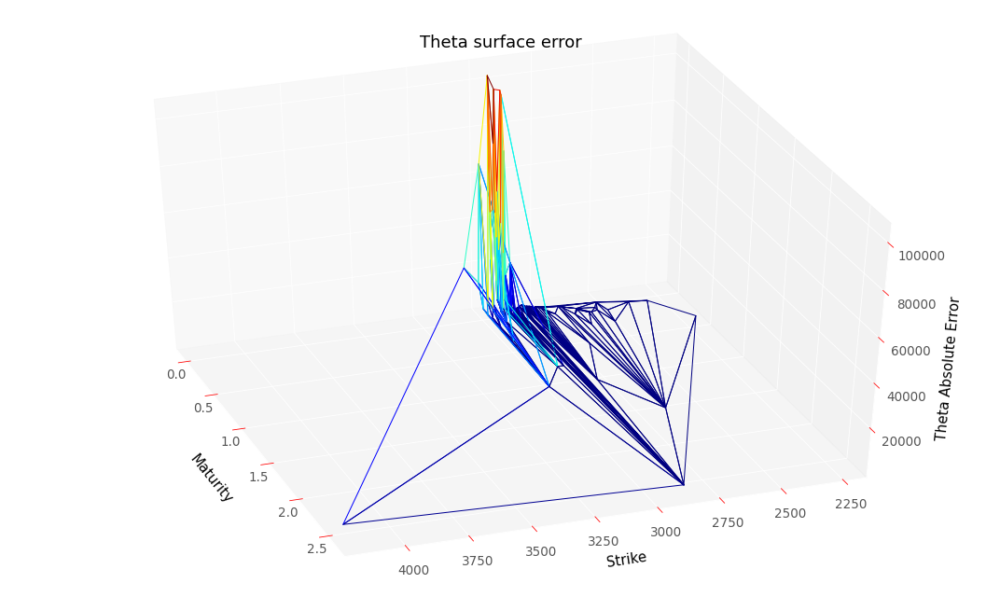

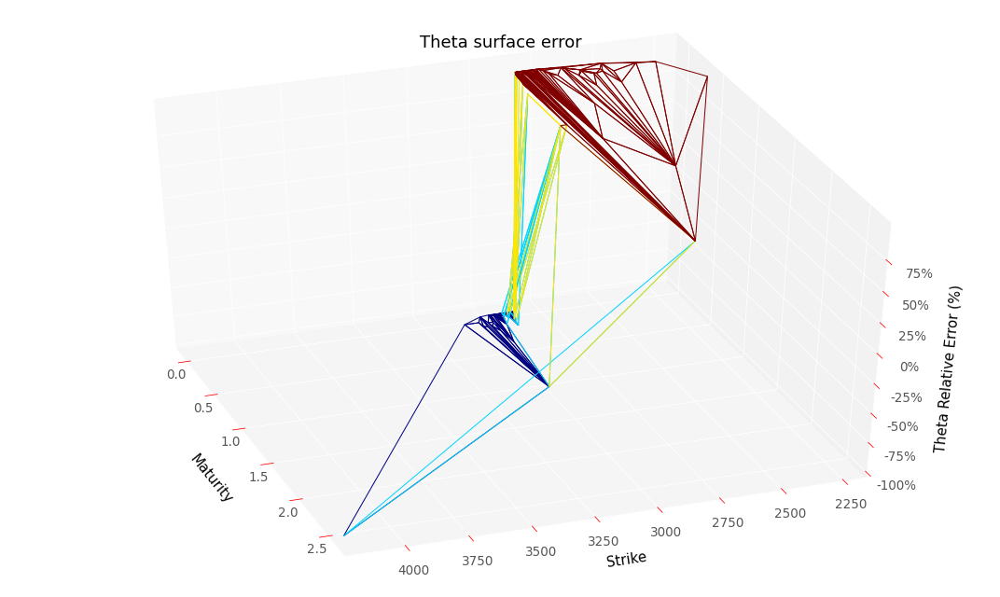

RMSE :  24400.9320965185
RMSE Relative:  0.9999502509702101


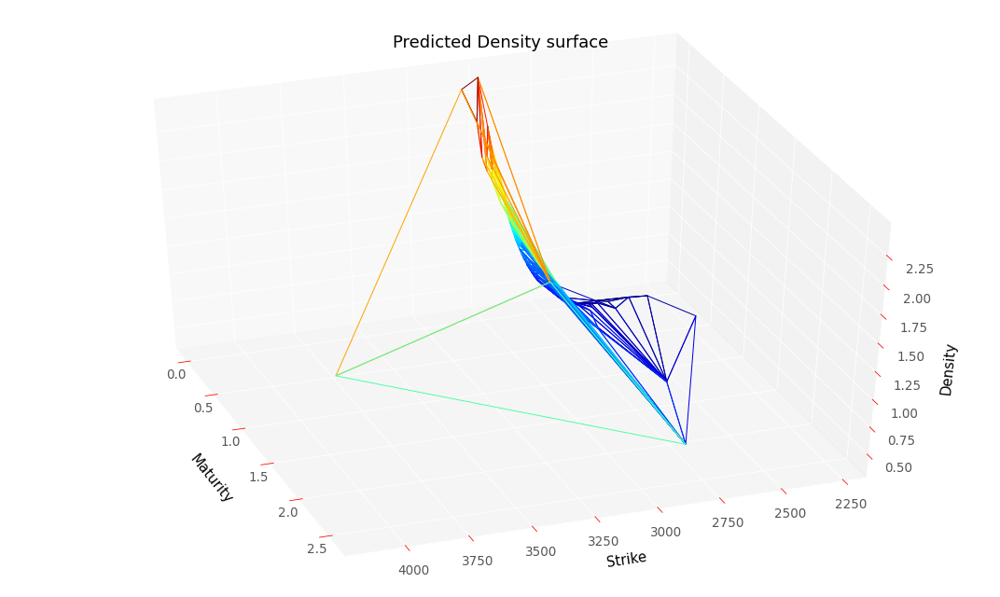

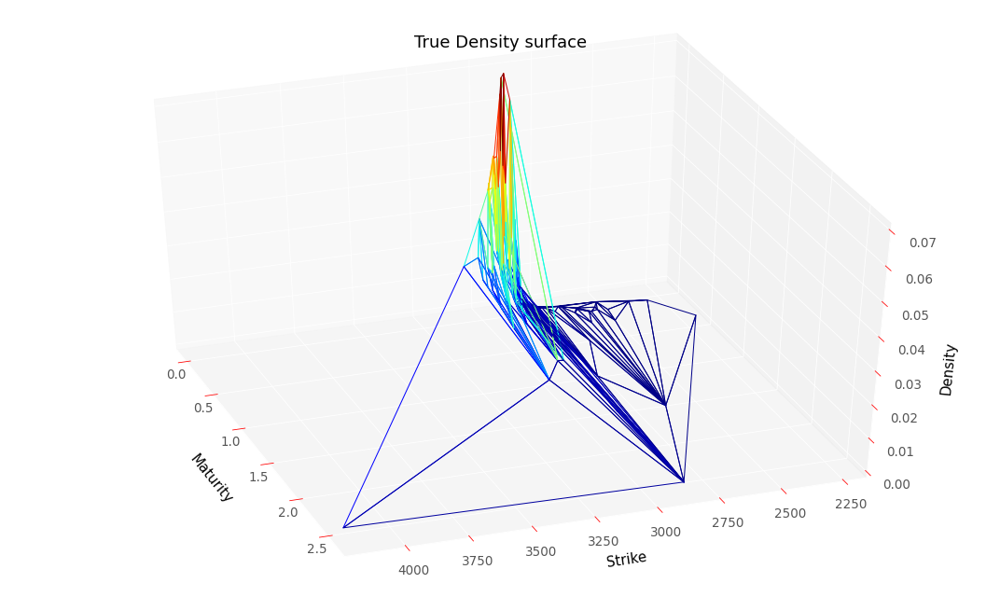

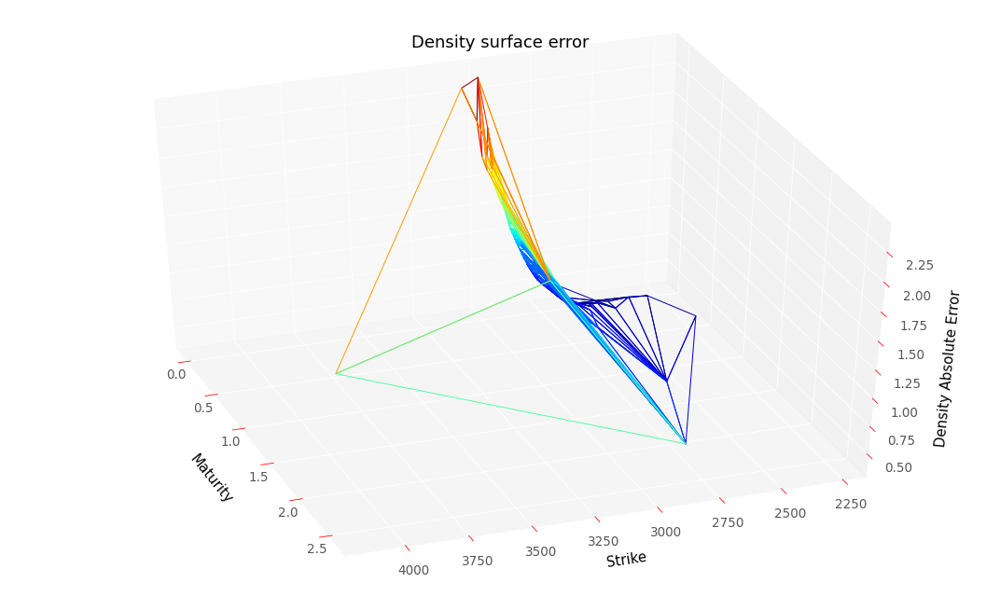

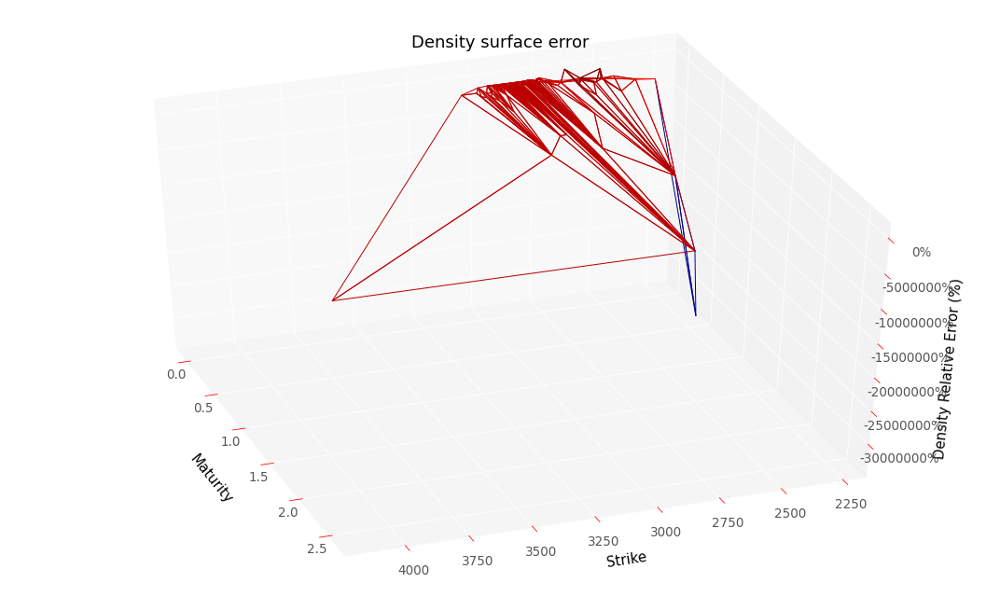

RMSE :  1.174163600695211
RMSE Relative:  29520.87755444783


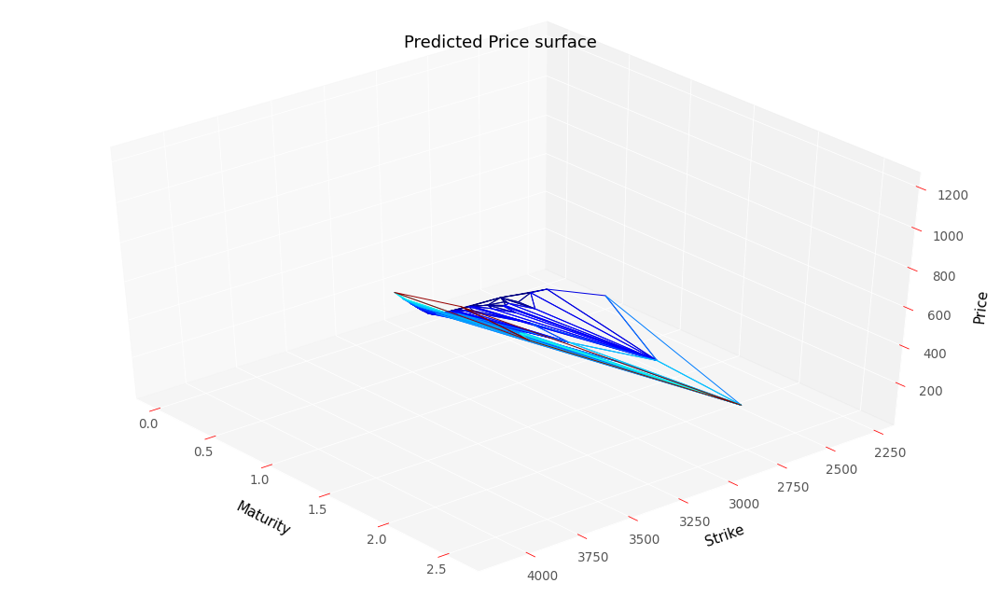

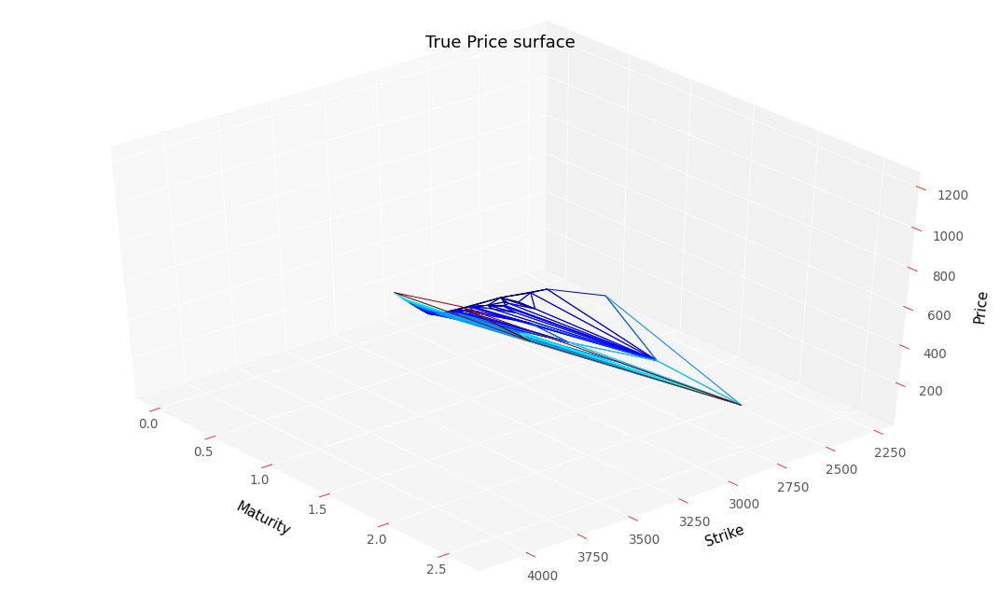

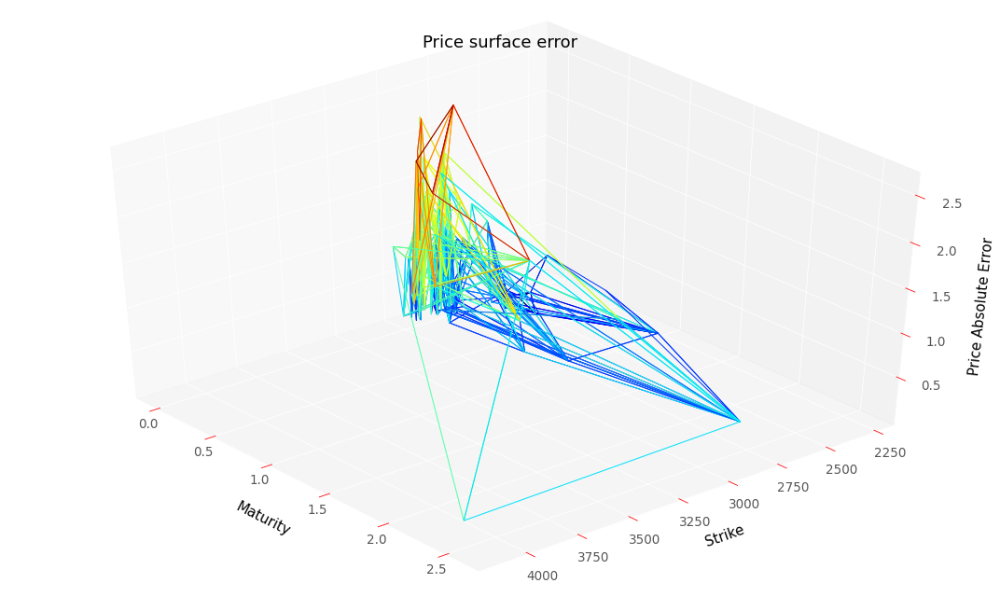

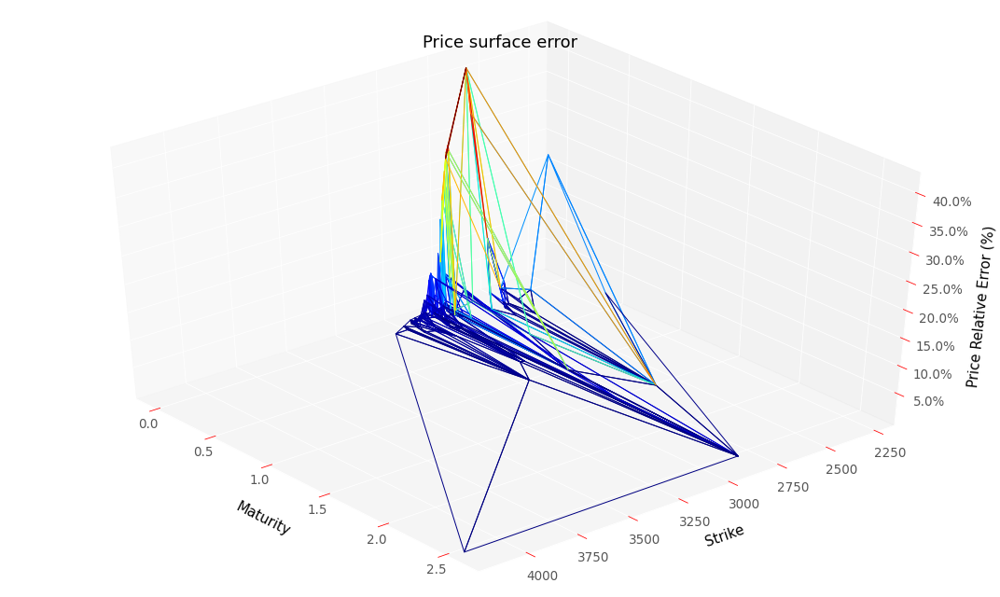

RMSE :  0.9073733582329584
RMSE Relative:  0.08660347543783638


In [ ]:
# Evaluate results on the training set, you can execute that cell without training the model
res = neuralNetwork.create_eval_model_gatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               scaledDataSet,
                                               True,
                                               hyperparameters,
                                               scaler,
                                               modelName = "convexSoftGatheralVolModel")
y_pred4G, volLocale4G, dNN_T4G, gNN_K4G, lossSerie4G = res

plotTools.modelSummaryGatheral(y_pred4G, 
                               volLocale4G, 
                               dNN_T4G, 
                               gNN_K4G, 
                               dataSet,
                               yMin = KMin,
                               yMax = KMax, 
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               savePath = "NeuralImpliedVolTrain")

In [ ]:
volLocale4G.loc[(midS0,slice(None))]

Strike  Maturity
2860.0  0.005       0.184089
        0.011       0.162957
        0.036       0.136195
        0.074       0.134722
        0.112       0.135602
        0.285       0.154036
Name: Dupire, dtype: float32

Best loss (hidden nodes: 100, iterations: 0): -4.66
Best Penalization :  [0.0094402125, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid):  [[0.0, 0.0, 2.3141181e-05]]
Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


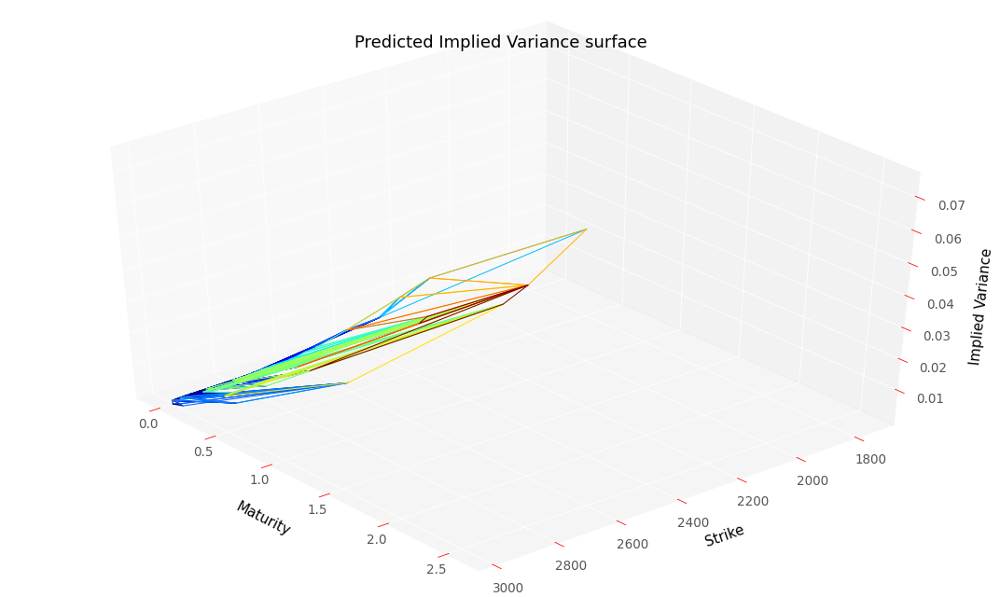

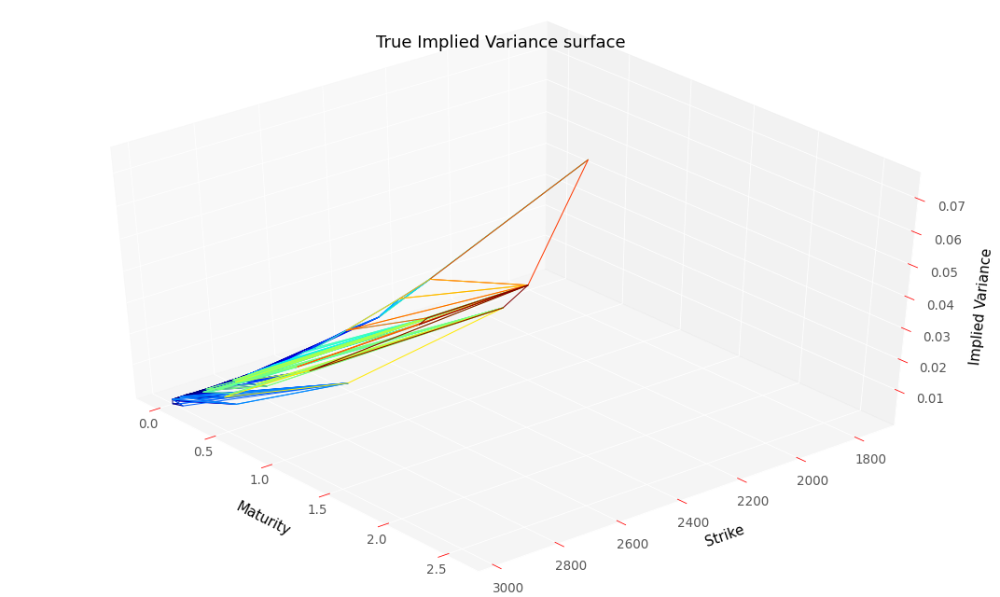

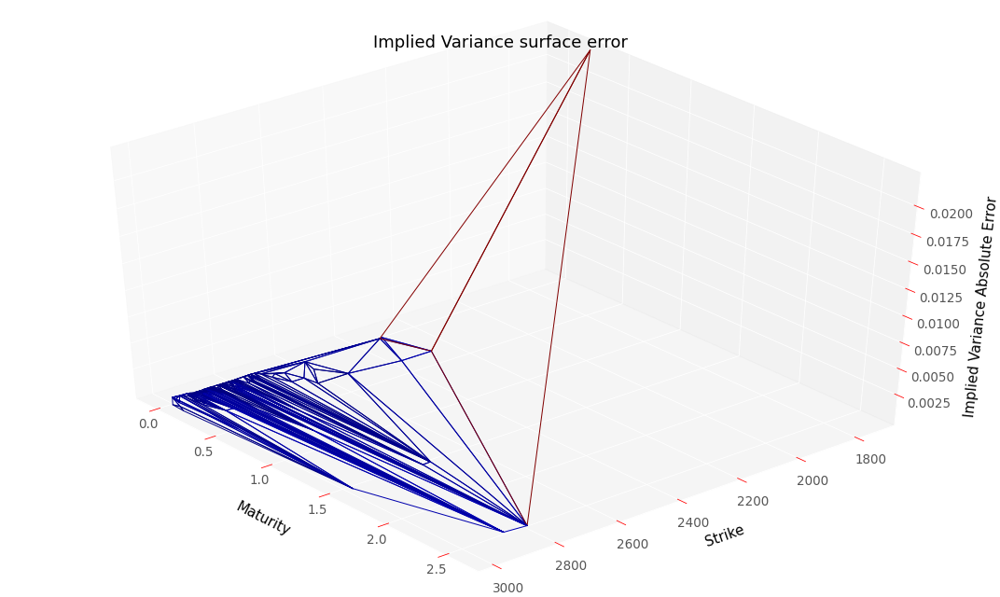

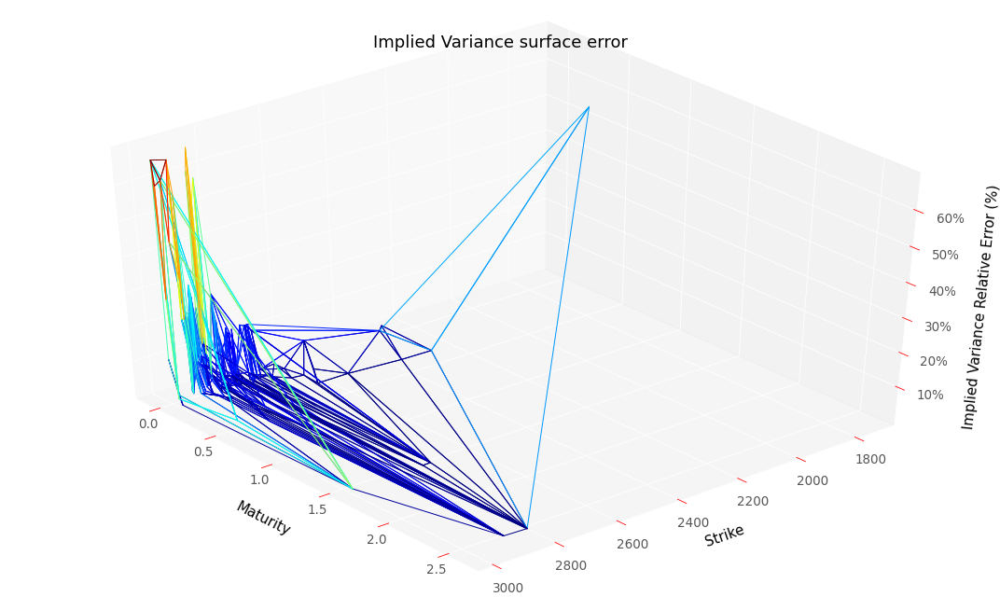

RMSE :  0.0018777898557249182
RMSE Relative:  0.1968551750690315


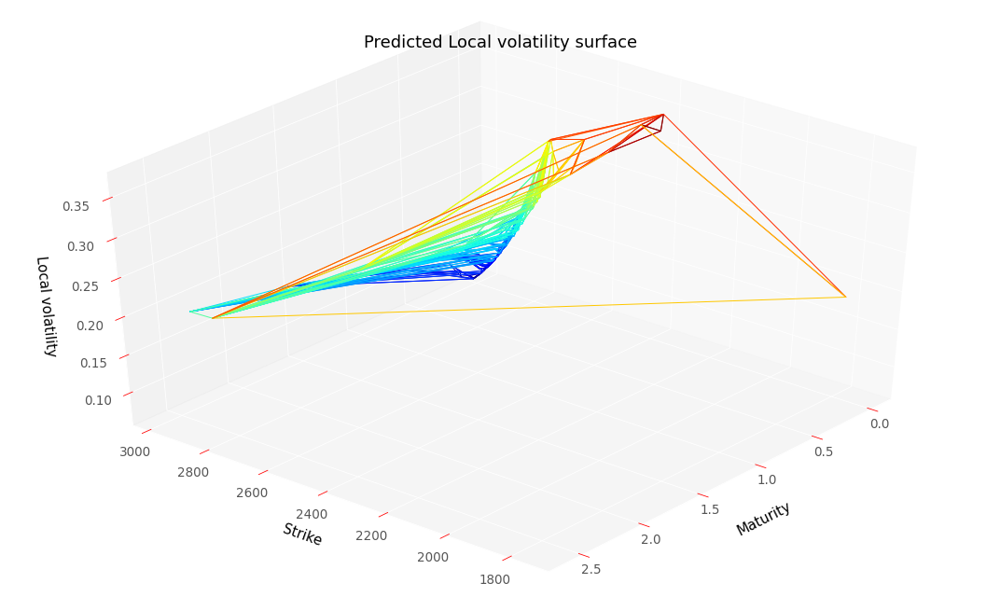

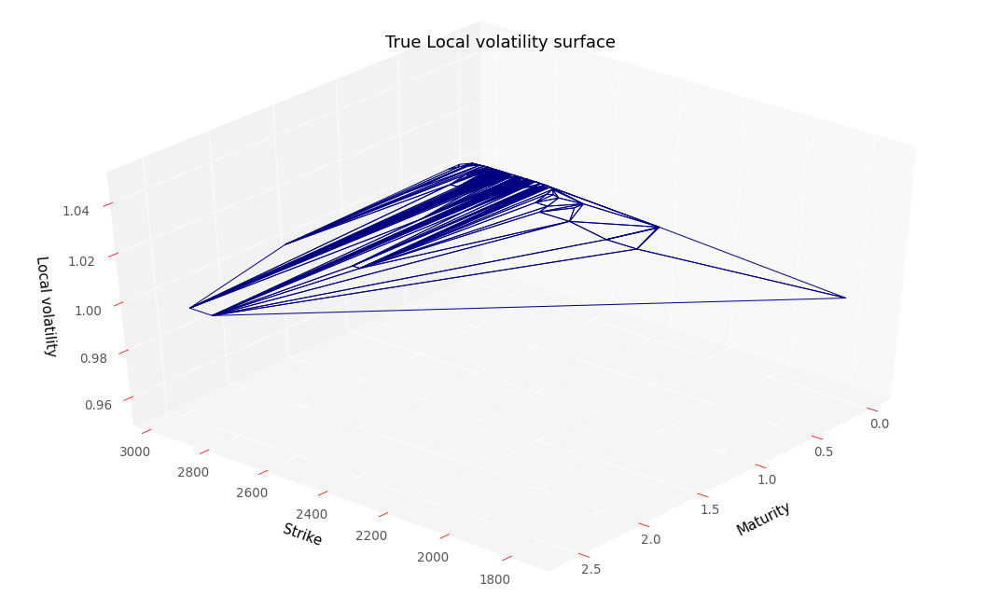

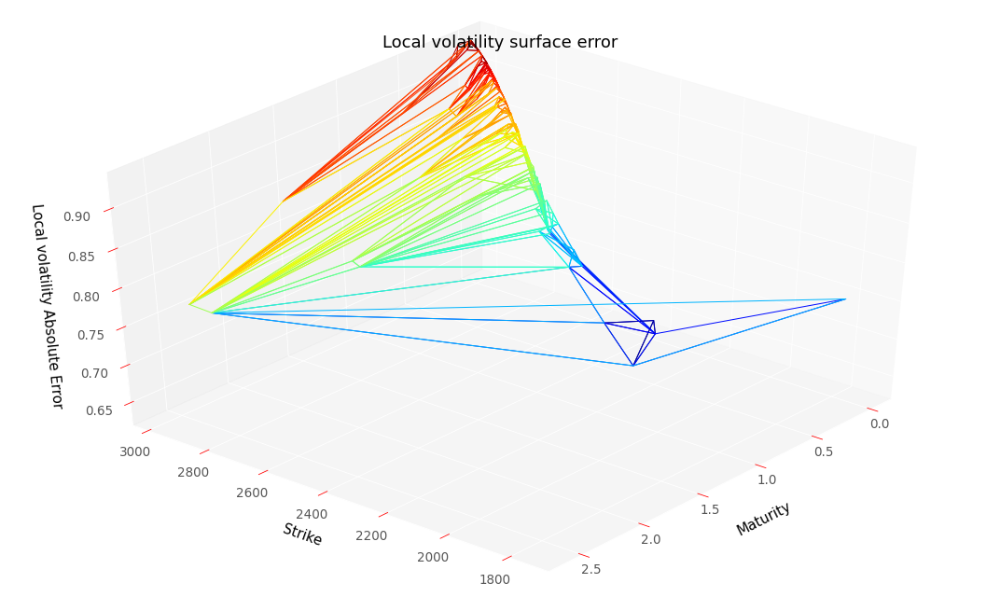

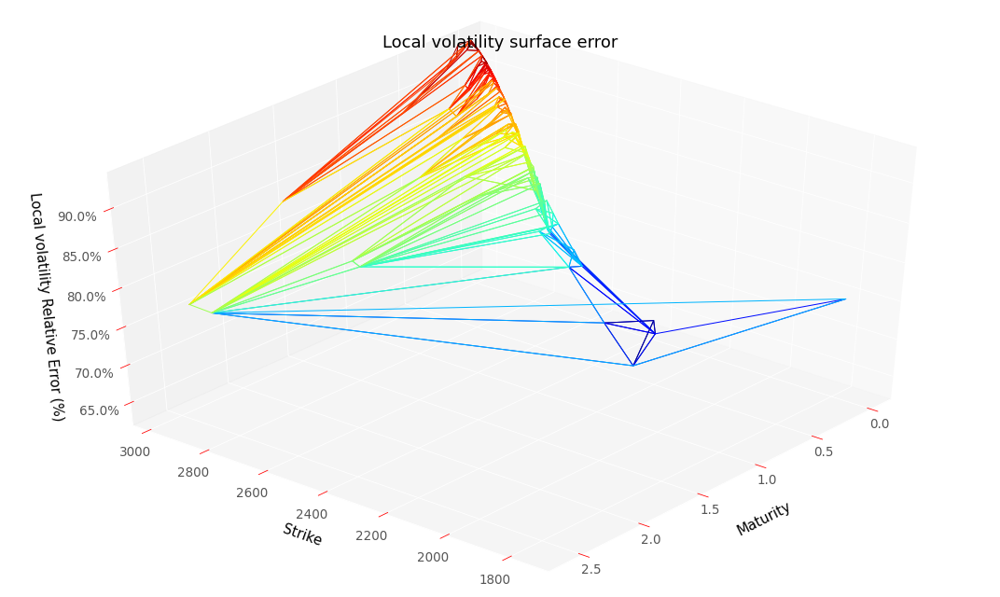

RMSE :  0.8441047102240293
RMSE Relative:  0.8441047102240293


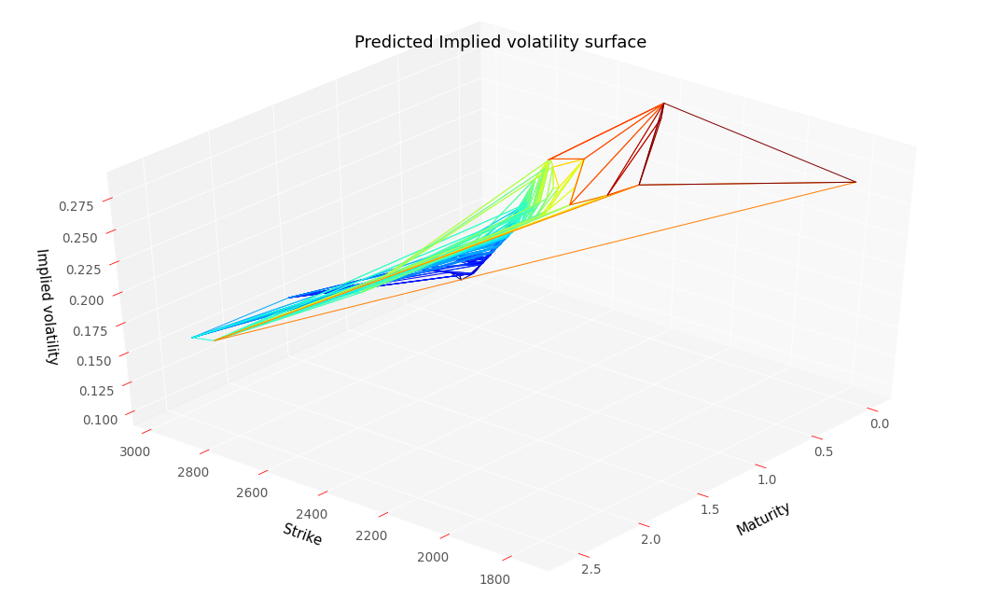

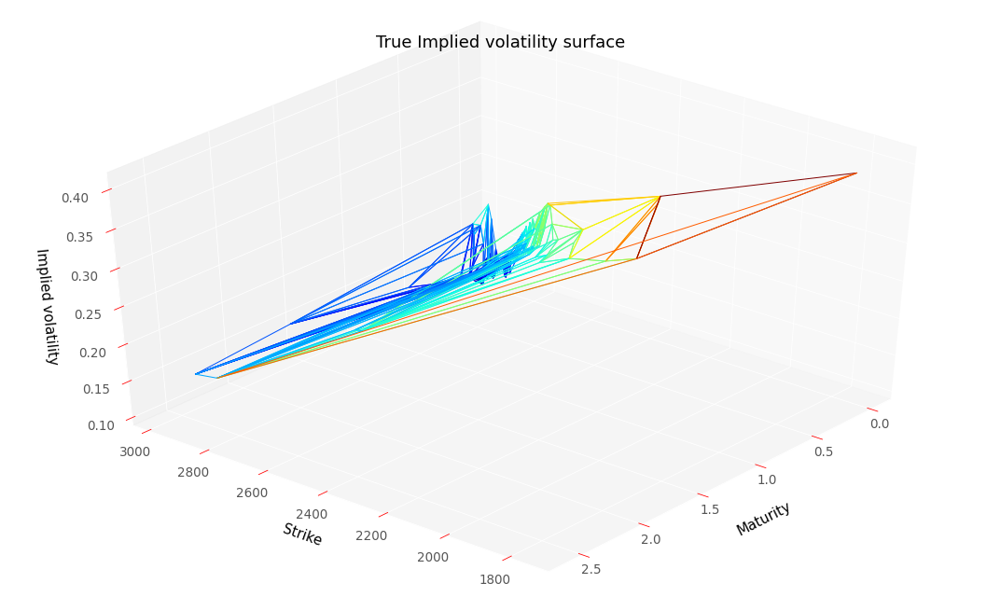

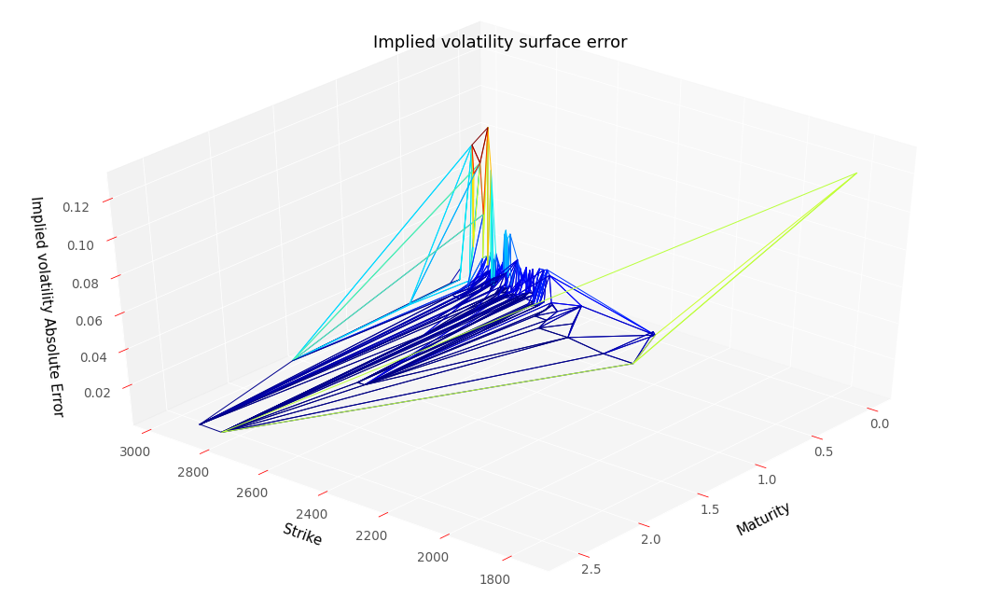

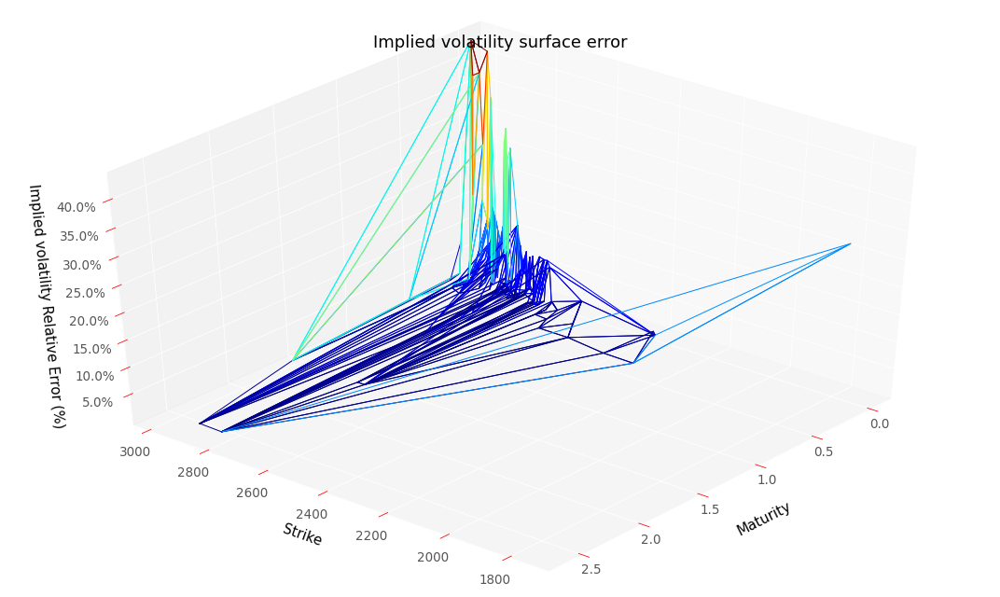

RMSE :  0.01970936139837763
RMSE Relative:  0.1062478645941569


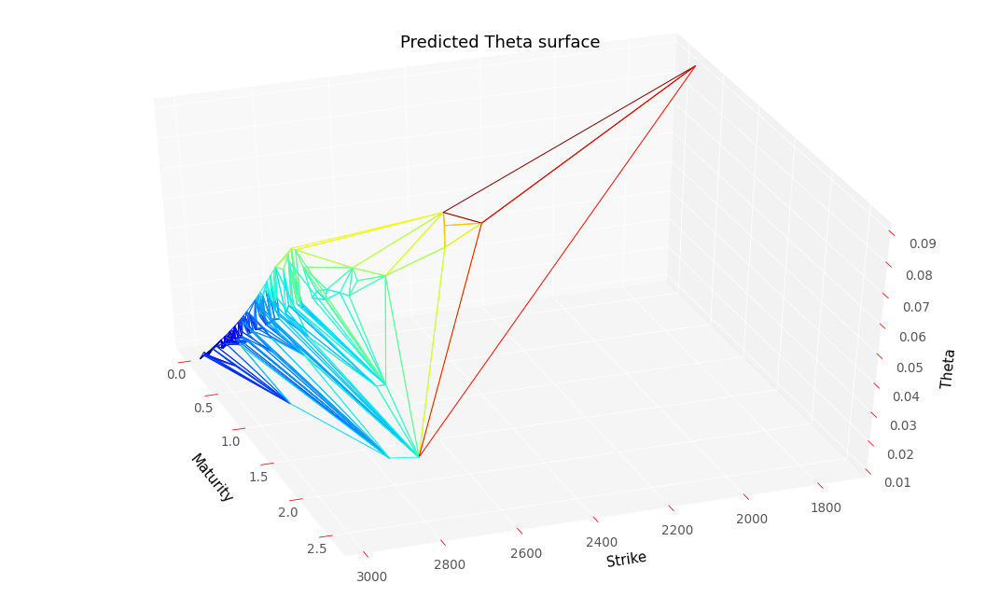

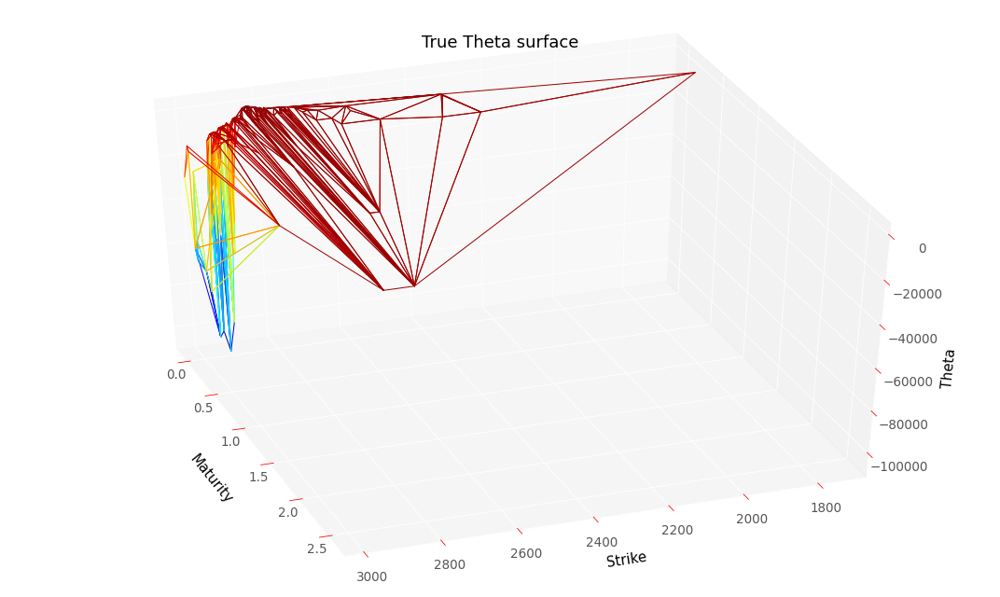

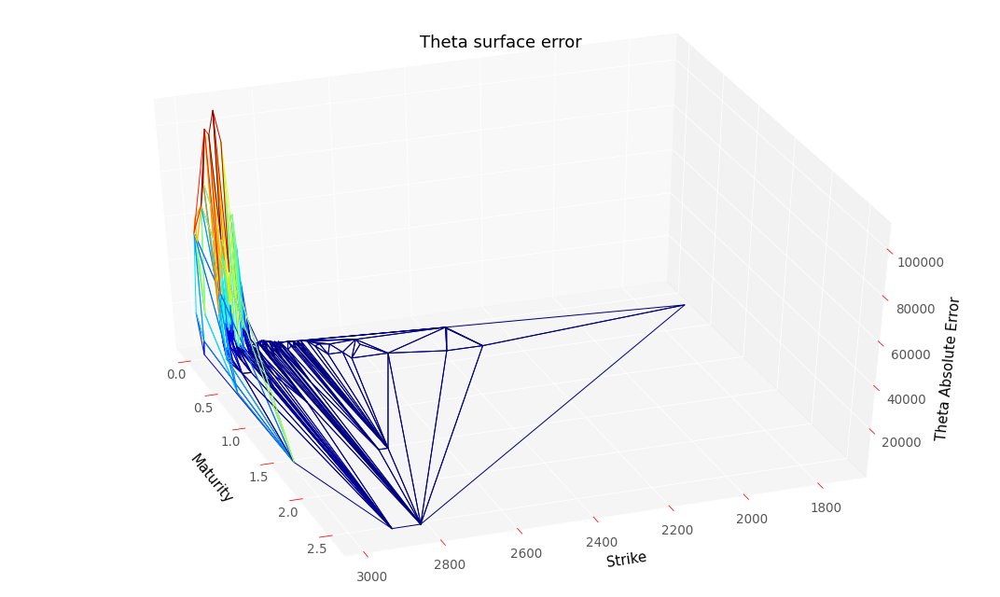

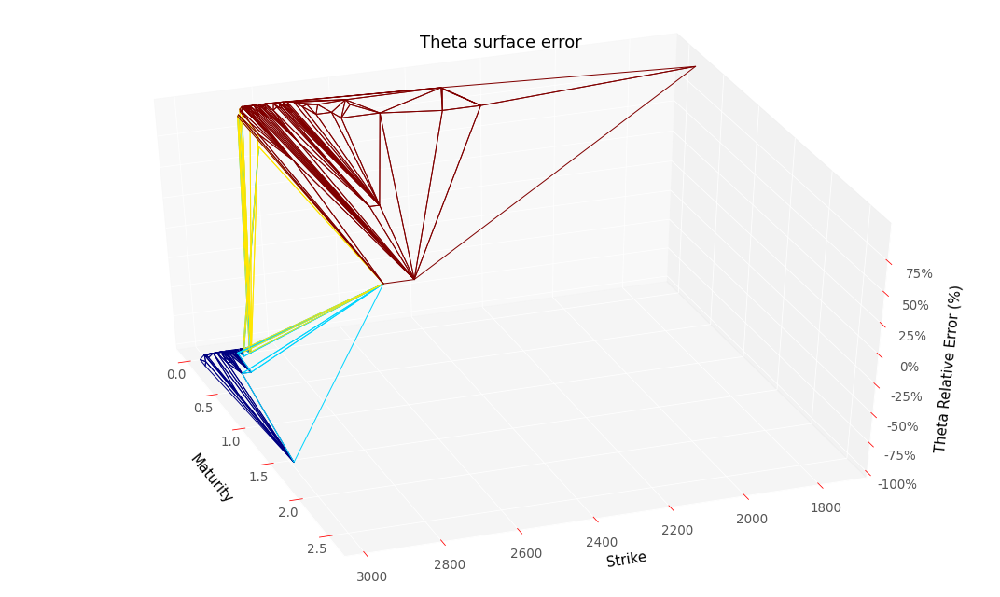

RMSE :  25030.37040220539
RMSE Relative:  0.999944742927822


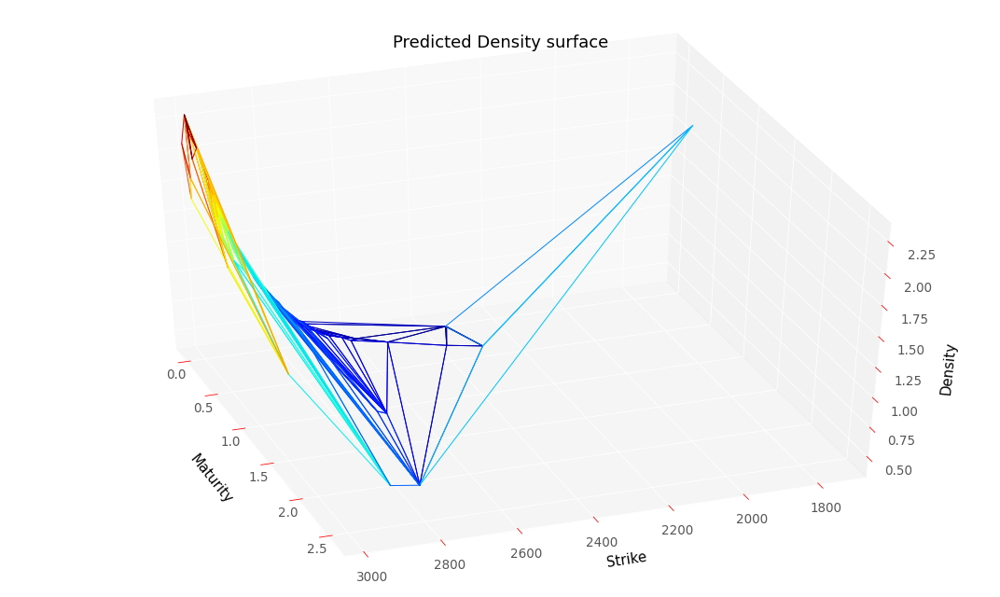

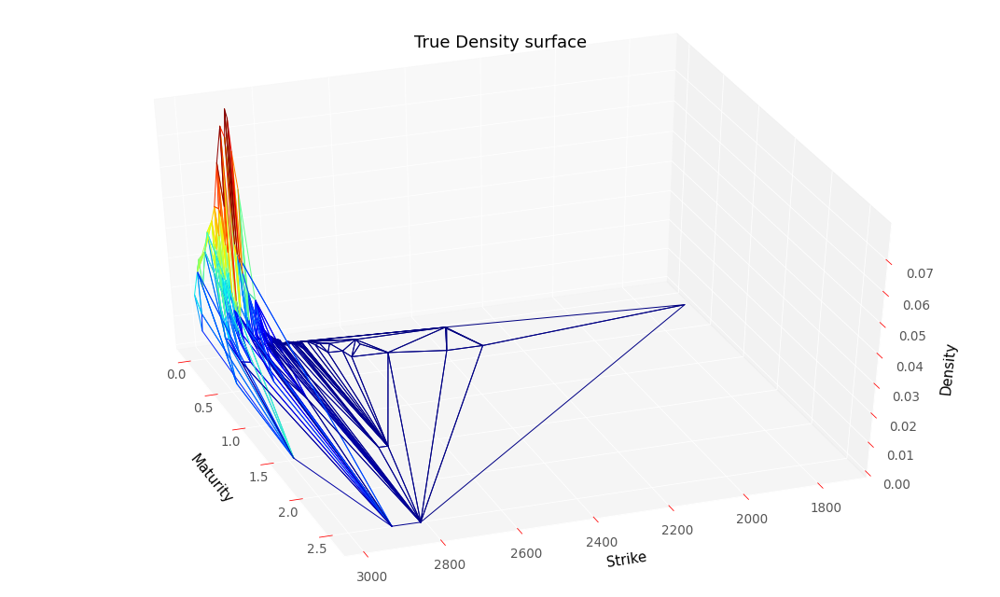

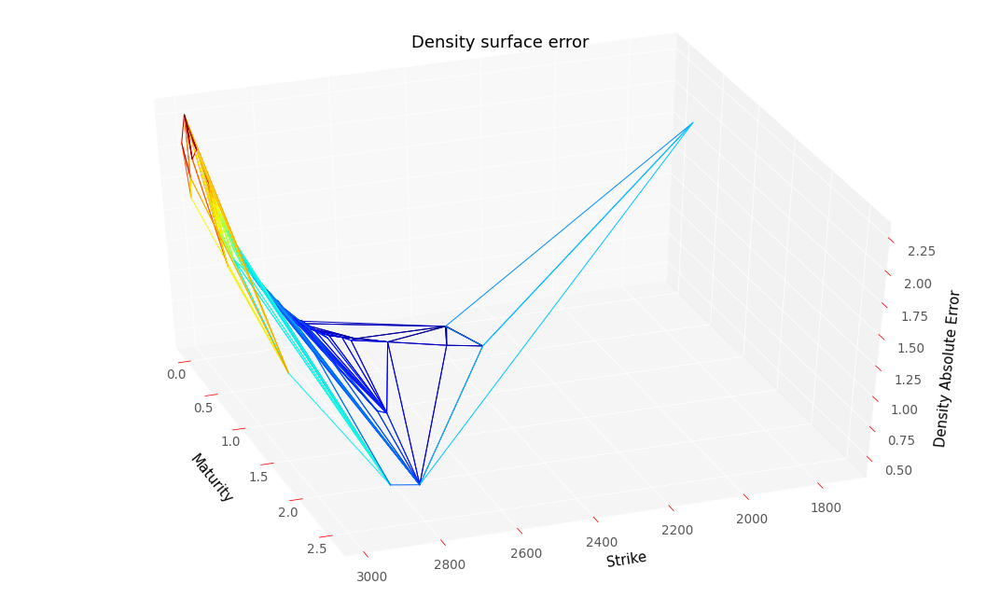

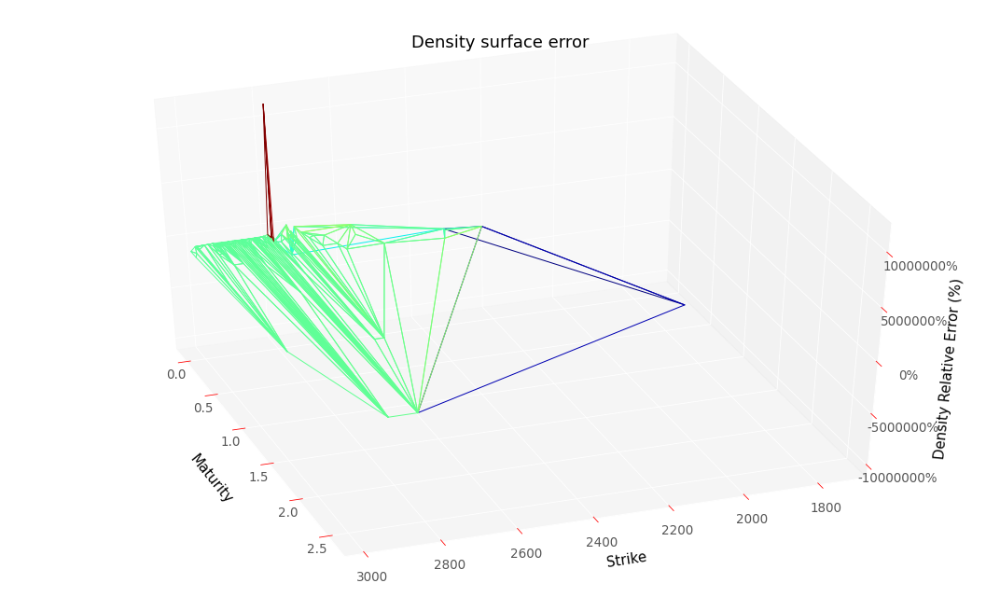

RMSE :  1.1704252110966398
RMSE Relative:  13748.909463740392


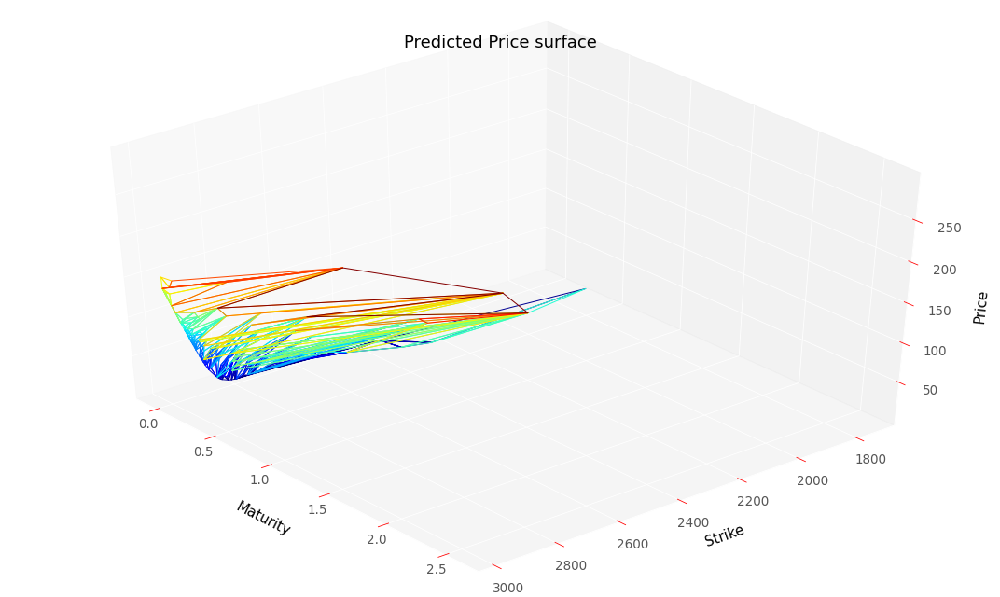

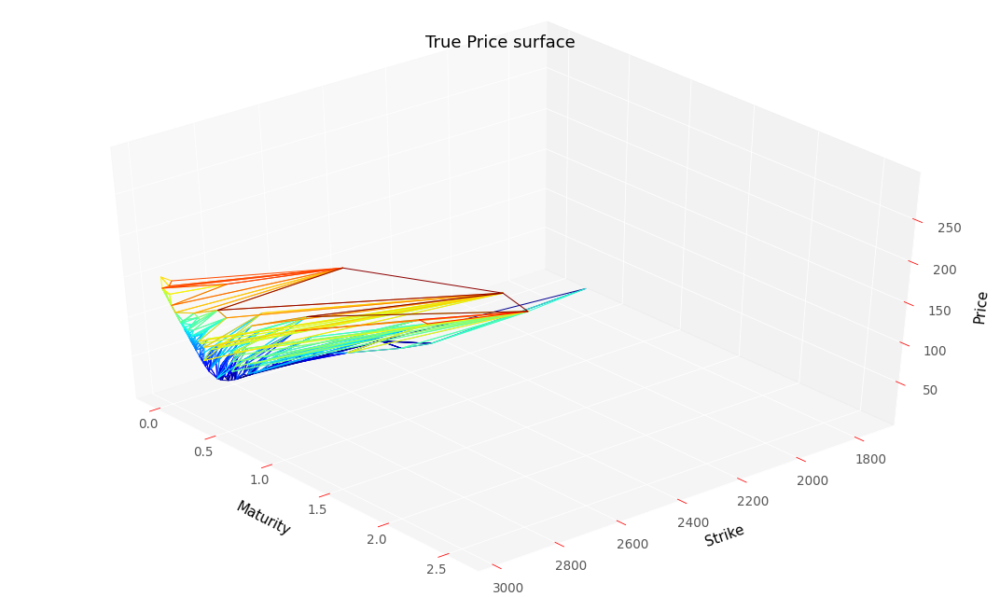

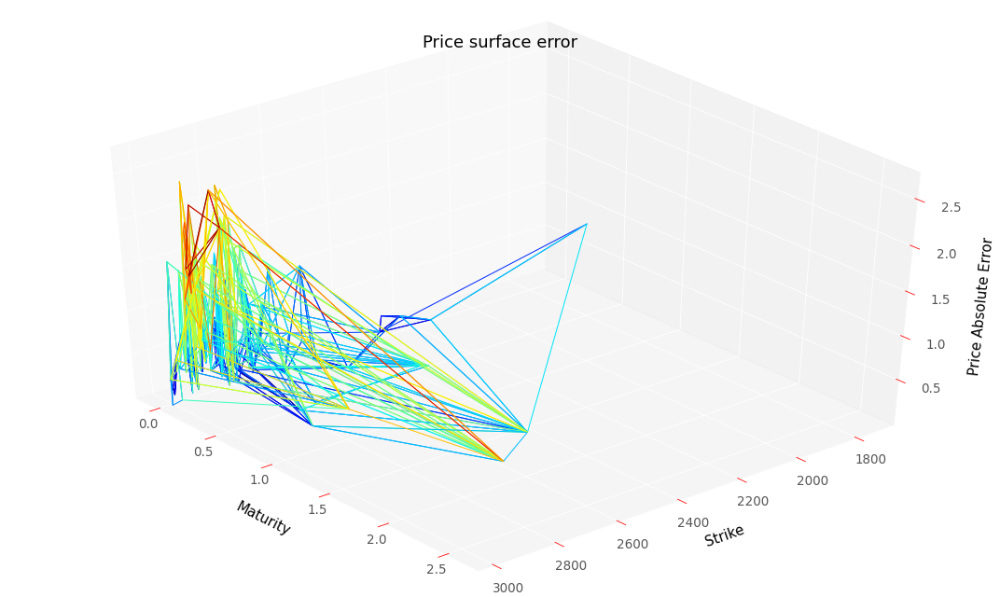

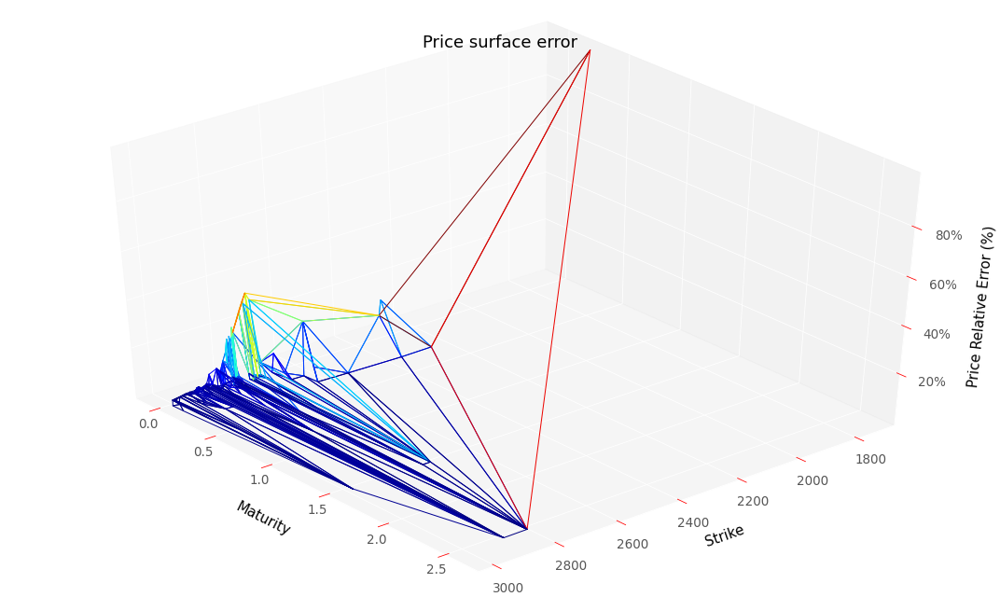

RMSE :  0.9938125604672557
RMSE Relative:  0.11791430294769831


In [ ]:
# Evaluate results on the testing dataset, you can execute that cell without training the model
res = neuralNetwork.create_eval_model_gatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               scaledDataSetTest,
                                               True,
                                               hyperparameters,
                                               scaler,
                                               modelName = "convexSoftGatheralVolModel")
y_pred4TestG, volLocale4TestG, dNN_T4TestG, gNN_K4TestG, lossSerie4TestG = res

plotTools.modelSummaryGatheral(y_pred4TestG, 
                               volLocale4TestG, 
                               dNN_T4TestG, 
                               gNN_K4TestG, 
                               dataSetTest,
                               yMin = KMin,
                               yMax = KMax,
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               savePath = "NeuralImpliedVolTest")

In [ ]:
importlib.reload(plotTools)

<module 'plotTools' from '/content/plotTools.py'>

Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


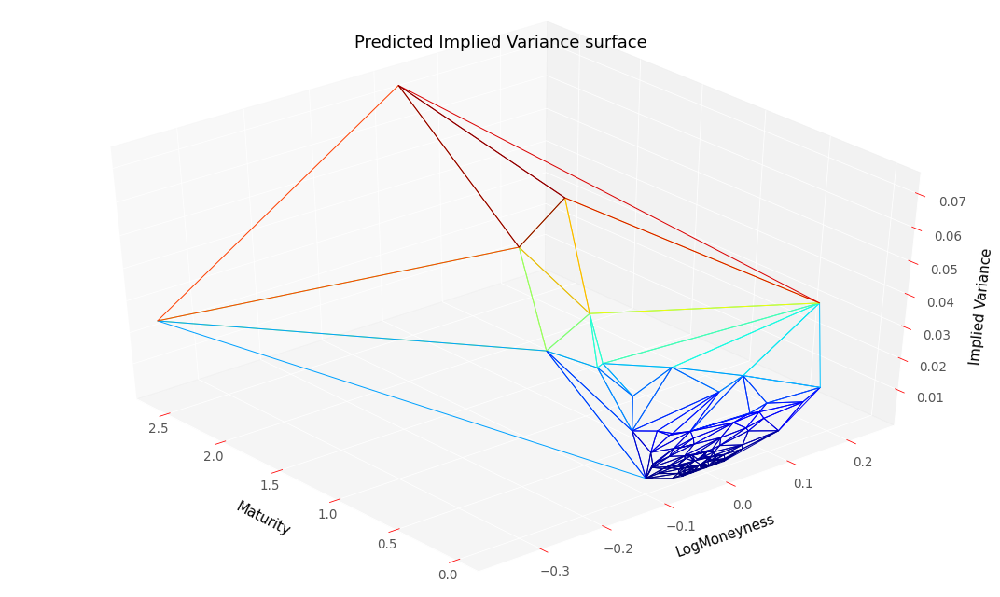

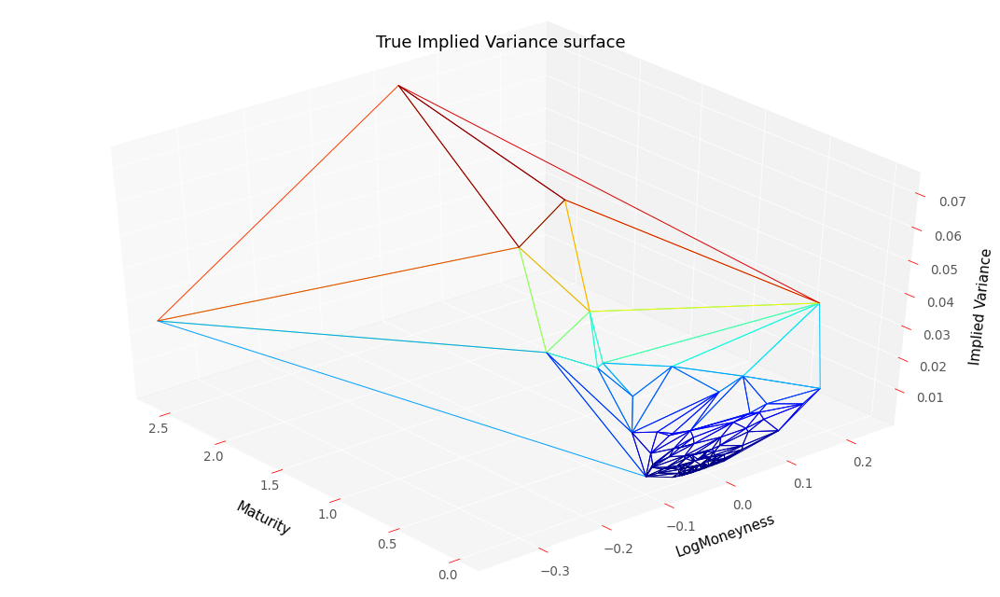

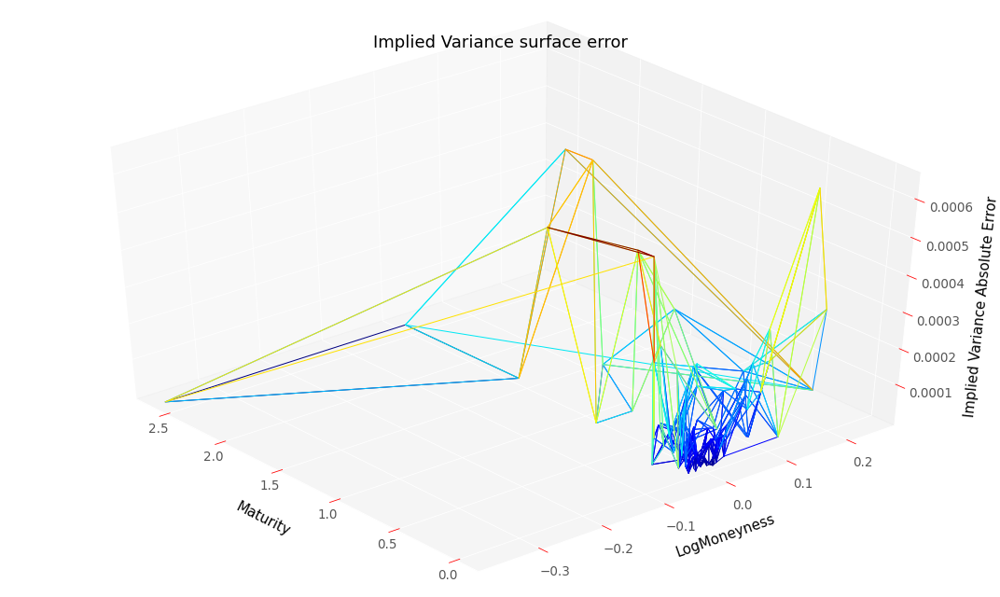

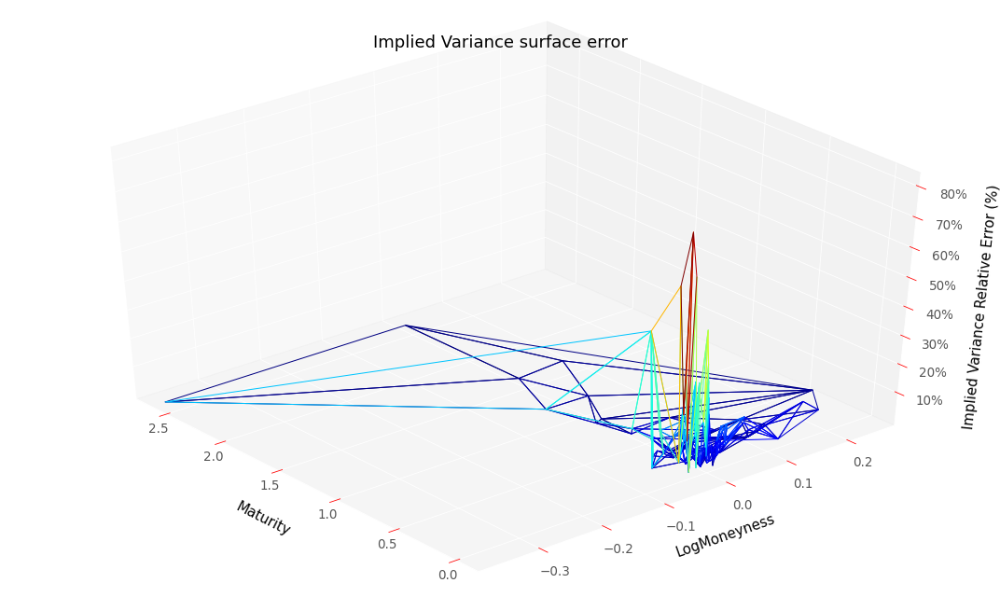

RMSE :  0.0001627929226830871
RMSE Relative:  0.16565803660030504


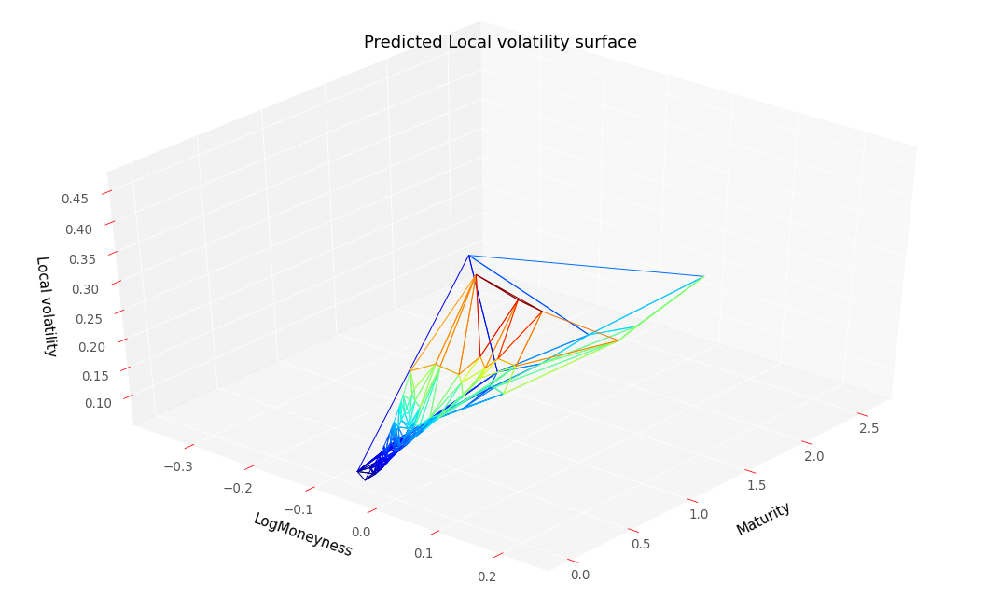

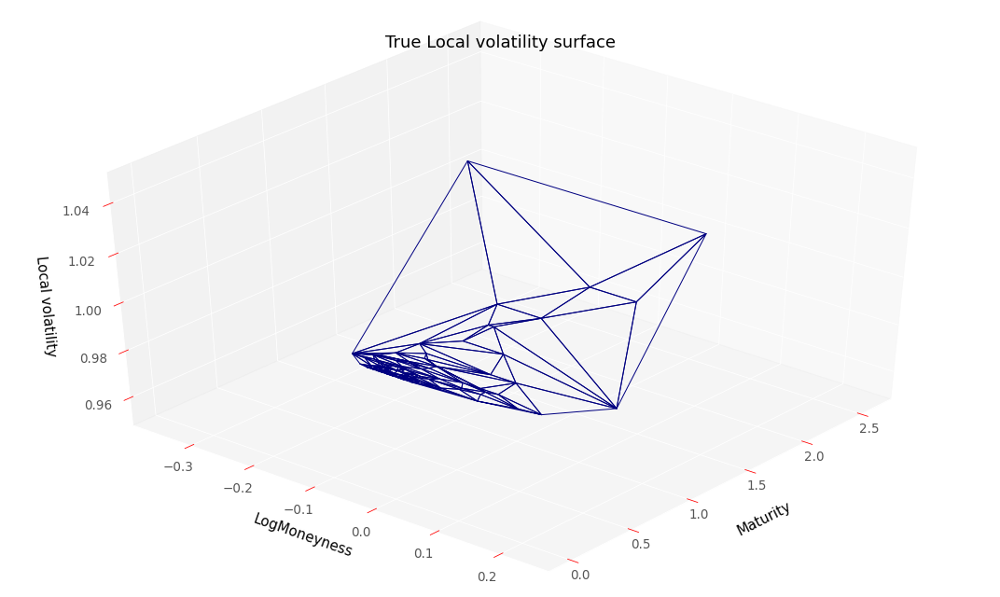

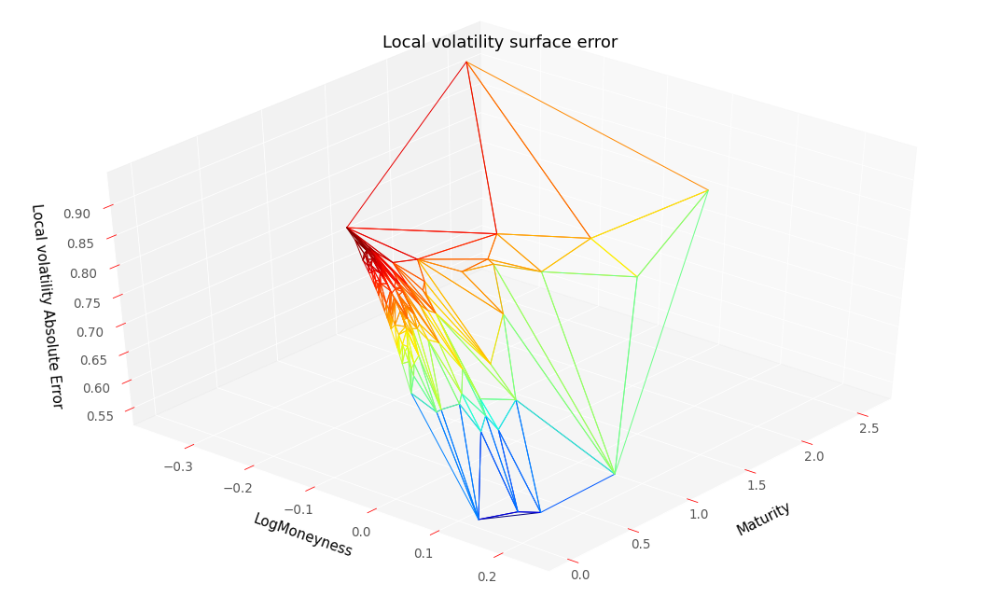

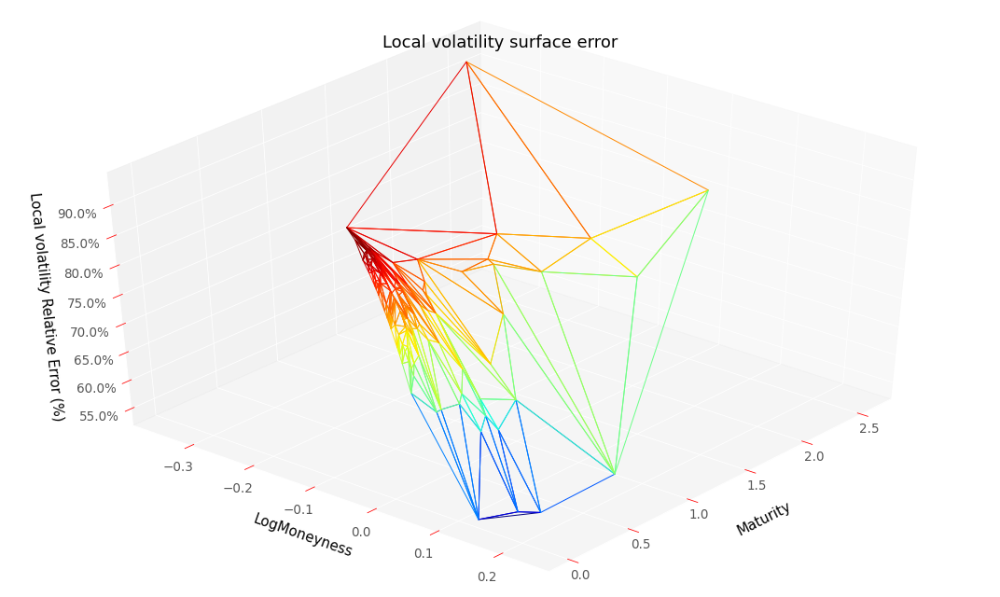

RMSE :  0.8387753082107005
RMSE Relative:  0.8387753082107005


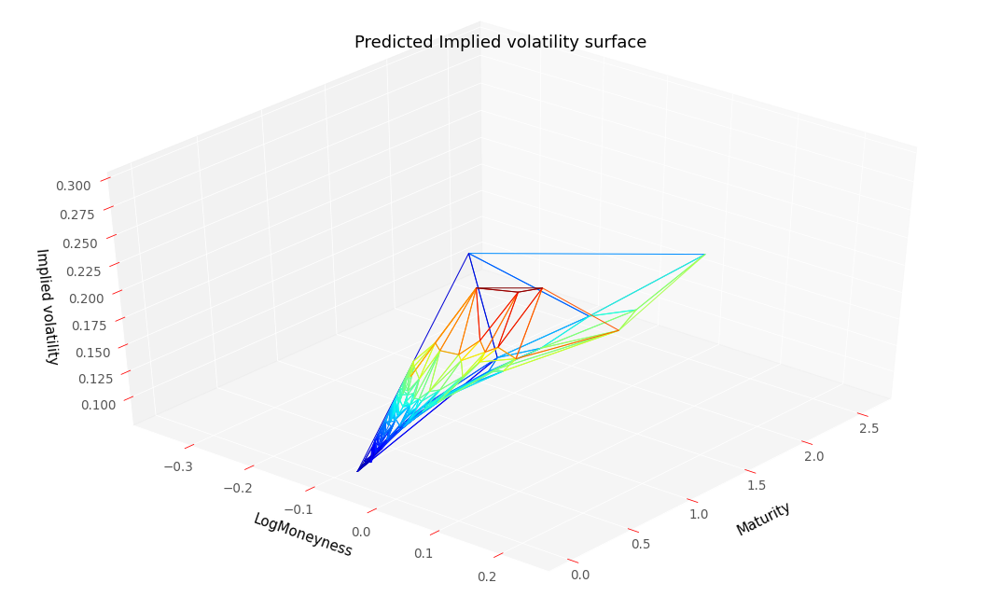

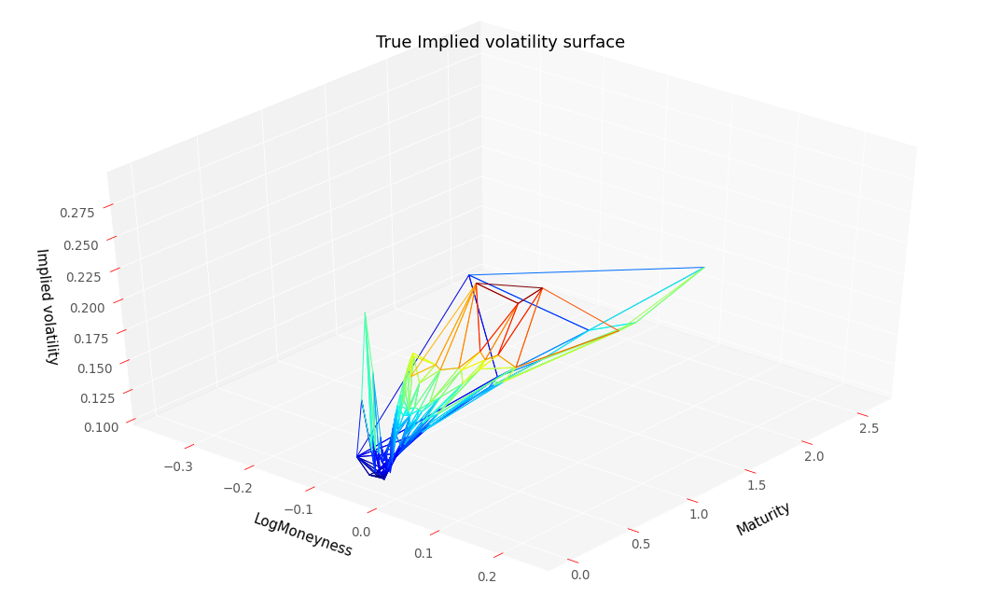

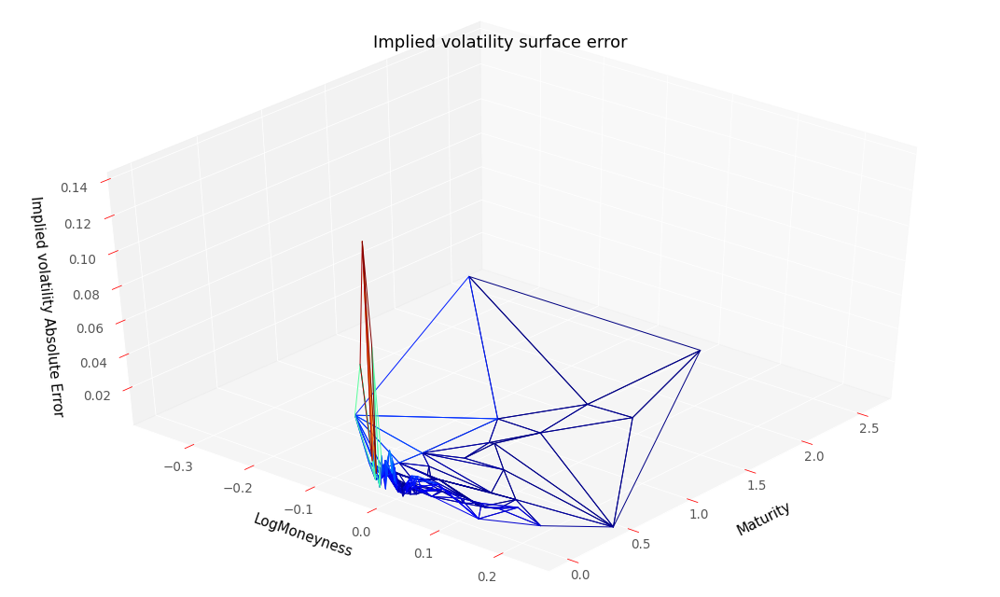

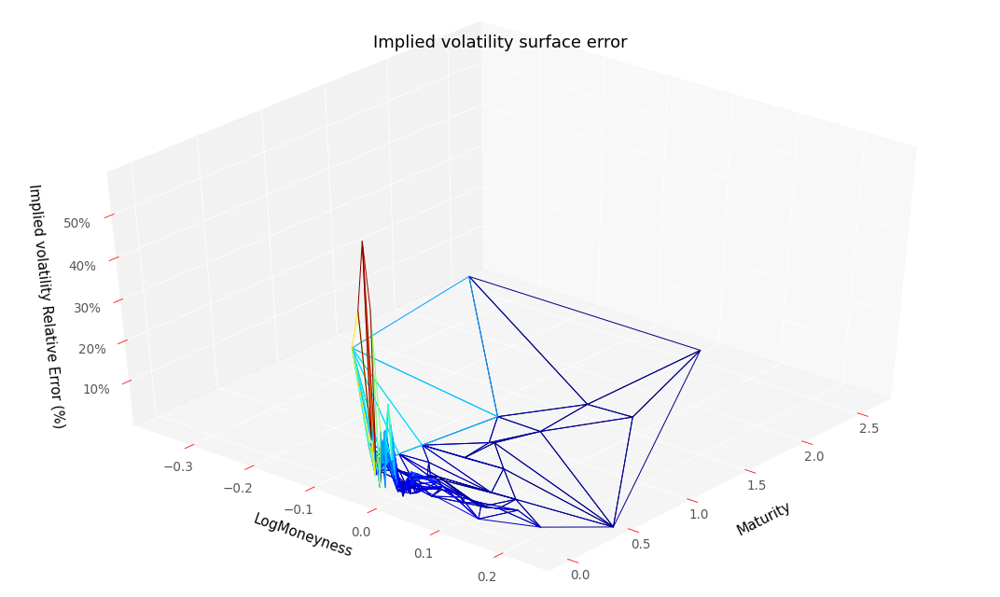

RMSE :  0.01751638694638618
RMSE Relative:  0.09568202156549077


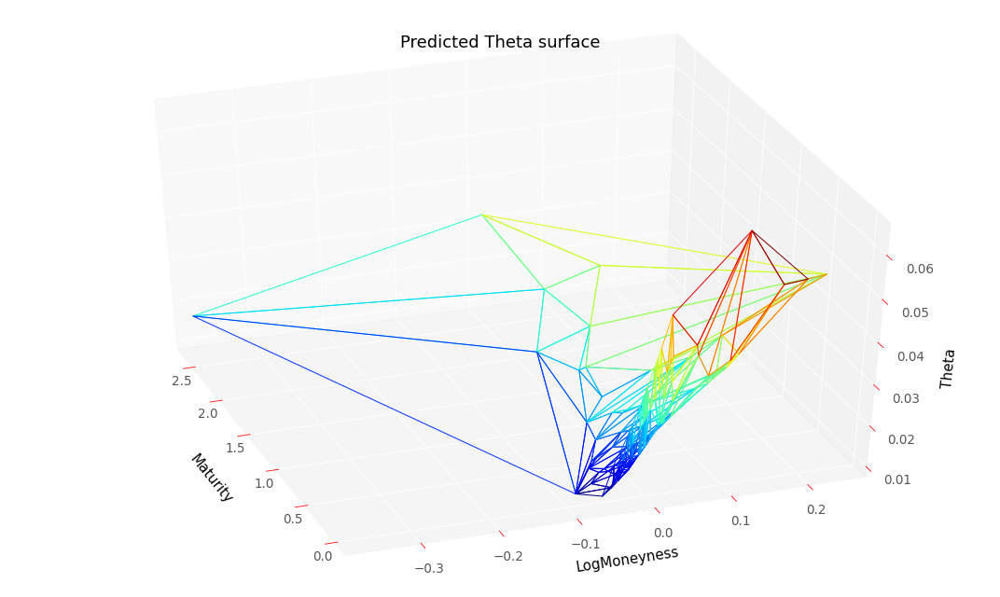

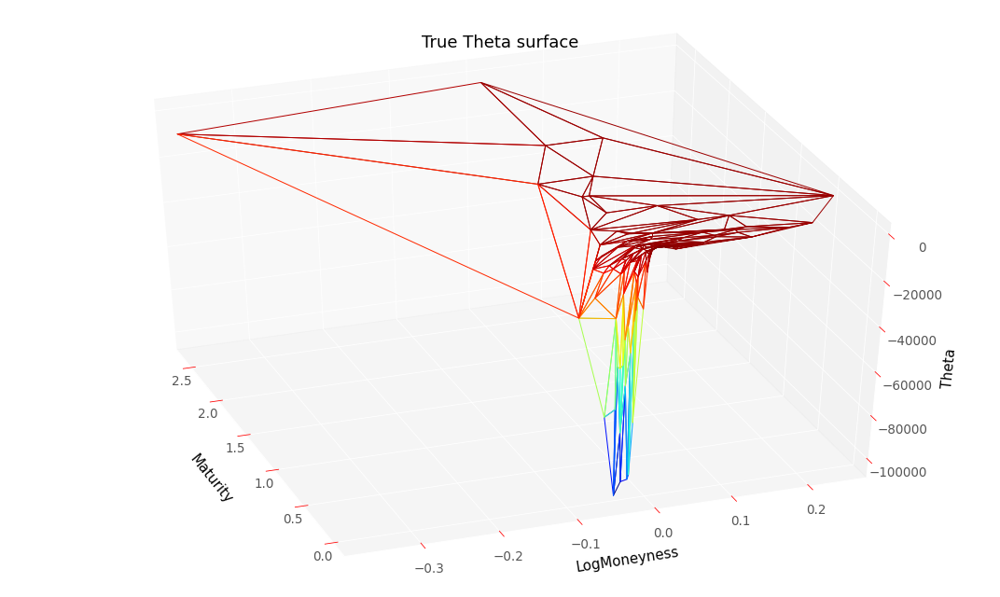

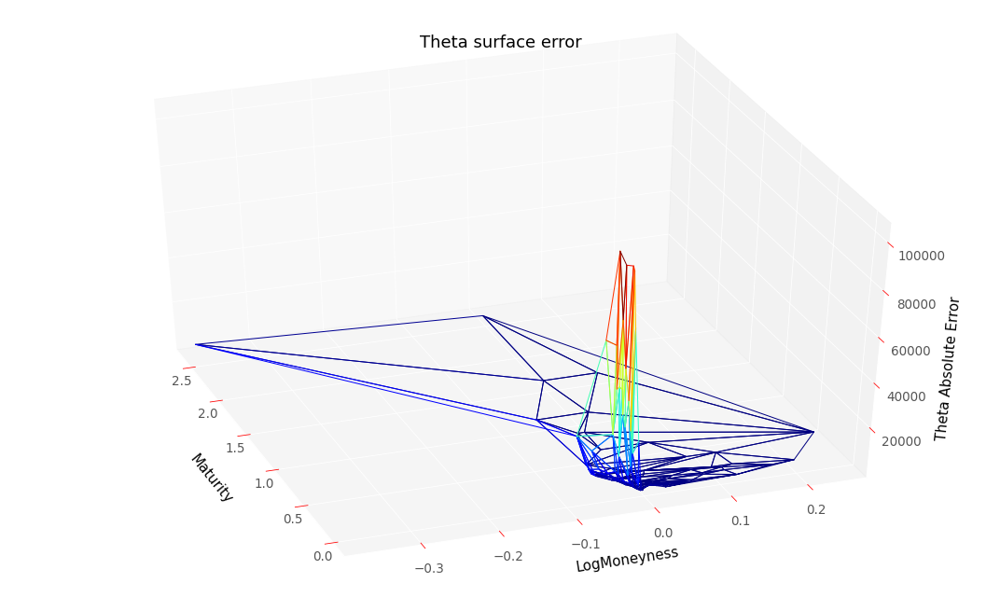

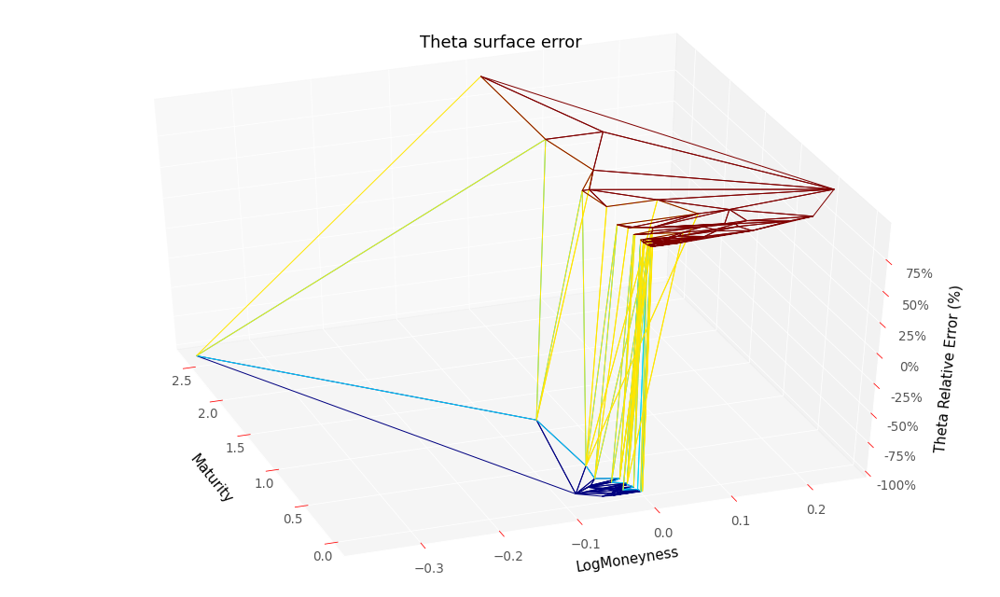

RMSE :  24400.9332567475
RMSE Relative:  0.9999497682238935


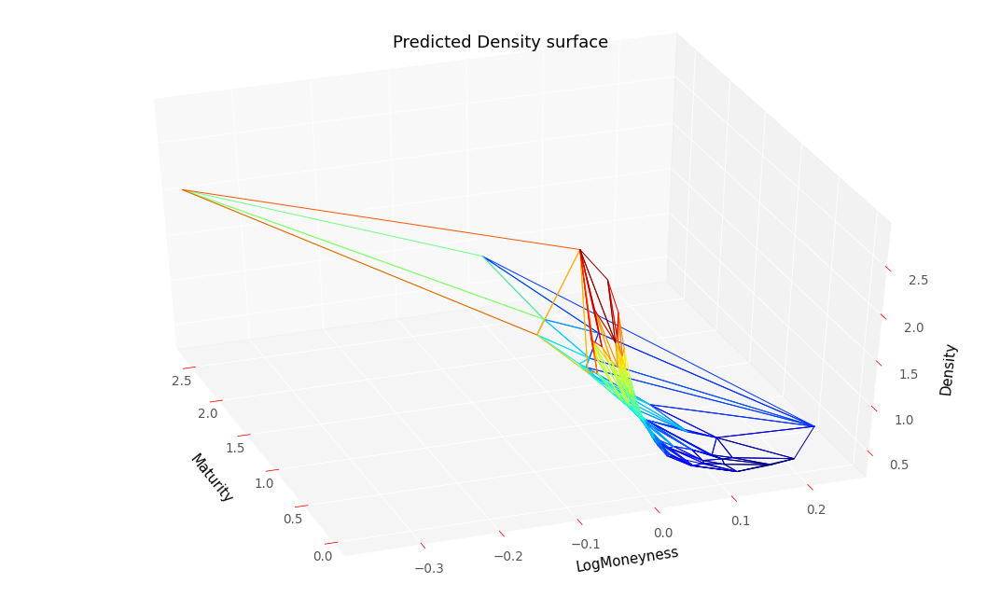

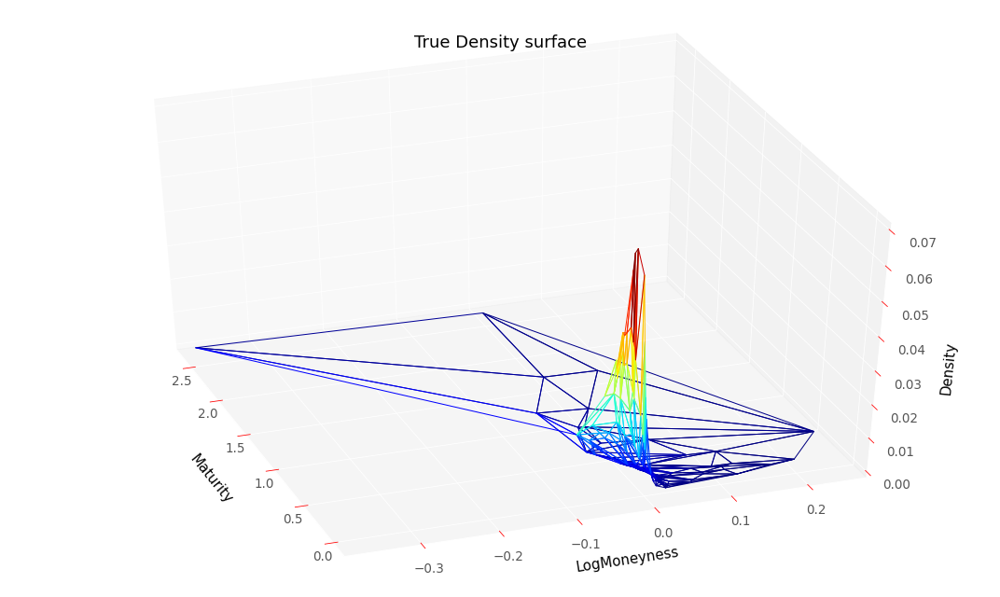

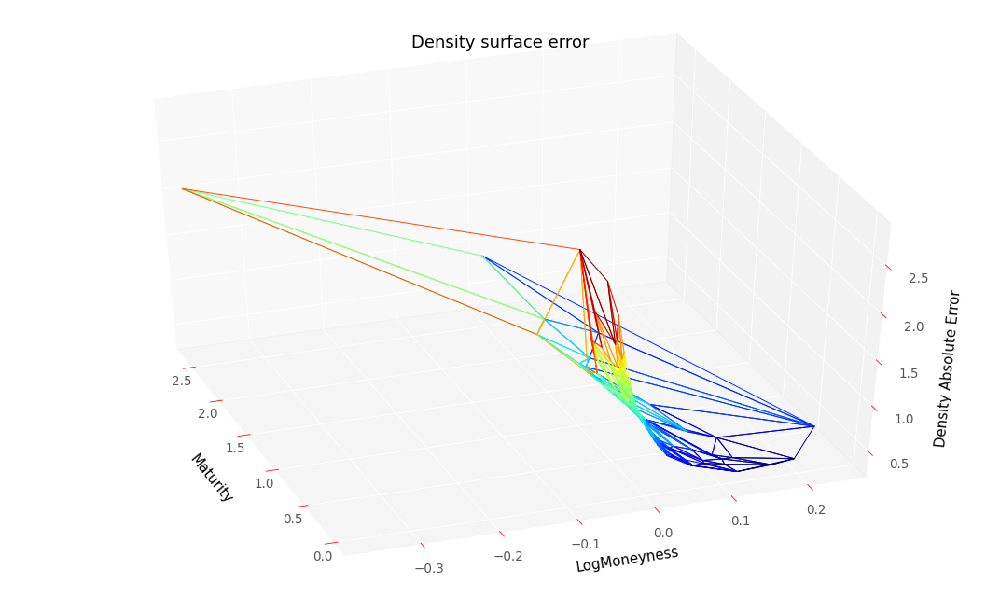

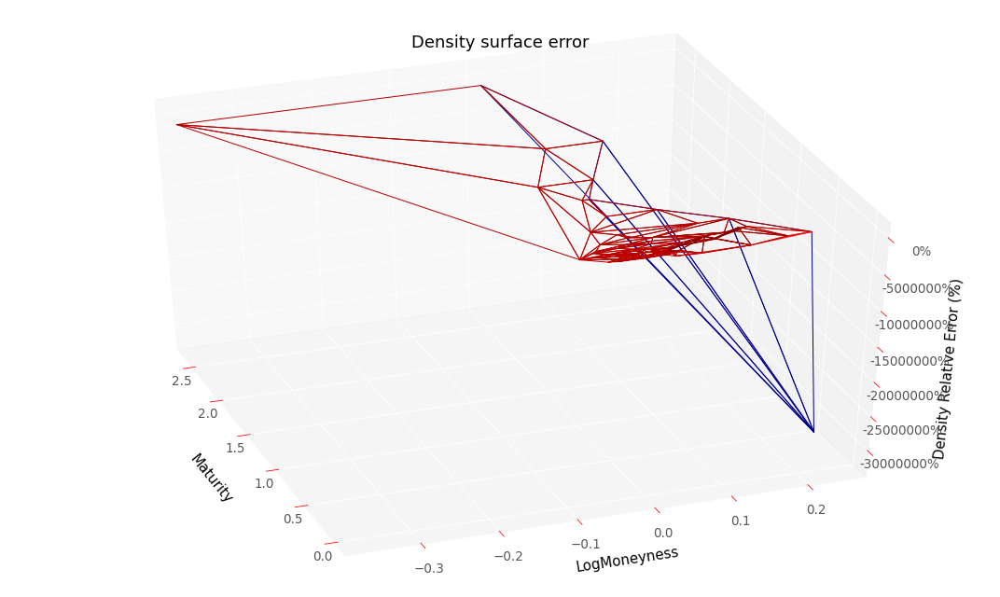

RMSE :  1.188239402421596
RMSE Relative:  28577.514060685186


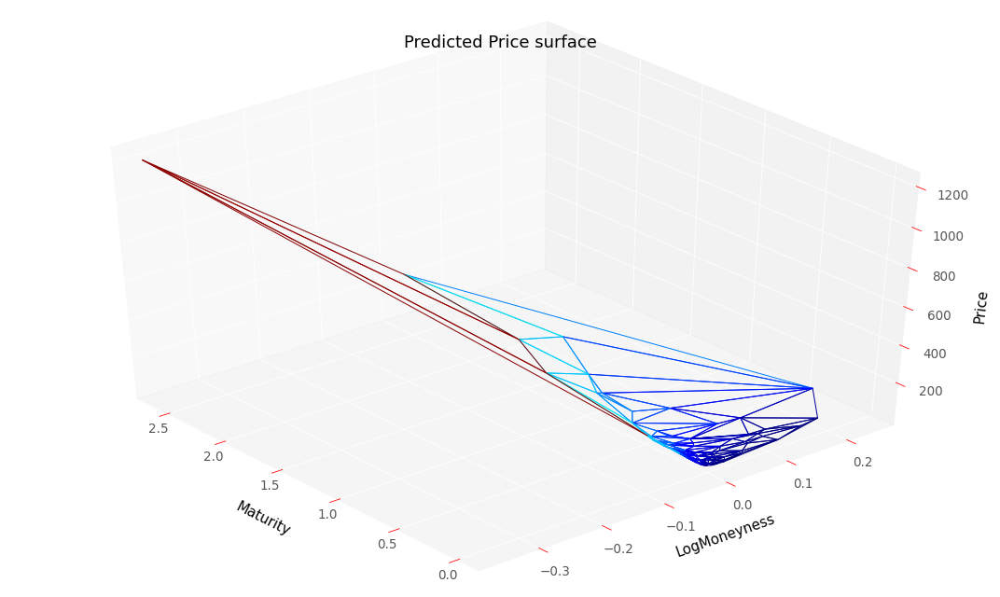

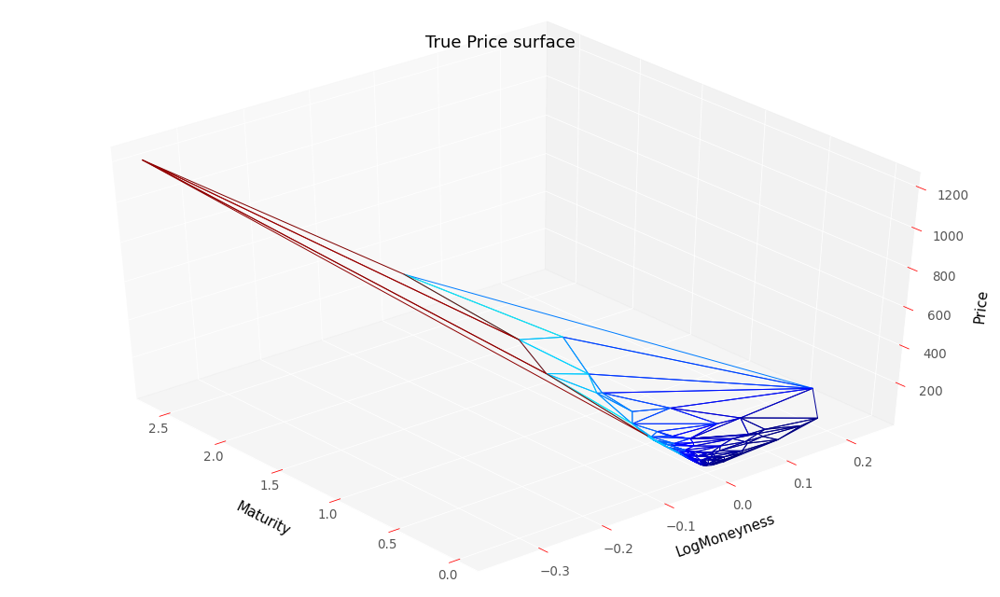

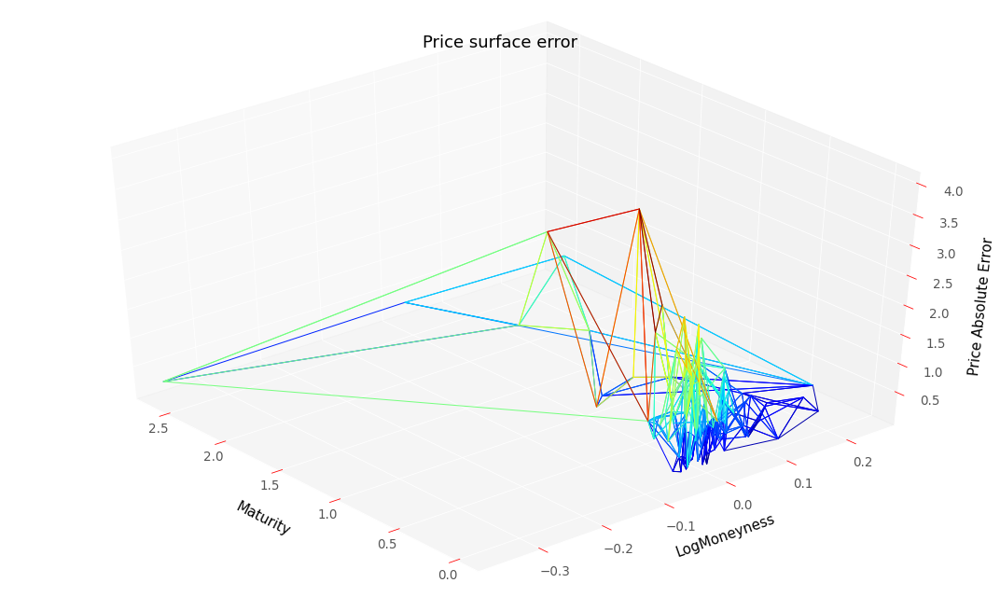

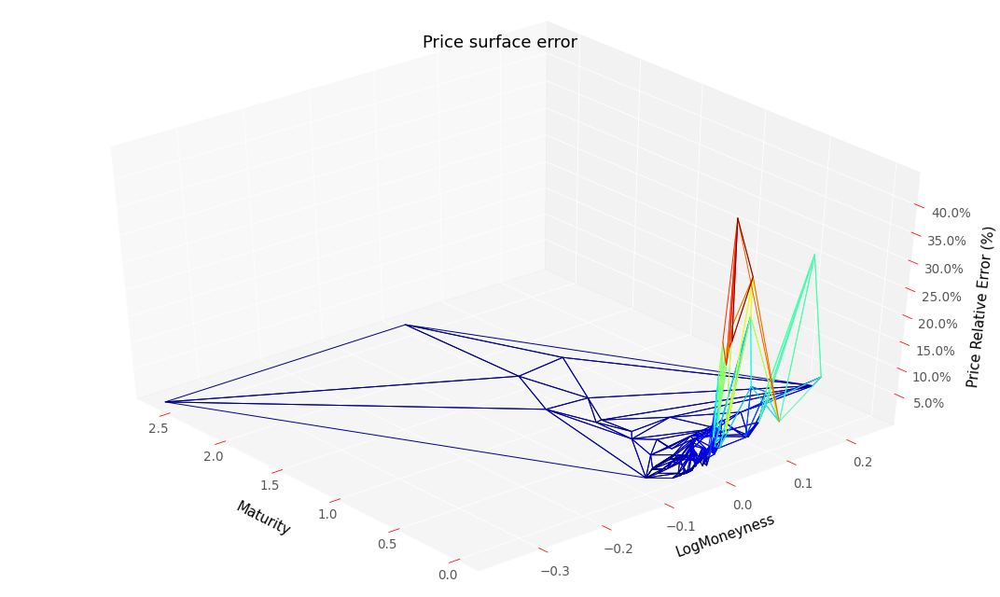

RMSE :  1.0543920236262099
RMSE Relative:  0.08391529126630827


In [ ]:
#Diagnosis for training results
plotTools.modelSummaryGatheral(y_pred4G, 
                               volLocale4G, 
                               dNN_T4G, 
                               gNN_K4G, 
                               dataSet,
                               logMoneynessScale = True,
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               yMin = KMin + 0.0001,
                               yMax = KMax)

Number of static arbitrage violations :  0
Arbitrable total variance :  Series([], Name: Price, dtype: float32)


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


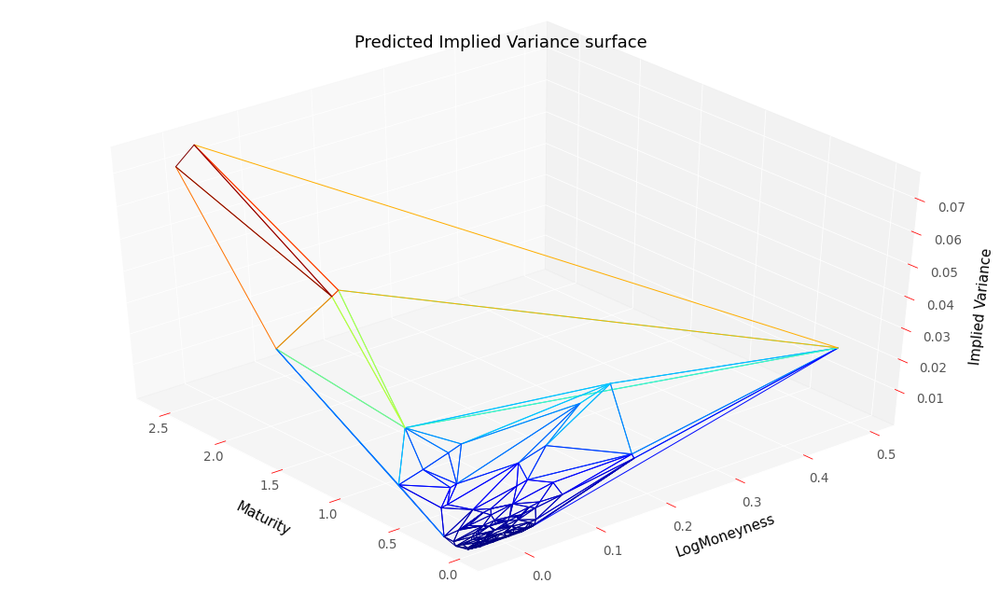

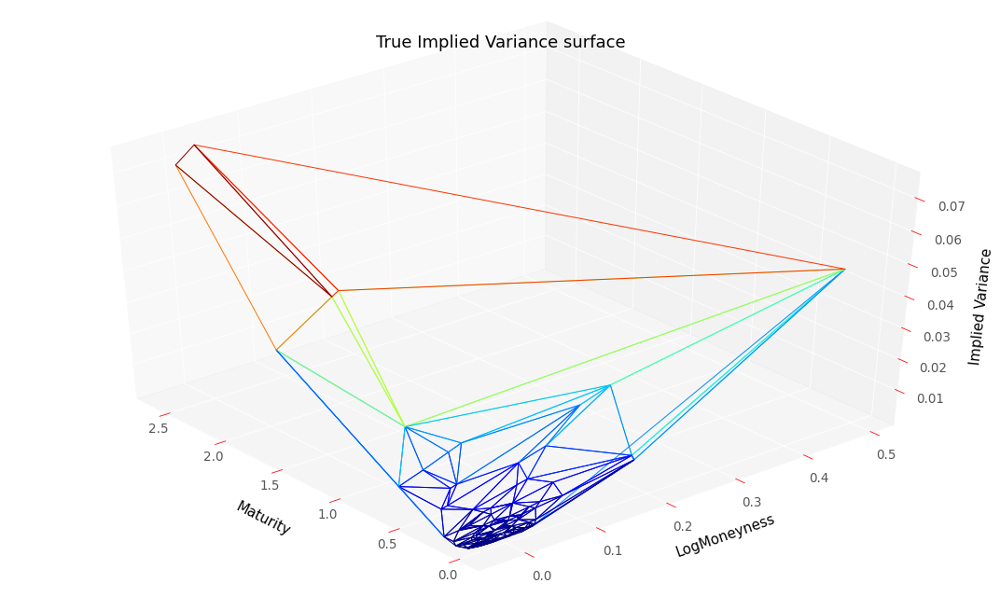

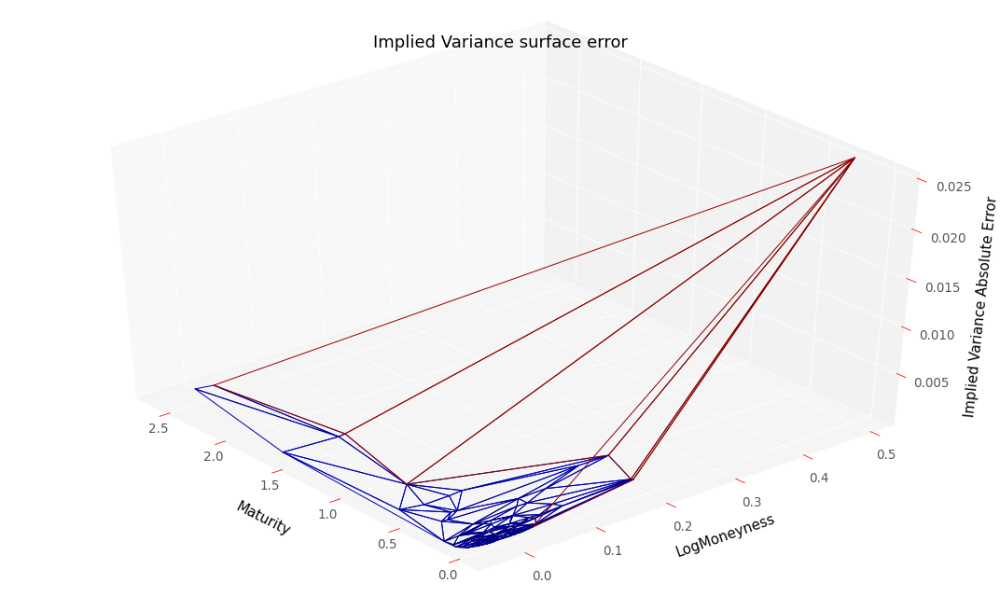

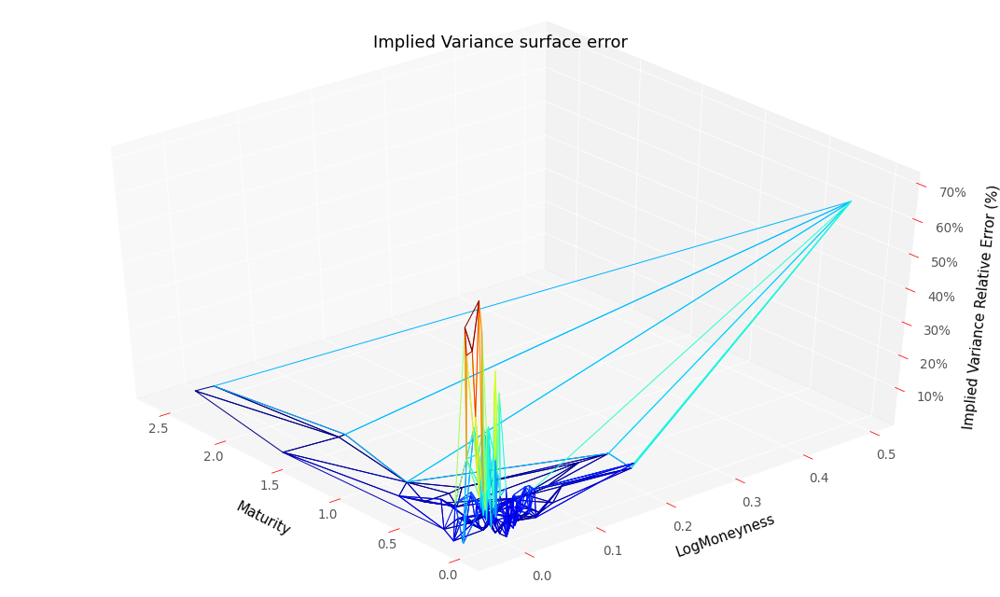

RMSE :  0.0021004247138559006
RMSE Relative:  0.18678100528850272


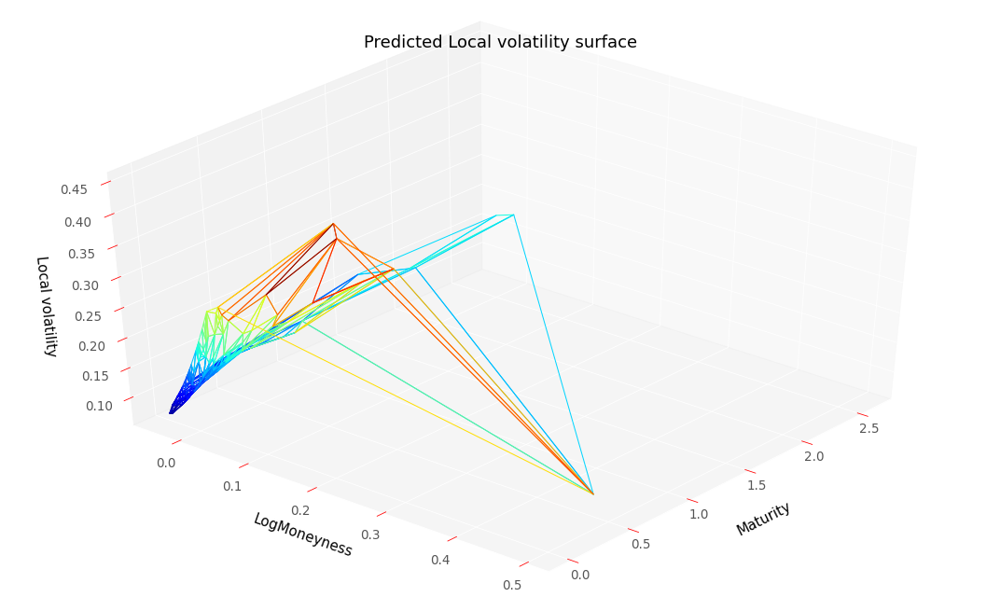

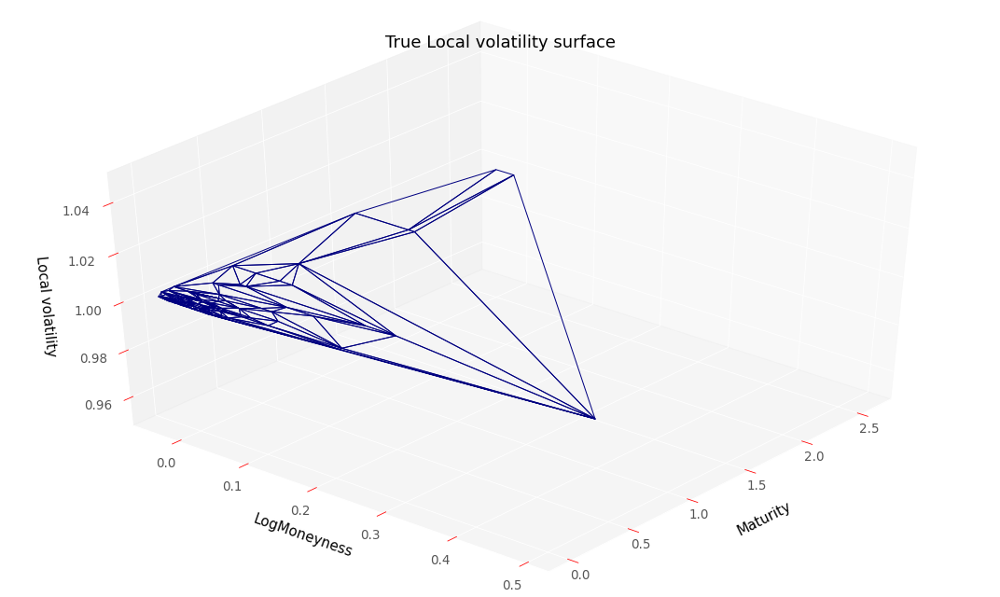

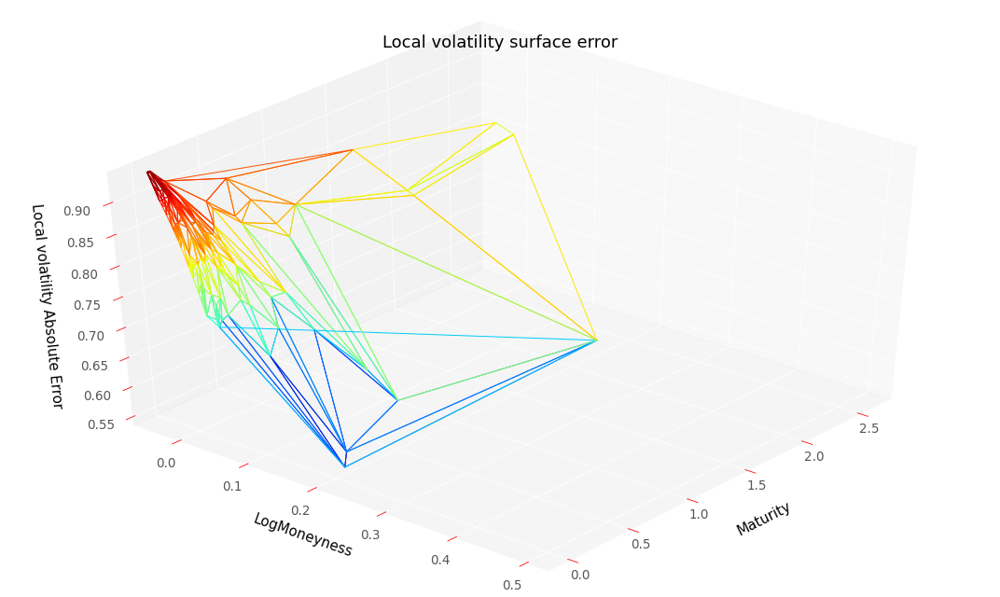

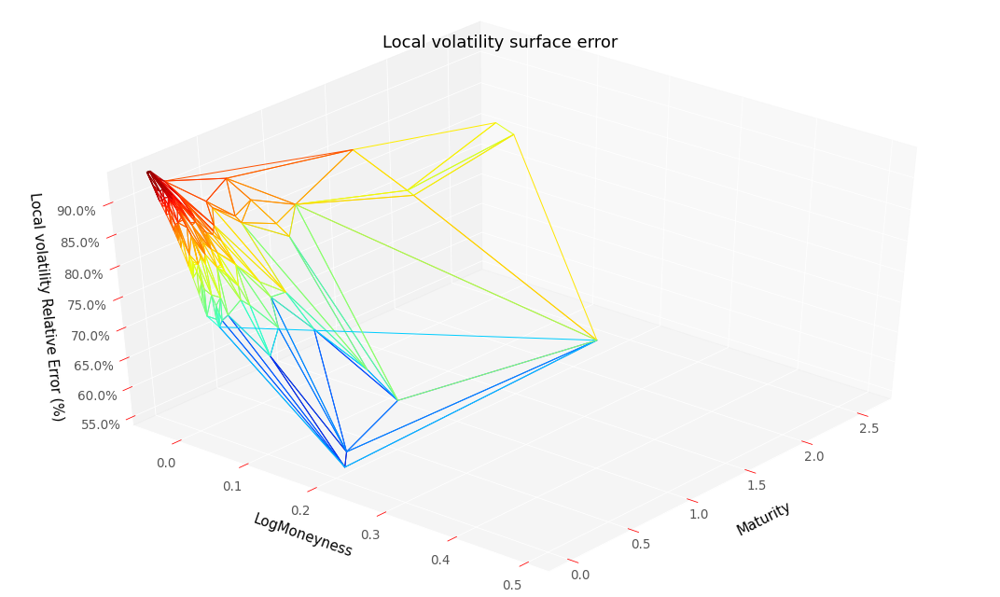

RMSE :  0.8425819295913557
RMSE Relative:  0.8425819295913557


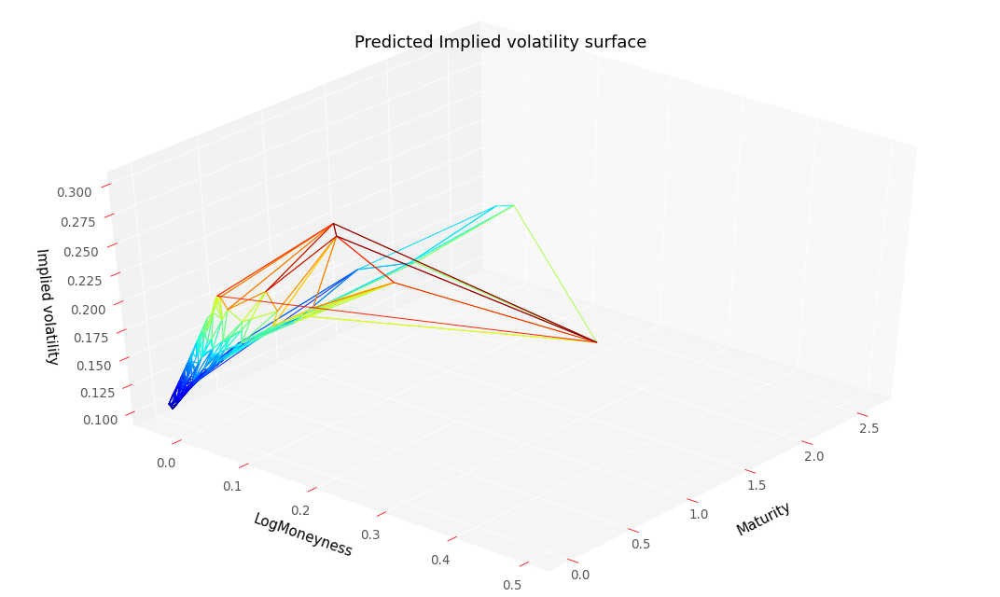

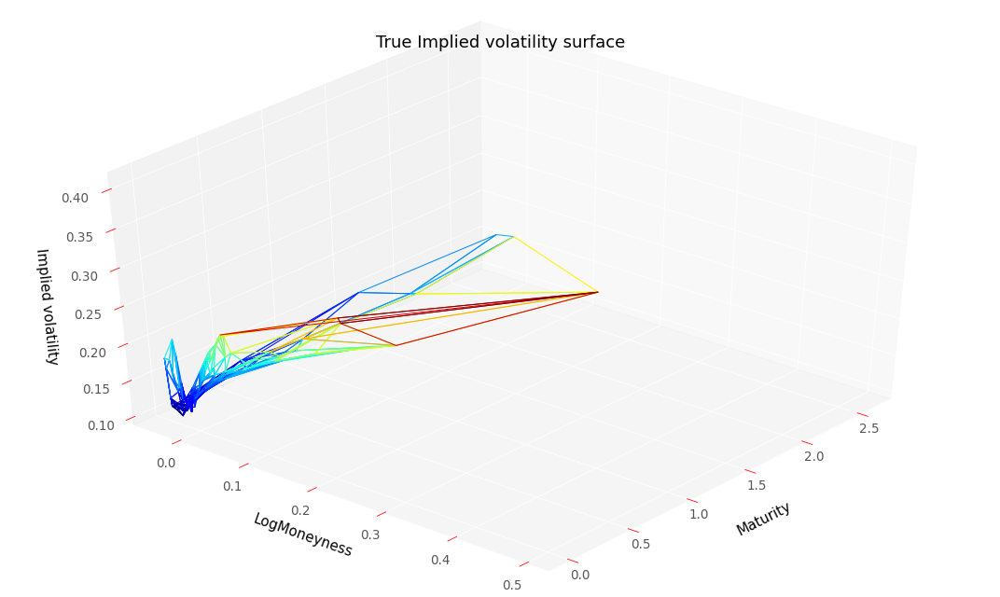

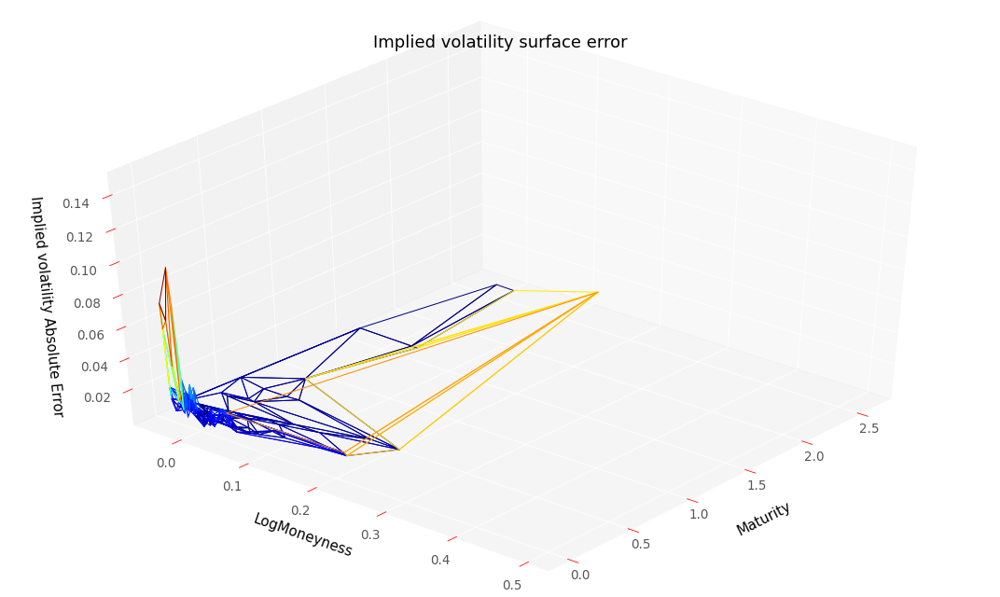

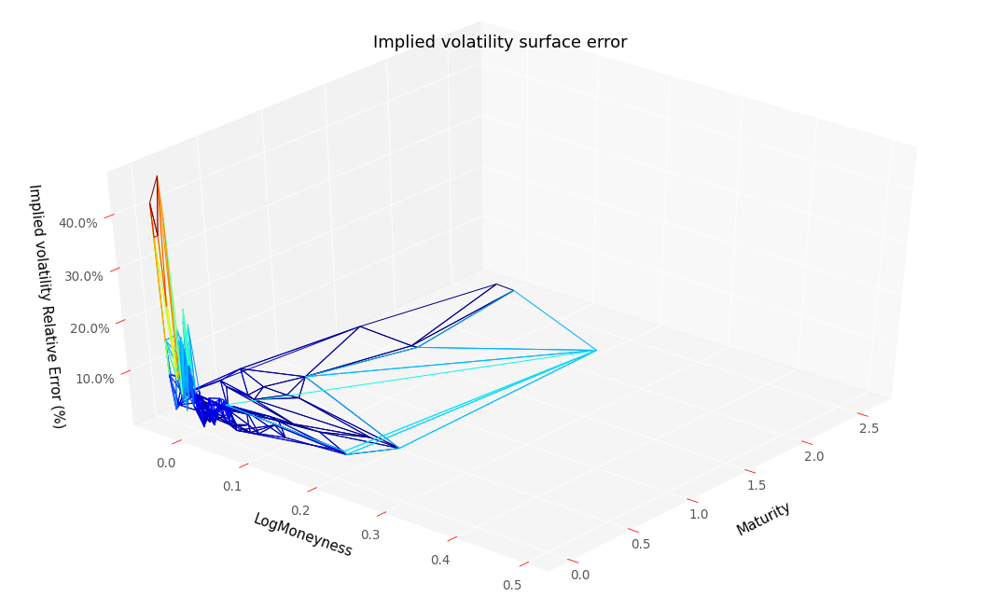

RMSE :  0.020389762772756045
RMSE Relative:  0.10341576227034742


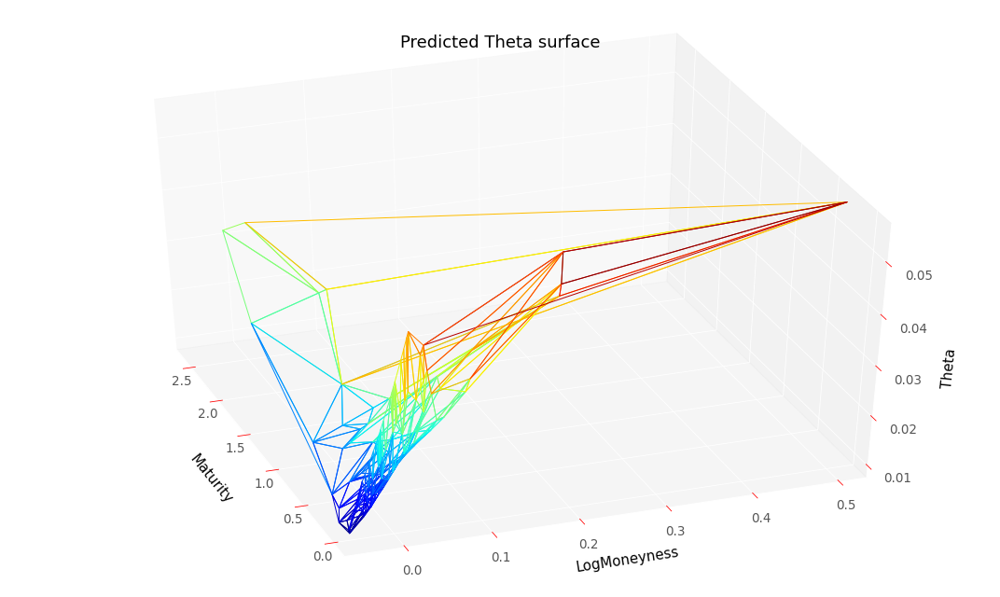

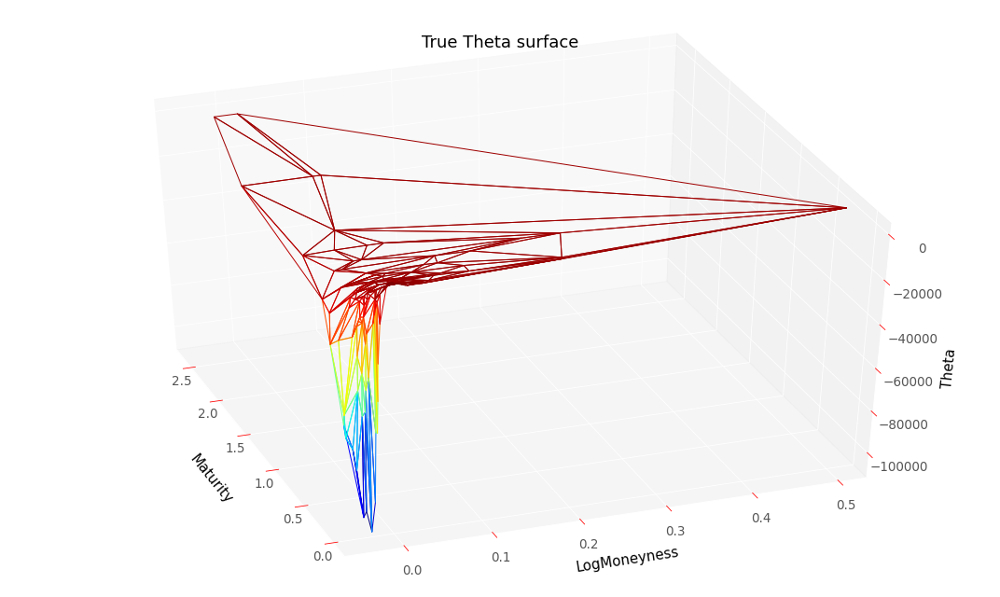

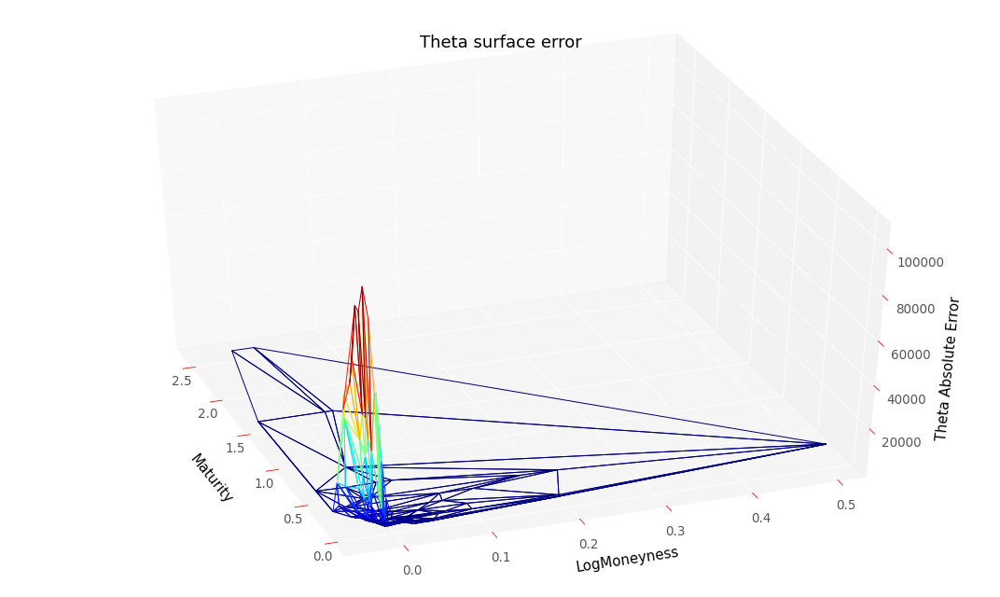

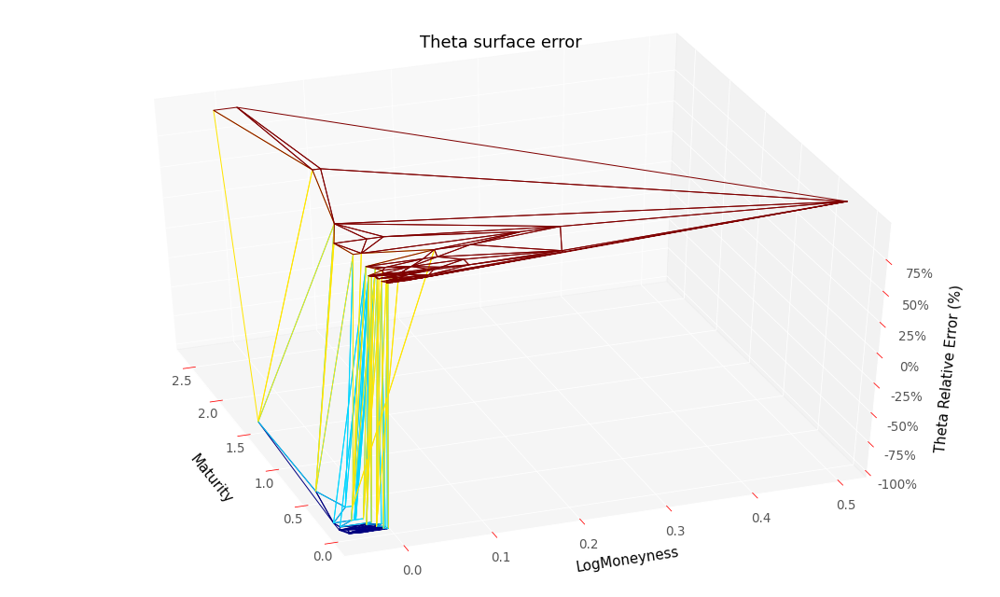

RMSE :  25030.37175530274
RMSE Relative:  0.9999582477347498


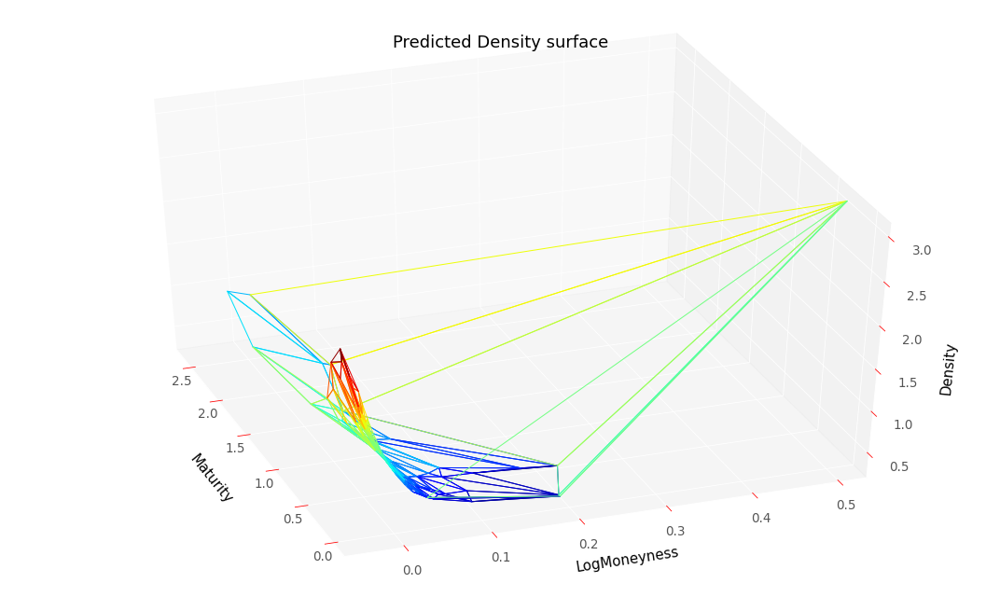

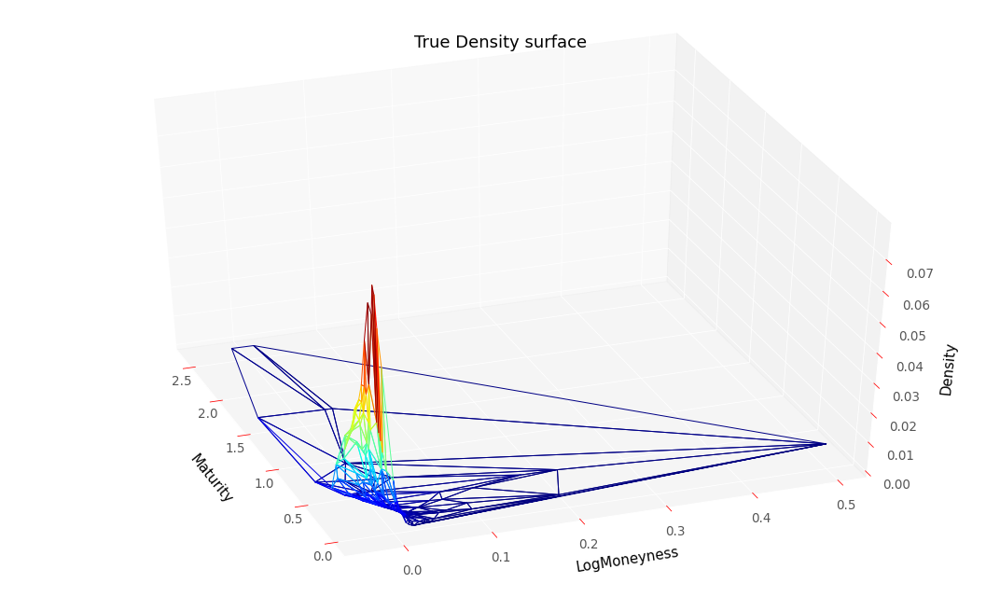

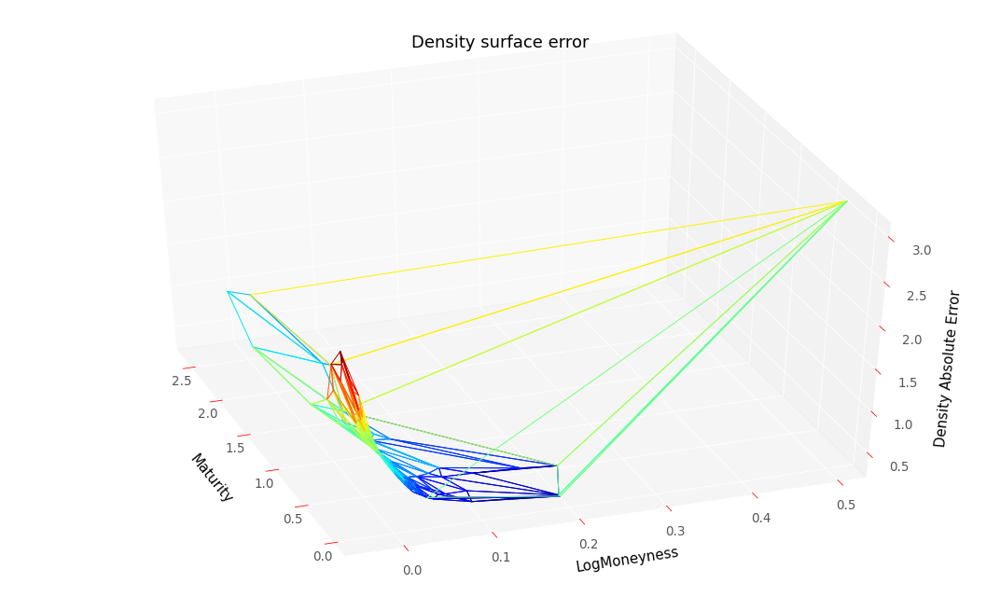

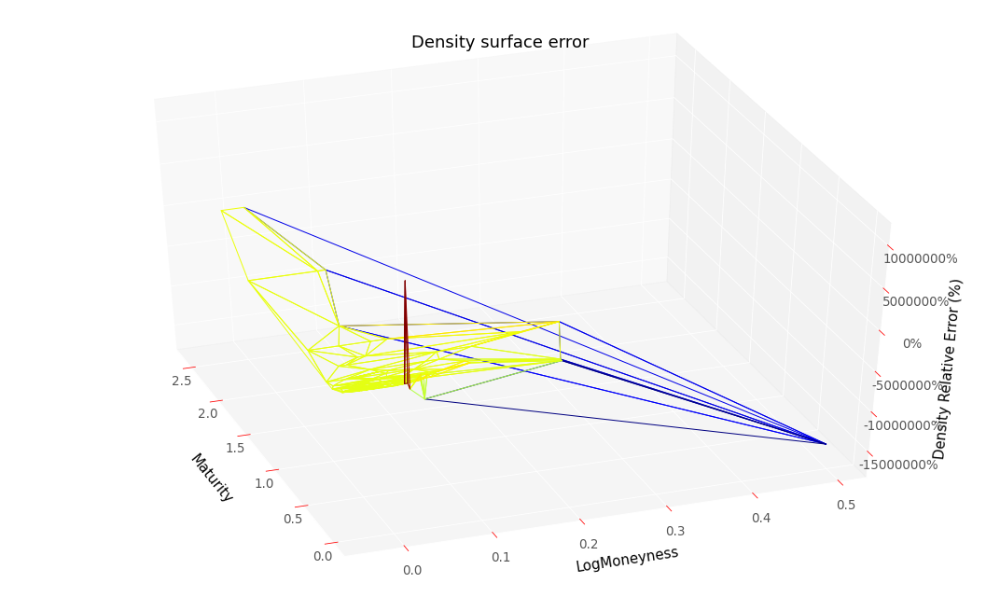

RMSE :  1.1933662070618518
RMSE Relative:  17924.83835991029


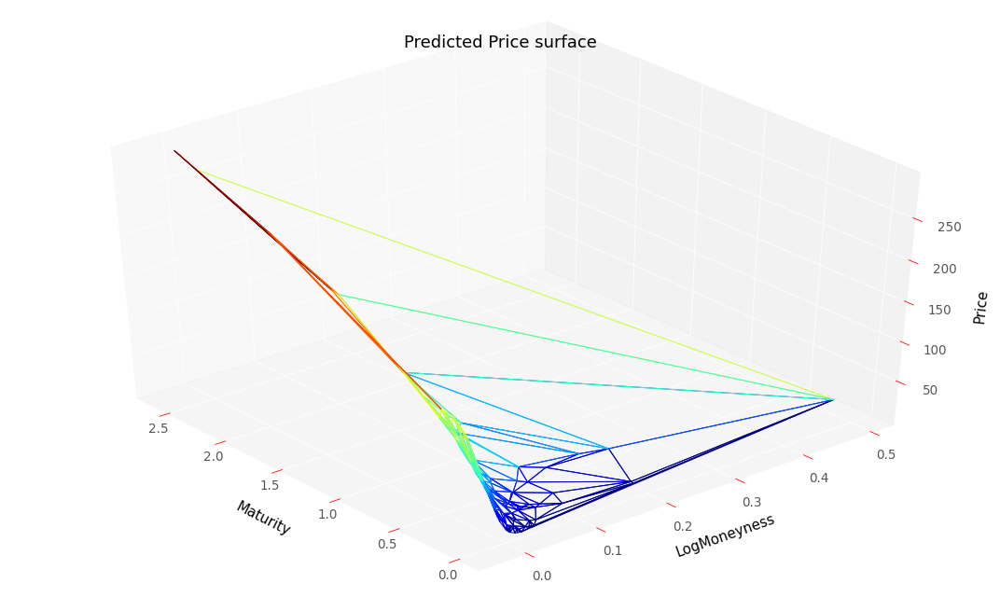

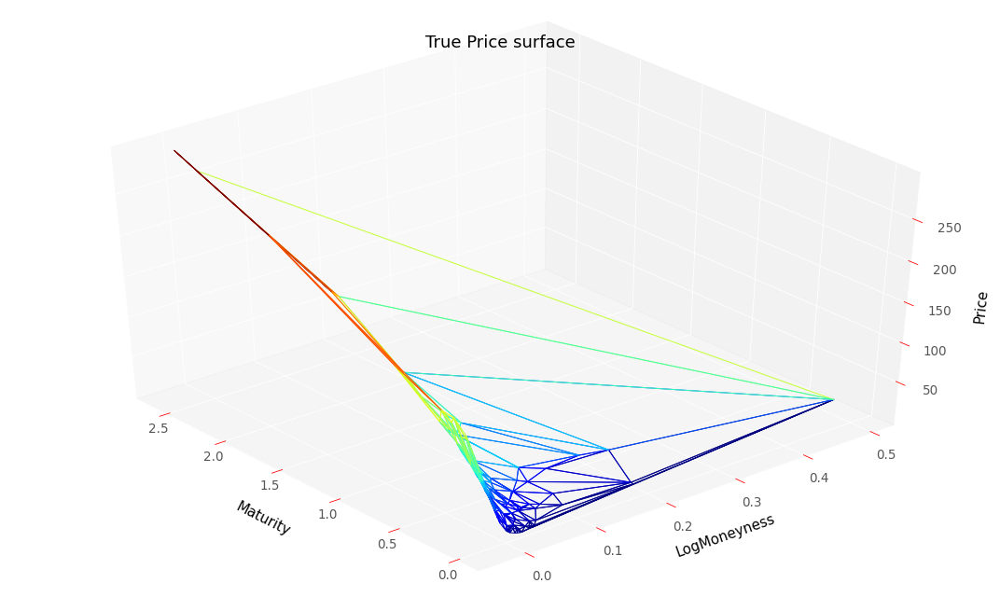

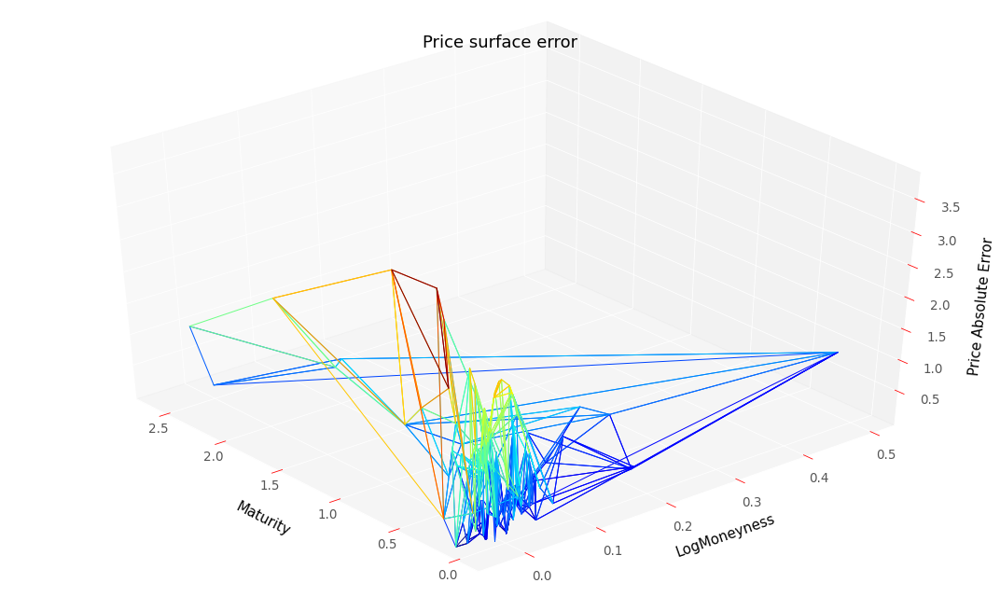

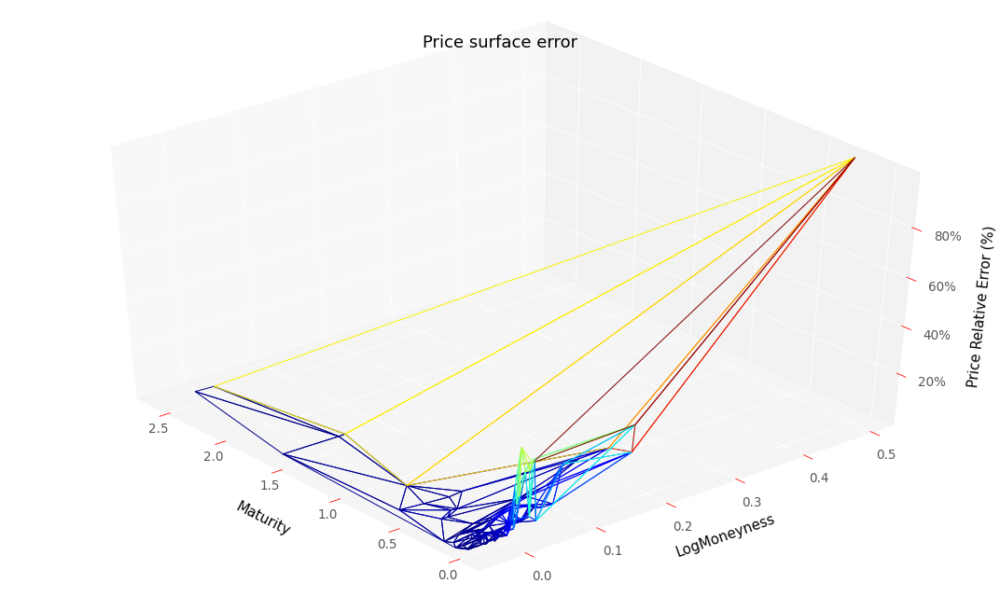

RMSE :  1.1909226724786148
RMSE Relative:  0.11991329322803018


In [ ]:
#Diagnosis for testing results
plotTools.modelSummaryGatheral(y_pred4TestG, 
                               volLocale4TestG, 
                               dNN_T4TestG, 
                               gNN_K4TestG, 
                               dataSetTest,
                               logMoneynessScale = True,
                               S0 = S0, 
                               bootstrap = bootstrap, 
                               thresholdPrice = None,
                               yMin = KMin + 0.0001,
                               yMax = KMax)

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


In [ ]:
# Function which evaluates neural local volatility when neural network is fitted on implied volatilities
def neuralVolLocaleGatheral(s,t):
    vLoc = neuralNetwork.evalVolLocaleGatheral(neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                               s, t,
                                               dataSet,
                                               hyperparameters,
                                               scaler,
                                               bootstrap,
                                               S0,
                                               modelName = "convexSoftGatheralVolModel")
    return vLoc.dropna()

In [ ]:
#Artificial grid with 10000 points which aims to limit the impact of linear interpolation
strikeLow = min(dataSet["Strike"].min(),dataSetTest["Strike"].min()) #dataSet["Strike"].min()
strikeUp = max(dataSet["Strike"].max(),dataSetTest["Strike"].max()) #dataSet["Strike"].max()
strikeGrid = np.linspace(strikeLow, strikeUp, 100)
matLow = min(dataSet["Maturity"].min(),dataSetTest["Maturity"].min()) #dataSet["Maturity"].min()
matUp = max(dataSet["Maturity"].max(),dataSetTest["Maturity"].max()) #dataSetTest["Maturity"].max()
matGrid = np.linspace(matLow, matUp, 100)
volLocaleGrid = np.meshgrid(strikeGrid, matGrid)

In [ ]:
volLocalInterp7 = neuralVolLocaleGatheral(volLocaleGrid[0].flatten(),
                                          volLocaleGrid[1].flatten())
volLocalInterp7.head()

In [ ]:
volLocalInterp8 = neuralVolLocaleGatheral(dataSetTest.index.get_level_values("Strike").values.flatten(),
                                          dataSetTest.index.get_level_values("Maturity").values.flatten())
volLocalInterp8.head()

In [ ]:
#Local volatility function for backtests
nnVolLocale7 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp7, x, y)

In [ ]:
#Local volatility function for backtests
nnVolLocale8 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp8, x, y)

In [ ]:
importlib.reload(plotTools)

In [ ]:
plotTools.plotSerie(volLocalInterp7,
                    Title = 'Local Volatility',
                    az=105,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=False)

In [ ]:
plotTools.plotSerie(volLocalInterp8,
                    Title = 'Local Volatility',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

In [ ]:
nbTimeStep = 100
nbPaths = 100000

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the 10000 points grid.
mcResVolLocale7 = backtest.MonteCarloPricerVectorized(S0,
                                                      dataSetTest,
                                                      bootstrap,
                                                      nbPaths,
                                                      nbTimeStep,
                                                      nnVolLocale7)
mcResVolLocale7.head()

In [ ]:
#Diagnose backtest results
plotTools.predictionDiagnosis(mcResVolLocale7["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocale7.to_csv("mcResVolLocale7.csv")

In [ ]:
importlib.reload(backtest)

In [ ]:
#PDE backtest with a cranck nicholson scheme
pdeResVolLocale7 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale7, bootstrap)
pdeResVolLocale7.head()

In [ ]:
#Backtest diagnosis
plotTools.predictionDiagnosis(pdeResVolLocale7, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResVolLocale7.to_csv(workingFolder + "pdeResVolLocale7.csv")

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the testing grid.
mcResVolLocale8 = backtest.MonteCarloPricerVectorized(S0,
                                                      dataSetTest,
                                                      bootstrap,
                                                      nbPaths,
                                                      nbTimeStep,
                                                      nnVolLocale8)
mcResVolLocale8.head()

In [ ]:
plotTools.predictionDiagnosis(mcResVolLocale8["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocale8.to_csv("mcResVolLocale8.csv")

In [ ]:
pdeResVolLocale8 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale8, bootstrap)
pdeResVolLocale8.head()

In [ ]:
plotTools.predictionDiagnosis(pdeResVolLocale8, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResVolLocale8.to_csv(workingFolder + "pdeResVolLocale8.csv")

# Learning Price
Yon can skip the training step by loading in the left panel in colab workspace tensorflow models. These models are contained in the results folder of github repository.

In [ ]:
hyperparameters = {}
#penalization coefficient
hyperparameters["lambdaLocVol"] = 10#1#0.001#0.01 #100
hyperparameters["lambdaSoft"] = 1000#100#0.0001#10#10 #100 
hyperparameters["lambdaGamma"] = 10000000#10000#100#10 #10000

#Derivative soft constraints parameters
hyperparameters["lowerBoundTheta"] = 0.01
hyperparameters["lowerBoundGamma"] = 0.00001

#Local variance parameters
hyperparameters["DupireVarCap"] = 10
hyperparameters["DupireVolLowerBound"] = 0.05
hyperparameters["DupireVolUpperBound"] = 0.40

#Learning scheduler coefficient
hyperparameters["LearningRateStart"] = 0.1
hyperparameters["Patience"] = 100
hyperparameters["batchSize"] = 50
hyperparameters["FinalLearningRate"] = 1e-6
hyperparameters["FixedLearningRate"] = False

#Training parameters
hyperparameters["nbUnits"] = 100 #number of units for hidden layers
hyperparameters["maxEpoch"] = 10000#10000 #maximum number of epochs

In [ ]:
importlib.reload(neuralNetwork)

<module 'neuralNetwork' from '/content/neuralNetwork.py'>

In [ ]:
#Execute this cell if you want to fit neural network with prices
res = neuralNetwork.create_train_model(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                       scaledDataSet,
                                       True,
                                       hyperparameters,
                                       scaler,
                                       modelName = "convexSoftVolModel")
y_pred4, volLocale4, dNN_T4, gNN_K4, lossSerie4 = res

Iteration :  425 new learning rate :  0.010000000000000002
Best loss (hidden nodes: 100, iterations: 426): 2.24
Best Penalization :  [2.2350106, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0]]
Iteration :  1891 new learning rate :  0.0010000000000000002
Best loss (hidden nodes: 100, iterations: 1892): 0.84
Best Penalization :  [0.84305745, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0]]
Iteration :  6763 new learning rate :  0.00010000000000000003
Best loss (hidden nodes: 100, iterations: 6764): 0.58
Best Penalization :  [0.5848478, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0]]
Best loss (hidden nodes: 100, iterations: 10000): 0.56
Best Penalization :  [0.56271535, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0]]
Training Time :  1014.824821472168


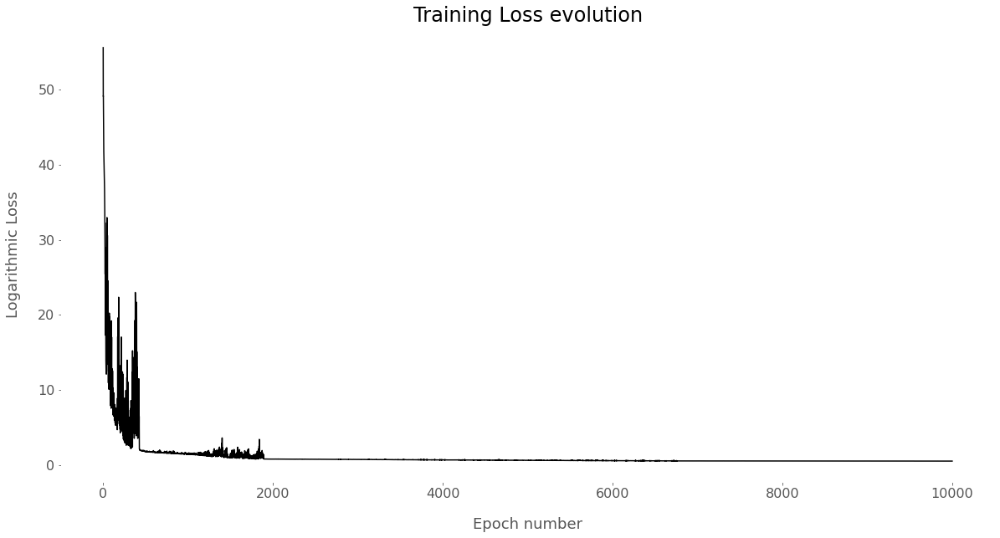

0.5635265111923218

In [ ]:
plotTools.plotEpochLoss(lossSerie4)
lossSerie4.iloc[-1]

In [ ]:
importlib.reload(plotTools)

<module 'plotTools' from '/content/plotTools.py'>

Best loss (hidden nodes: 100, iterations: 0): 0.56
Best Penalization :  [0.56271535, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0]]
Number of static arbitrage violations :  6
Arbitrable total variance :  Strike  Maturity
2525.0  0.036          0.690872
2975.0  0.005        113.897797
3000.0  1.090        230.573547
3015.0  0.016        154.568253
3100.0  0.093        237.540359
4200.0  2.585       1245.144043
Name: Price, dtype: float32


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


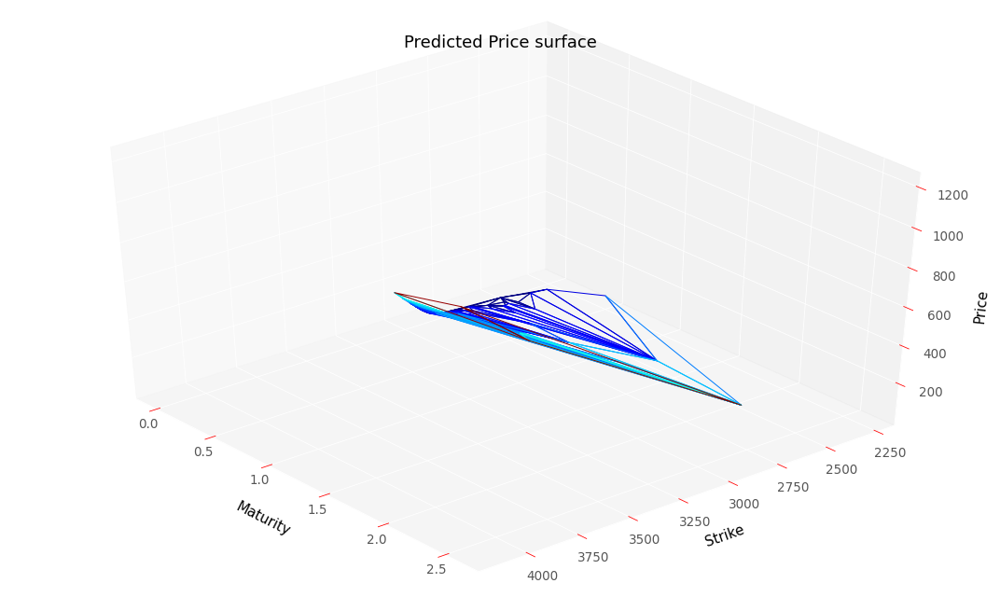

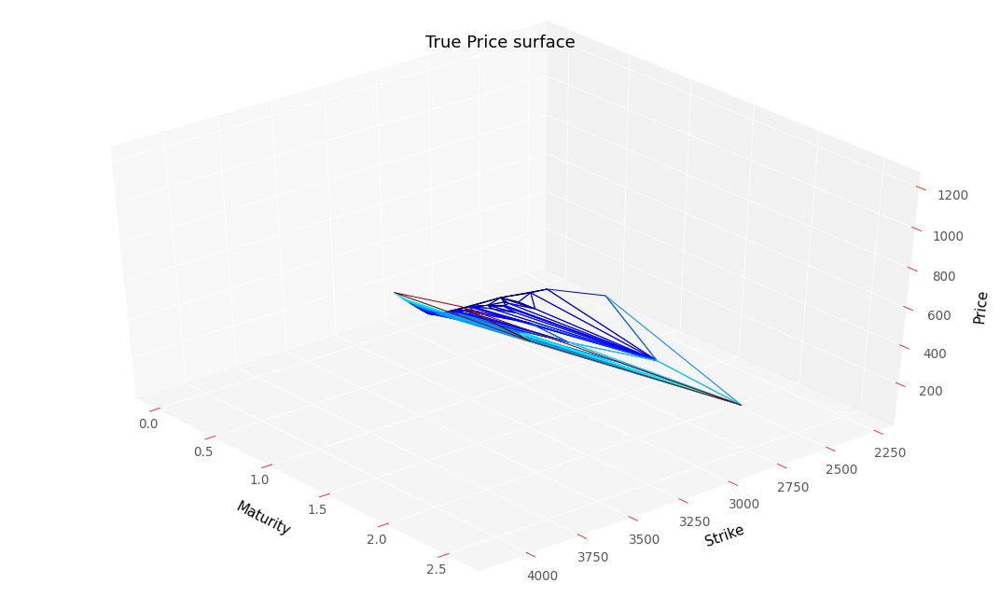

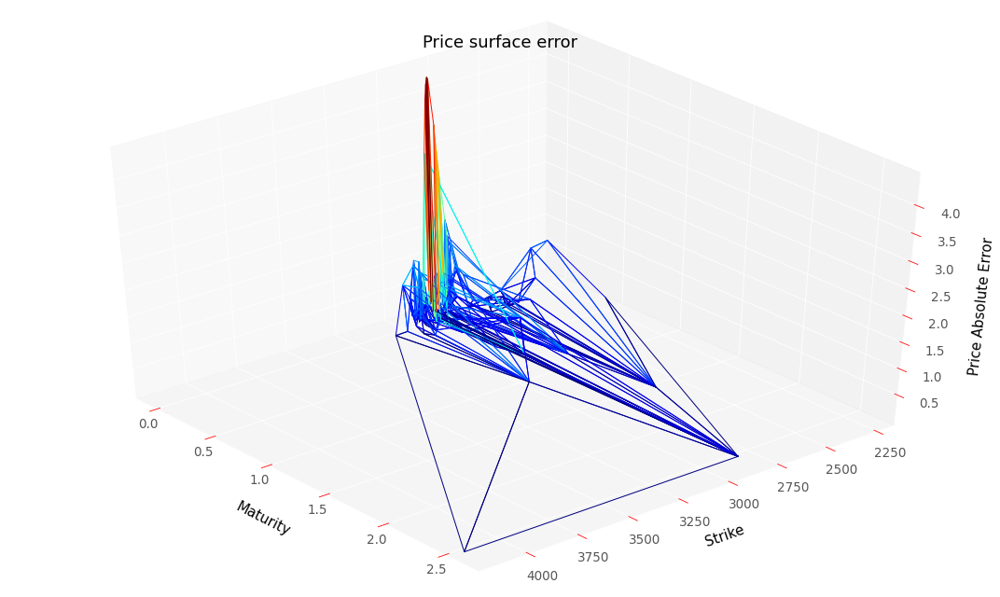

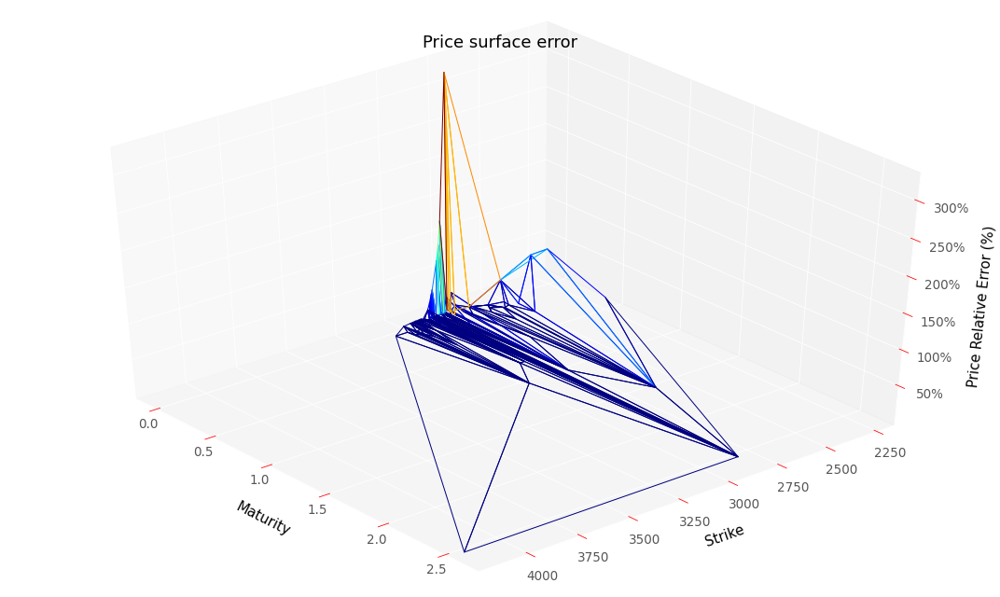

RMSE :  1.0894647976444245
RMSE Relative:  0.3468644447611108


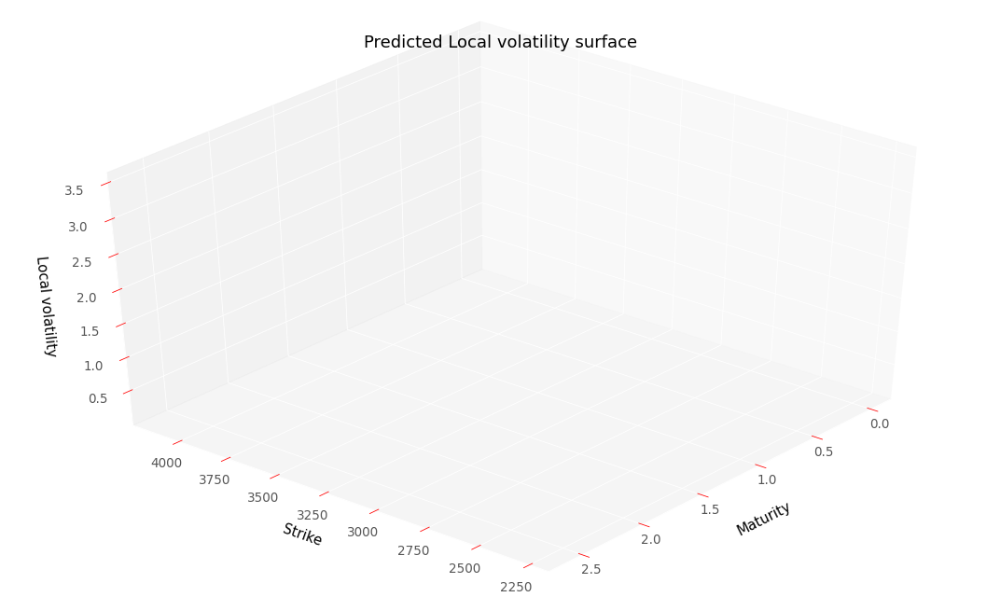

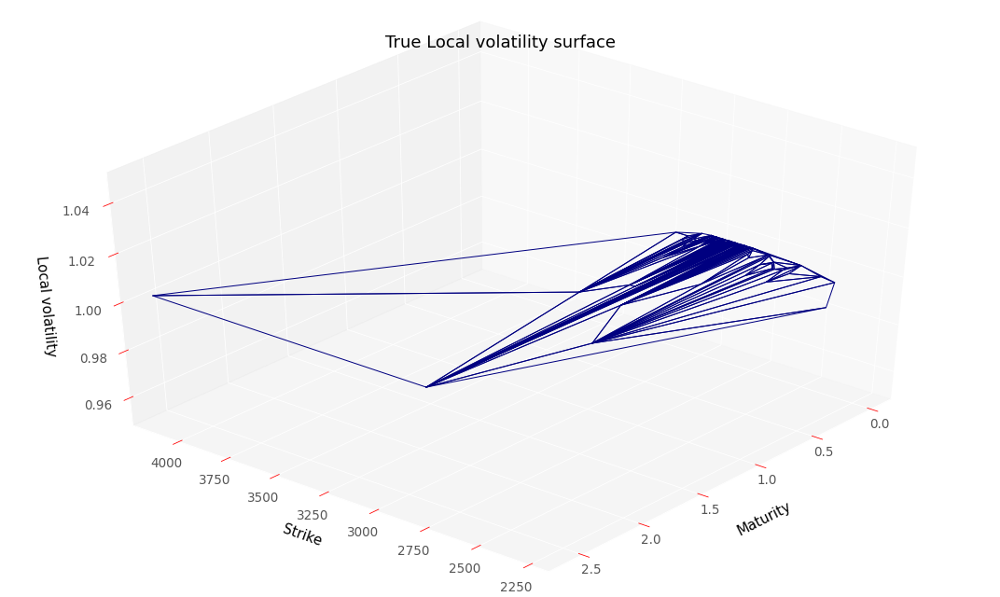

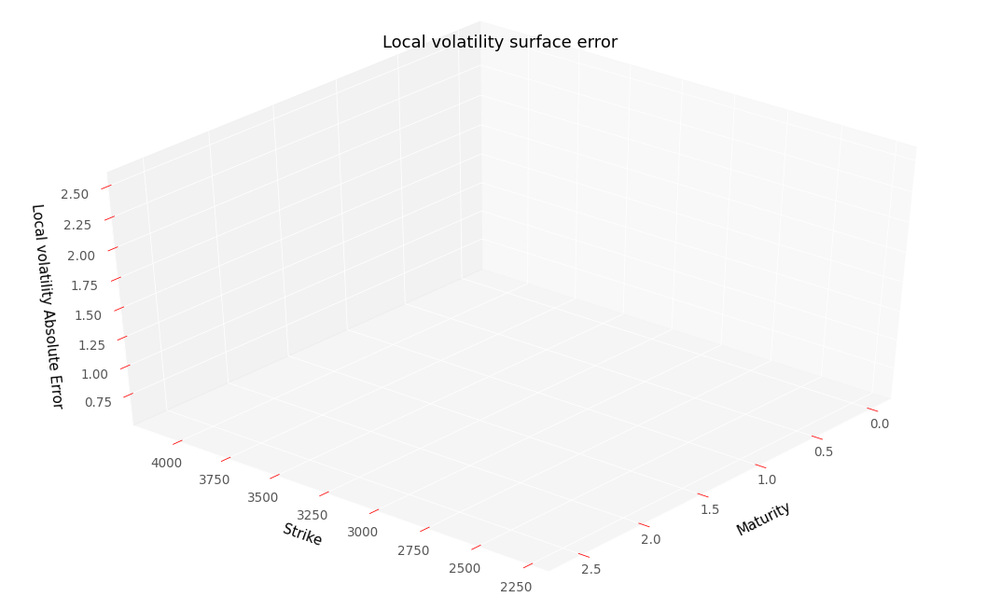

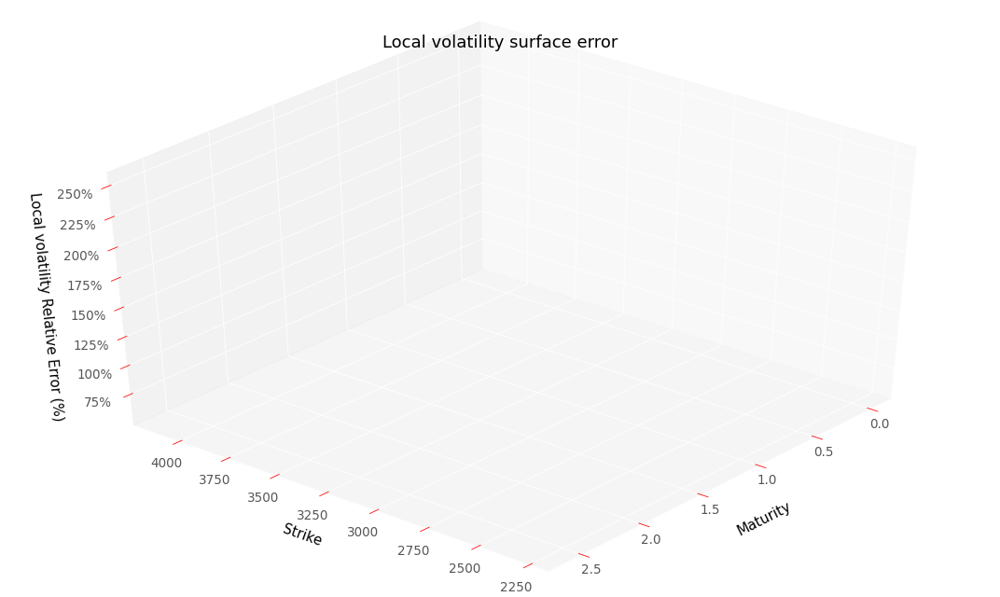

RMSE :  0.870179839578637
RMSE Relative:  0.870179839578637


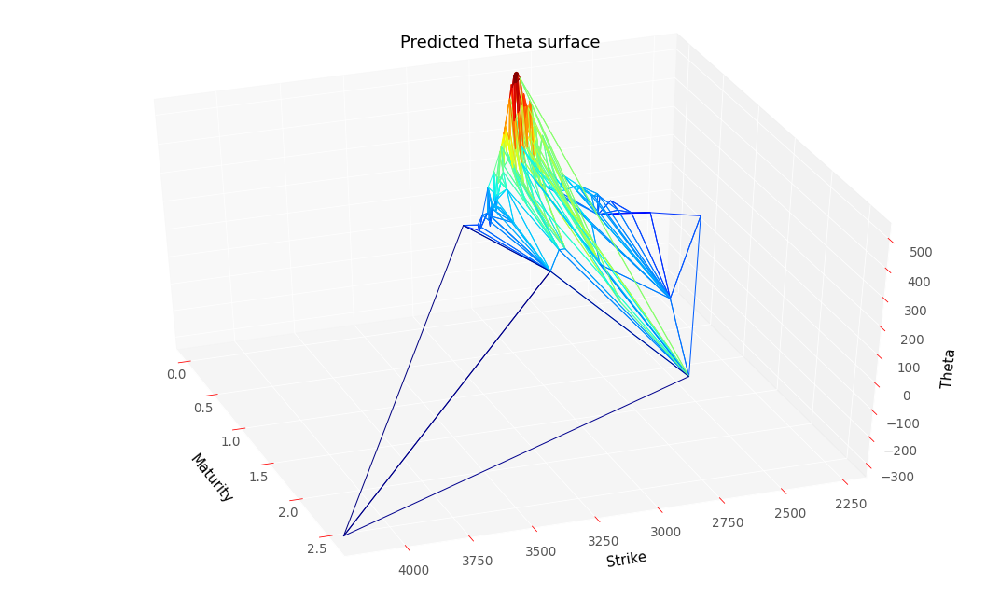

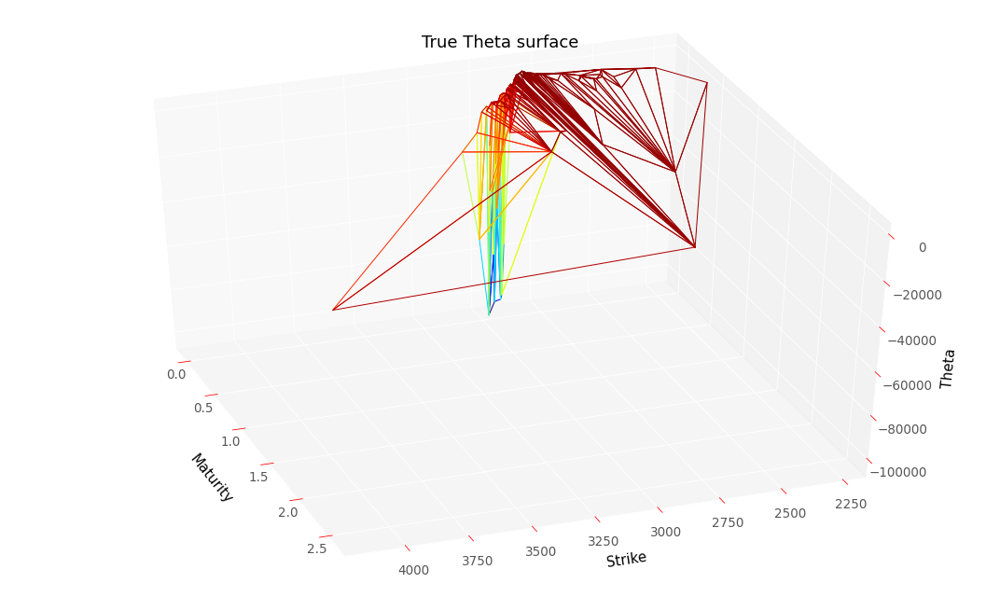

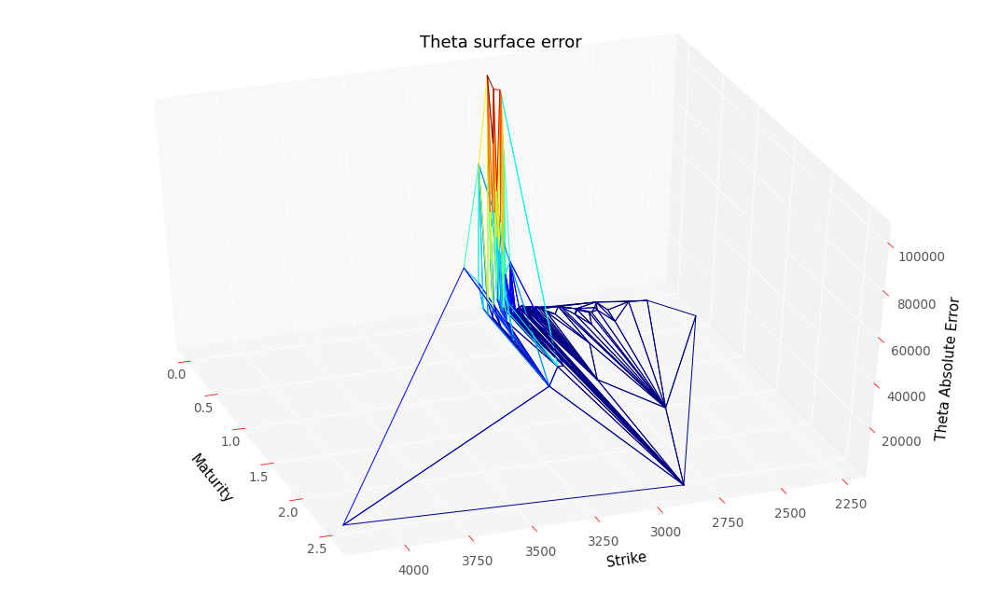

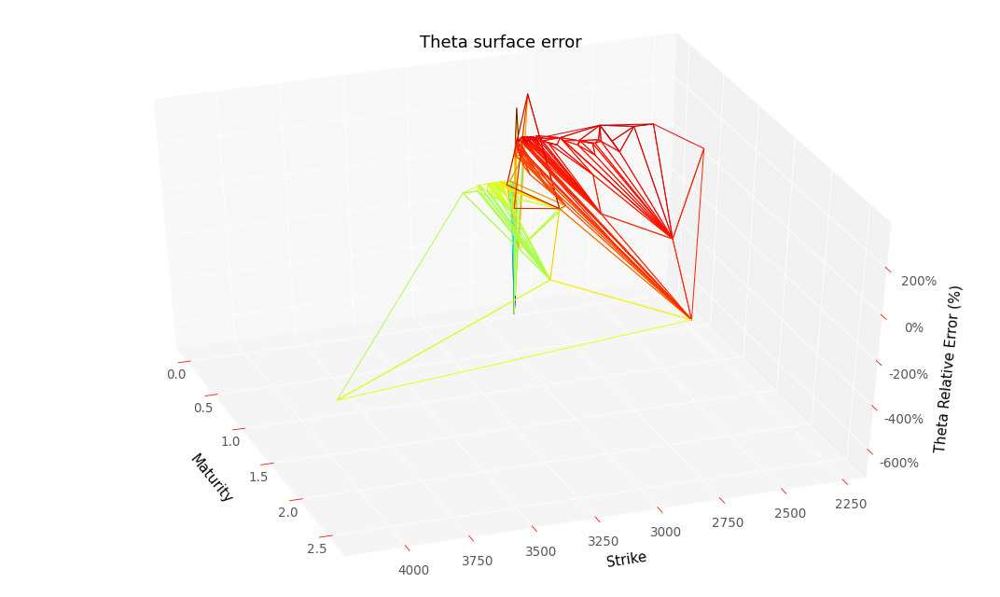

RMSE :  24465.489343348552
RMSE Relative:  1.3249208120909002


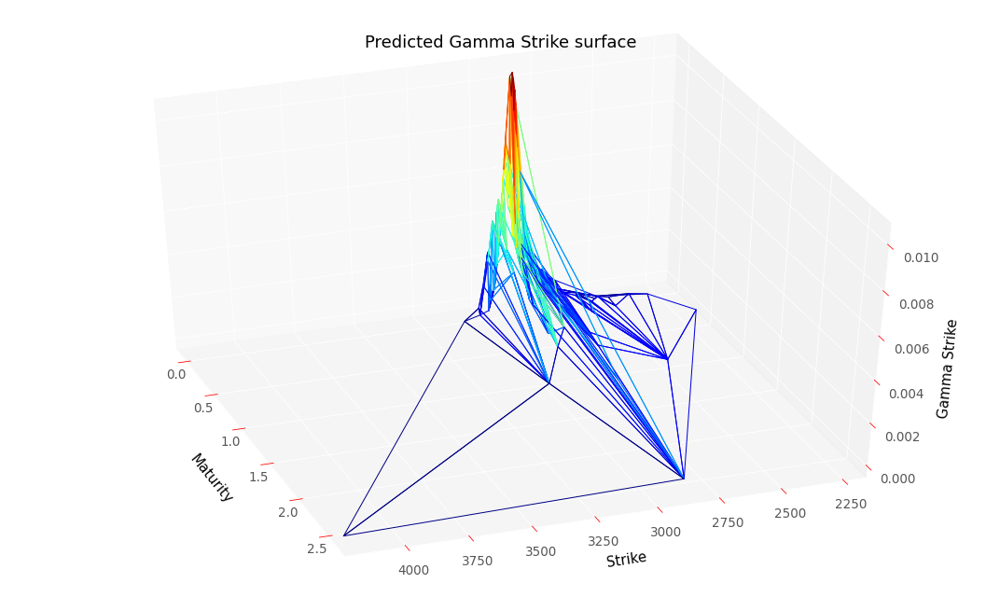

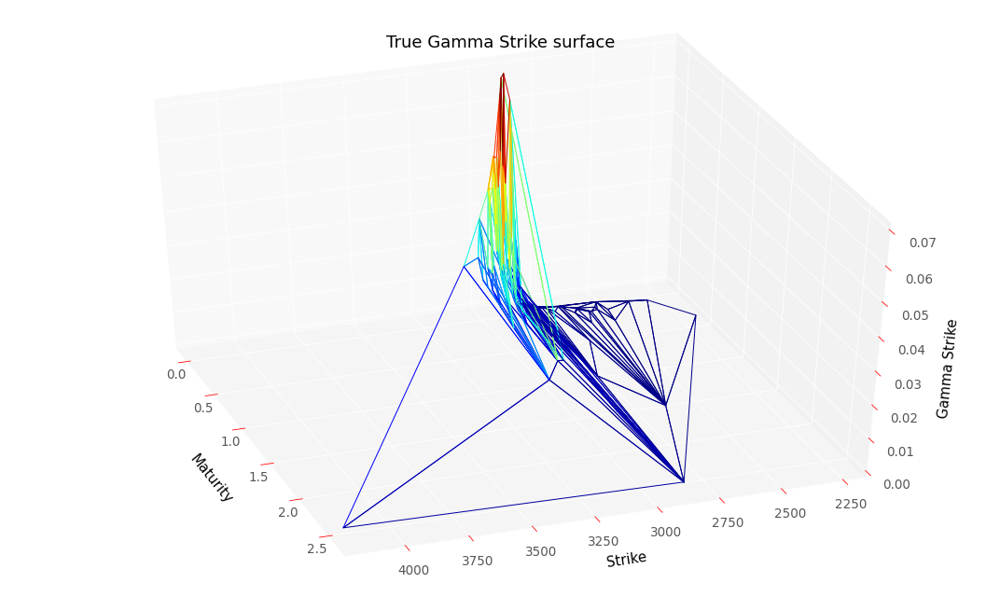

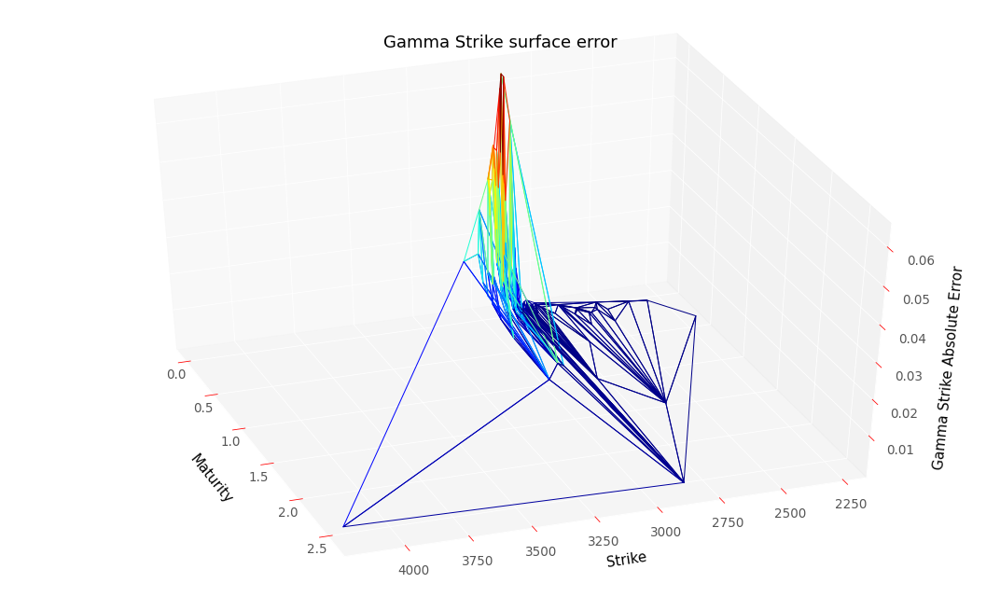

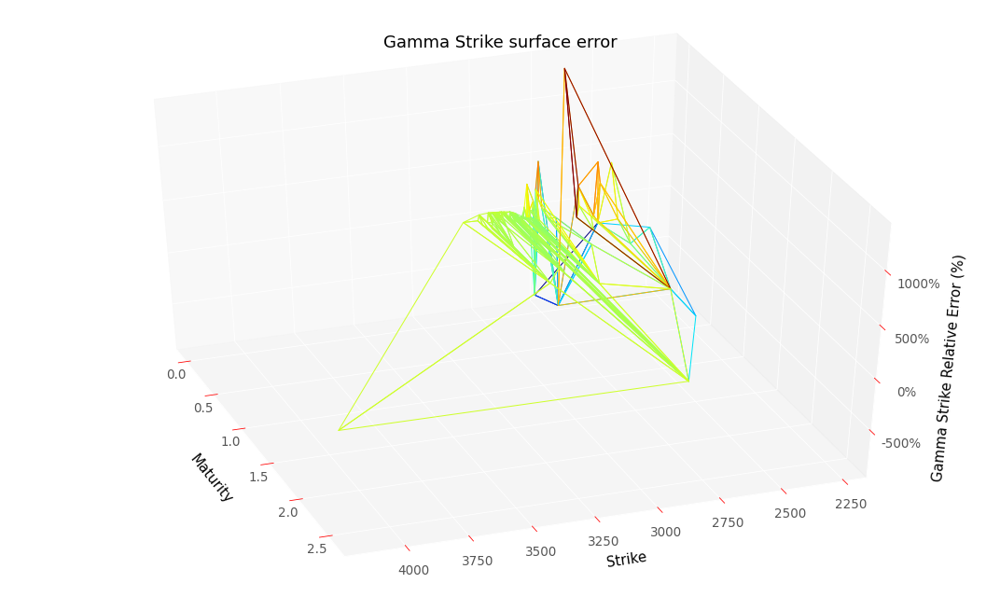

RMSE :  0.018382911932397546
RMSE Relative:  2.135787088956192


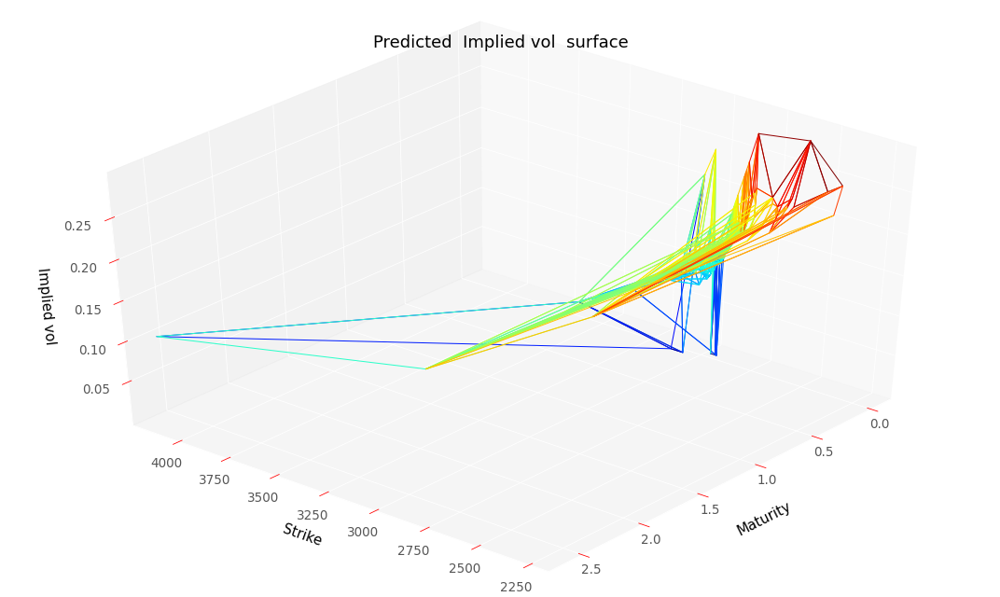

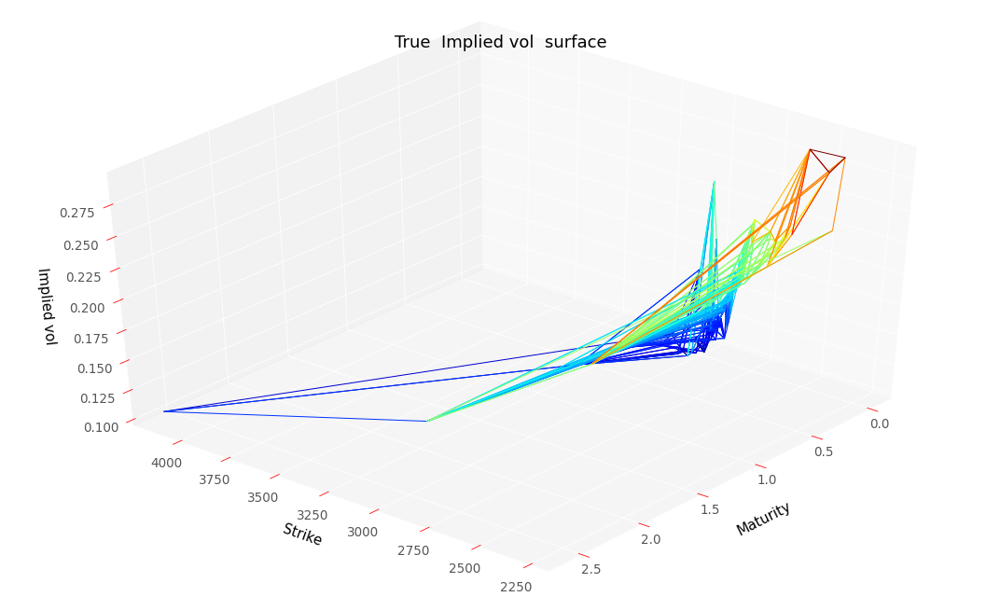

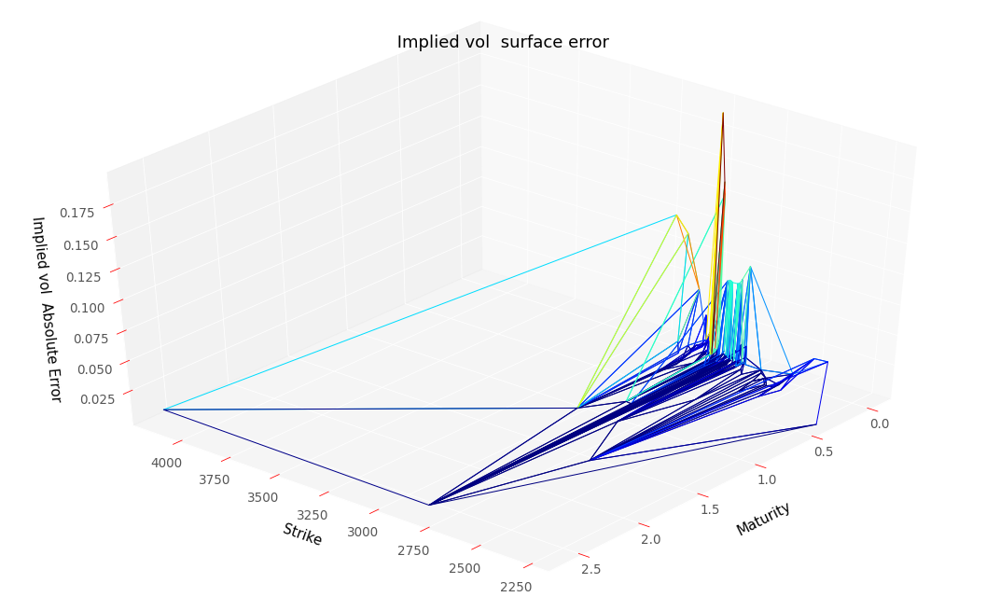

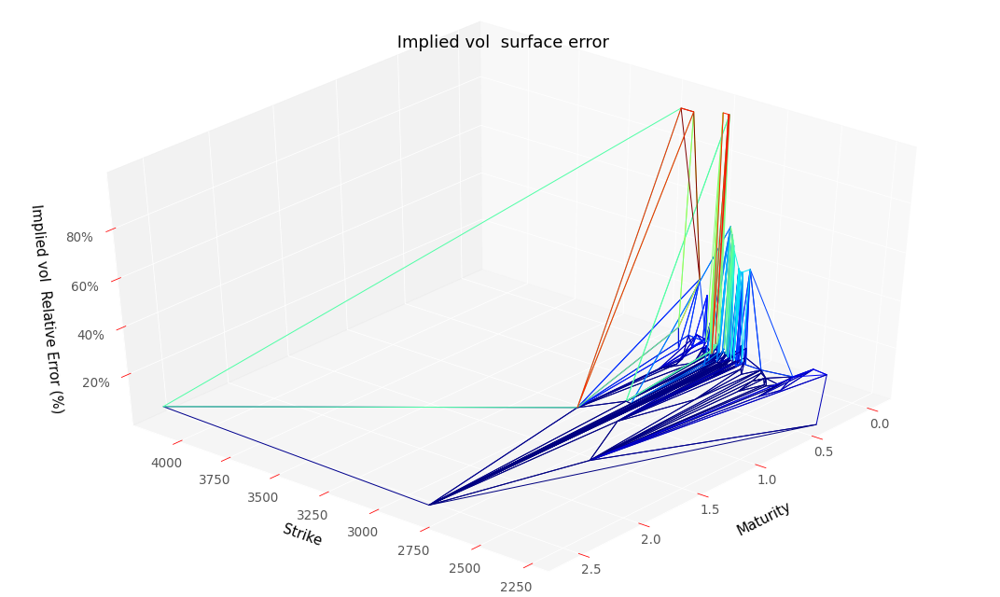

RMSE :  0.03376068882479501
RMSE Relative:  0.23425868981056855


In [ ]:
# Evaluate results on the training set, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                      scaledDataSet,
                                      True,
                                      hyperparameters,
                                      scaler,
                                      modelName = "convexSoftVolModel")
y_pred4, volLocale4, dNN_T4, gNN_K4, lossSerie4 = res

plotTools.modelSummary(y_pred4,
                       volLocale4, 
                       dNN_T4, 
                       gNN_K4, 
                       dataSet,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralPriceTrain")

In [ ]:
volLocale4.loc[(midS0,slice(None))]

Strike  Maturity
2860.0  0.005       0.114330
        0.011       0.128004
        0.036       0.146228
        0.074       0.147123
        0.112       0.155197
        0.285       0.208849
Name: Dupire, dtype: float32

Best loss (hidden nodes: 100, iterations: 0): 0.74
Best Penalization :  [0.7440433, [0.0, 0.0, 0.0]]
Best Penalization (Refined Grid) :  [[0.0, 0.0, 0.0]]
Number of static arbitrage violations :  8
Arbitrable total variance :  Strike  Maturity
1700.0  0.246         0.709460
2750.0  1.588       179.612579
2775.0  1.588       187.753113
2900.0  2.585       296.422241
2980.0  0.011       119.338737
3000.0  0.016       139.461761
        0.027       139.110123
3005.0  0.016       144.501236
Name: Price, dtype: float32


/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "
/usr/local/lib/python3.6/dist-packages/pandas/core/computation/expressions.py:204: UserWarning: evaluating in Python space because the '+' operator is not supported by numexpr for the bool dtype, use '|' instead
  f"evaluating in Python space because the {repr(op_str)} "


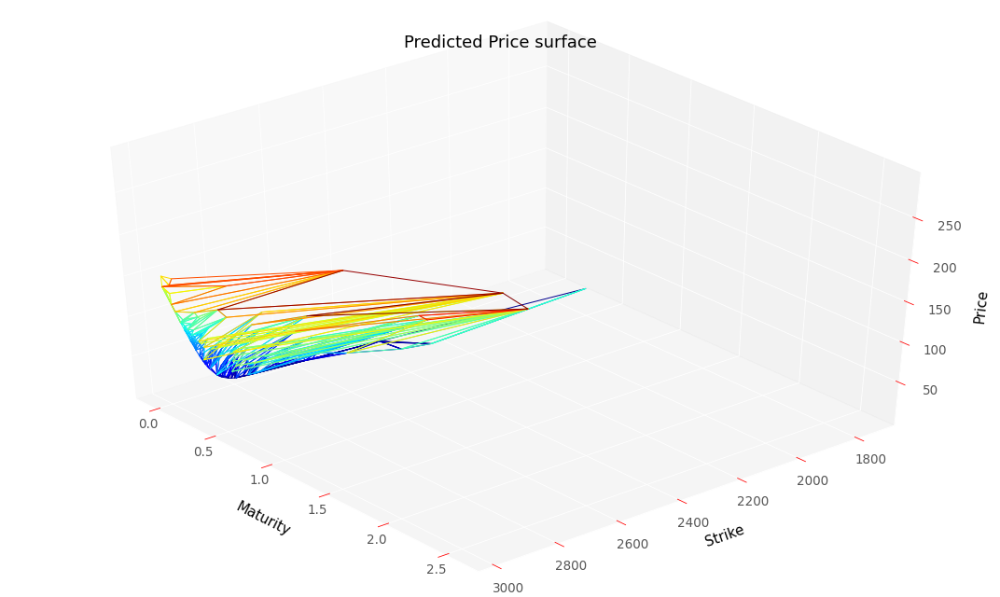

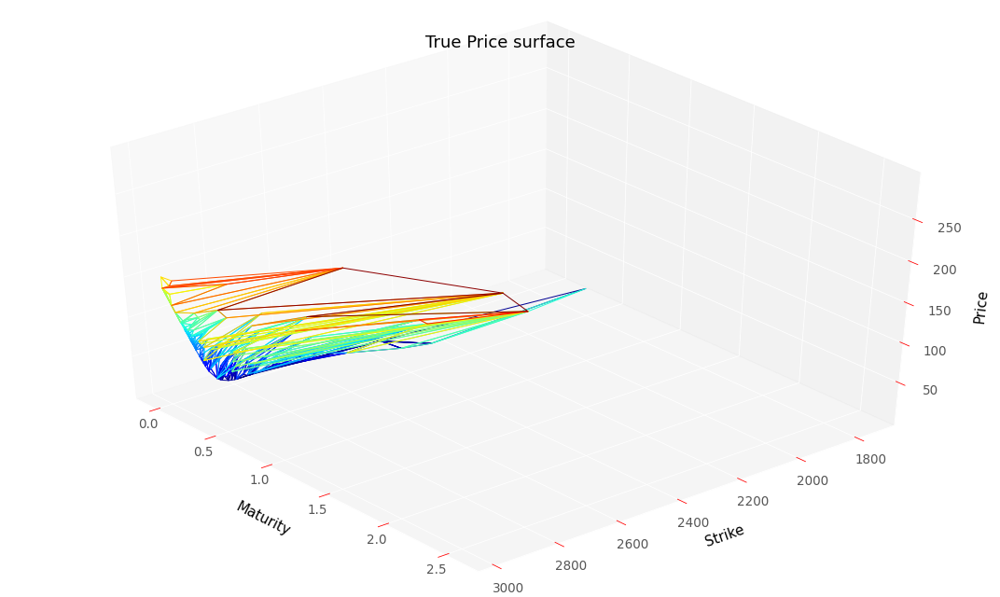

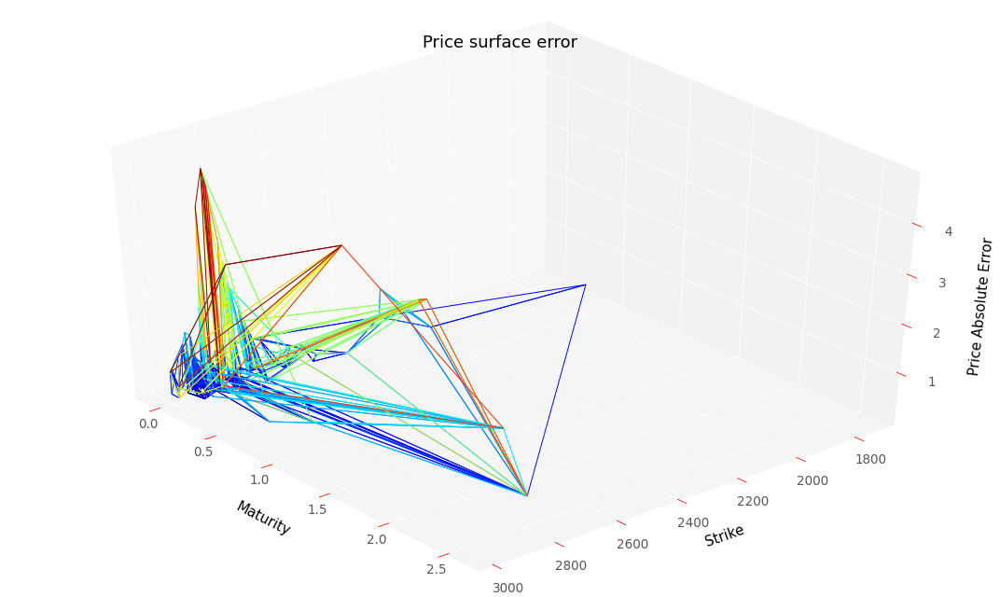

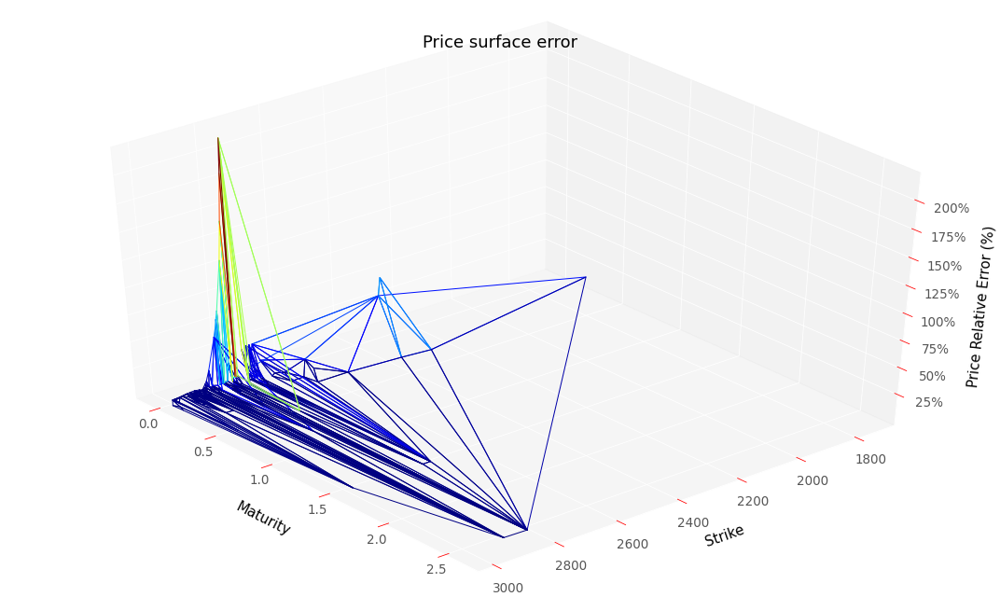

RMSE :  1.2370795397363028
RMSE Relative:  0.31514810519738035


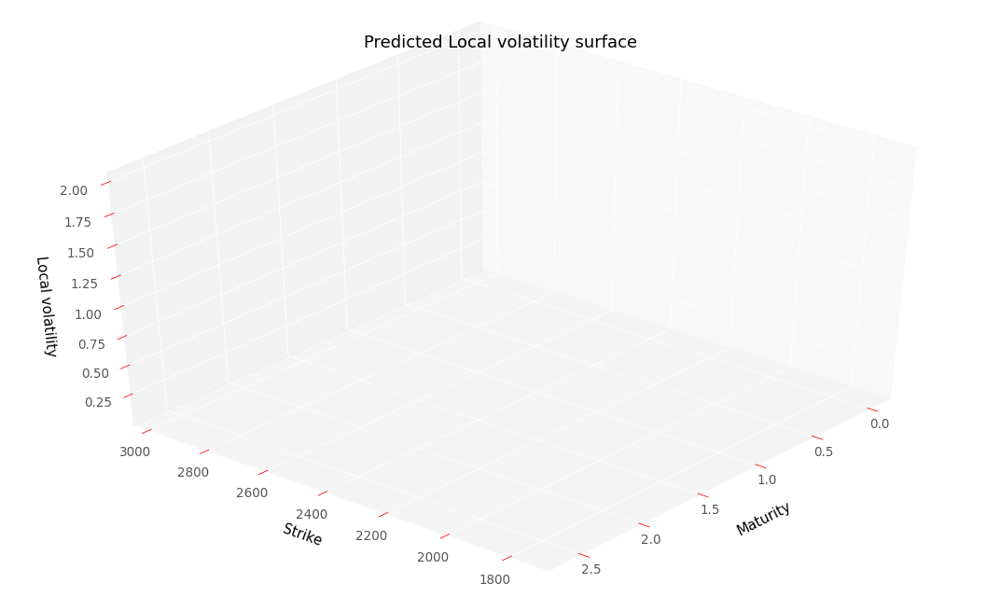

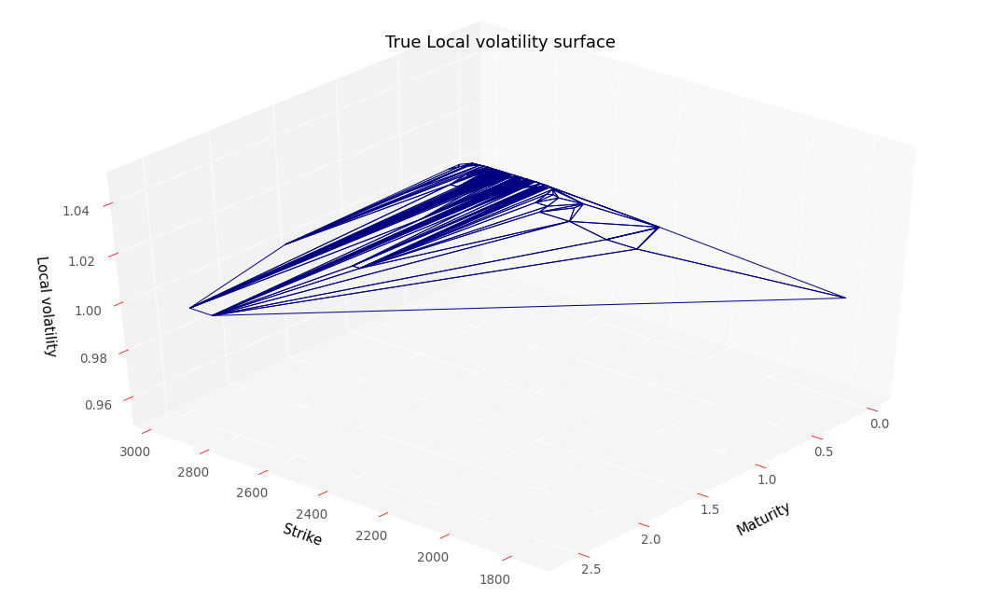

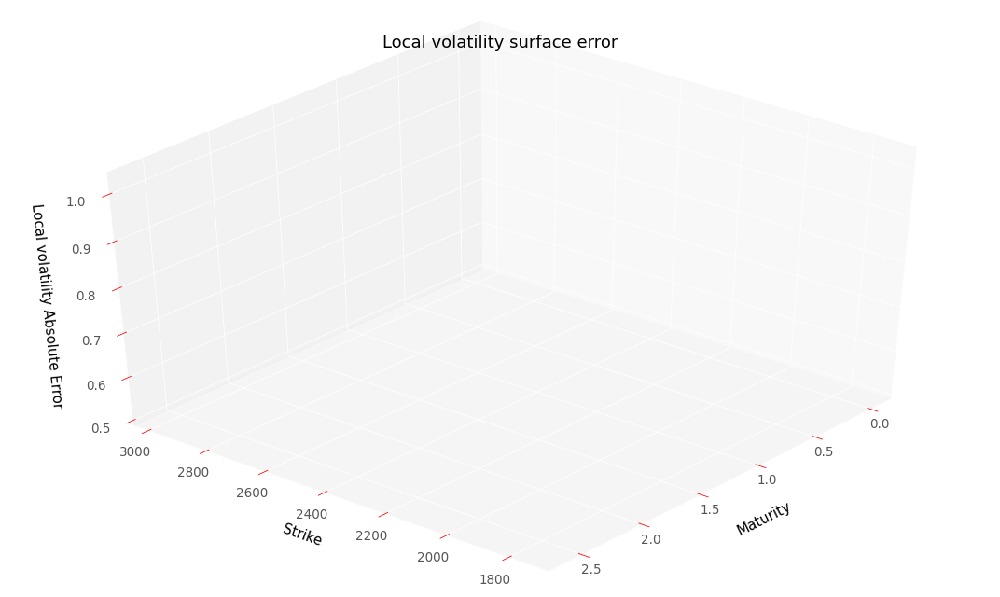

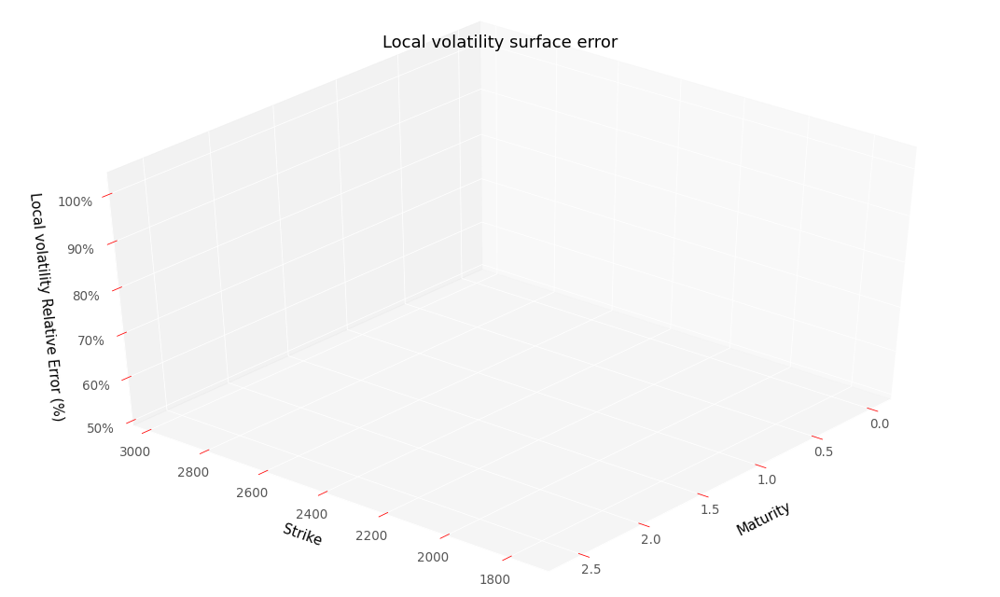

RMSE :  0.8512904443230285
RMSE Relative:  0.8512904443230285


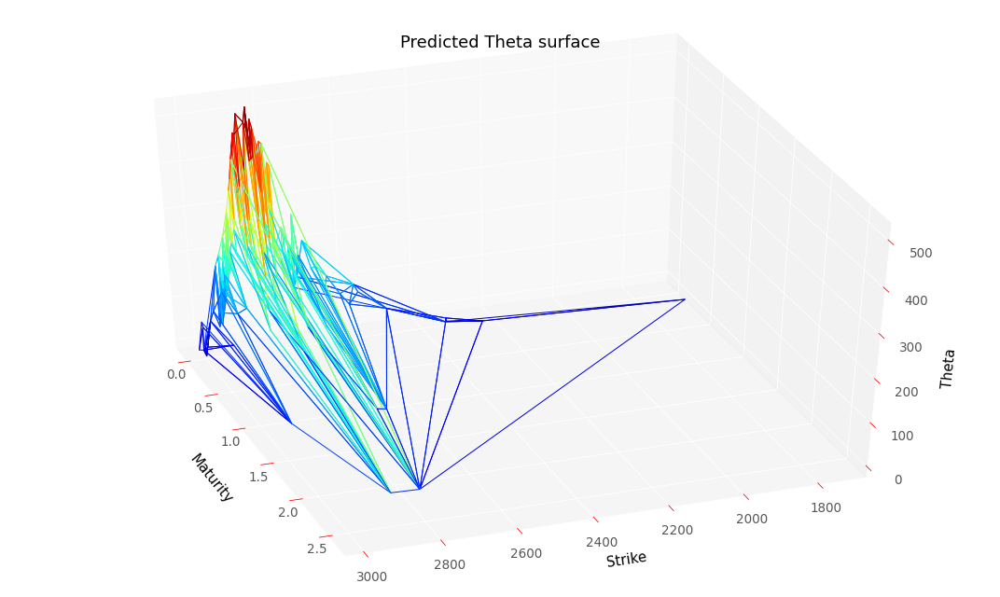

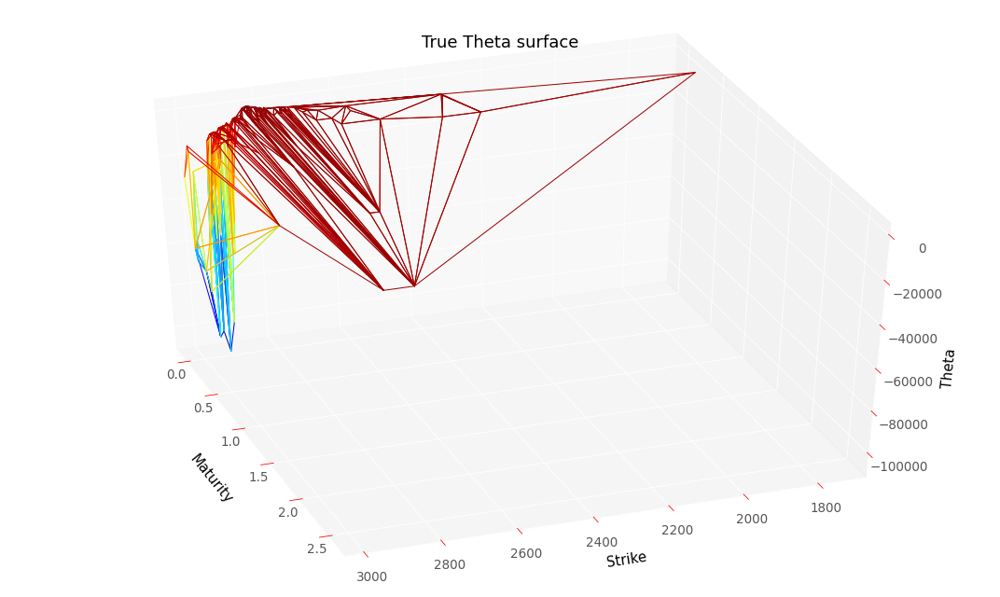

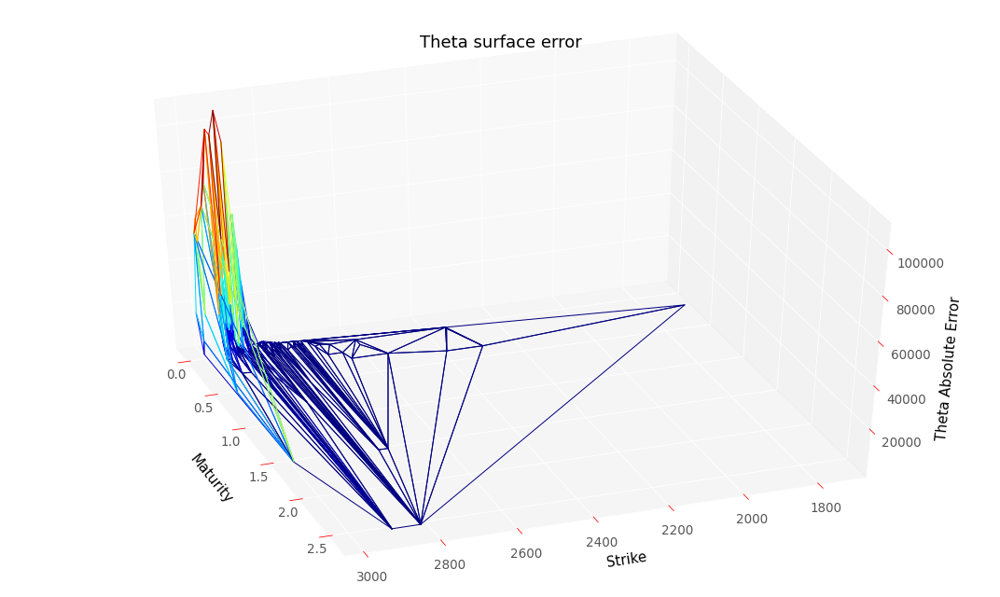

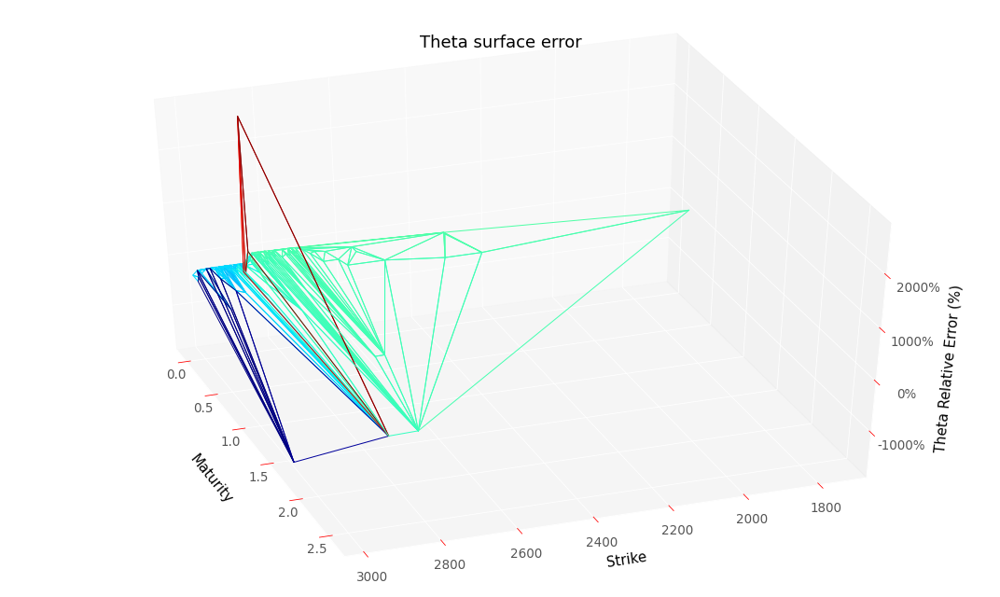

RMSE :  25105.988475917602
RMSE Relative:  2.951683703794445


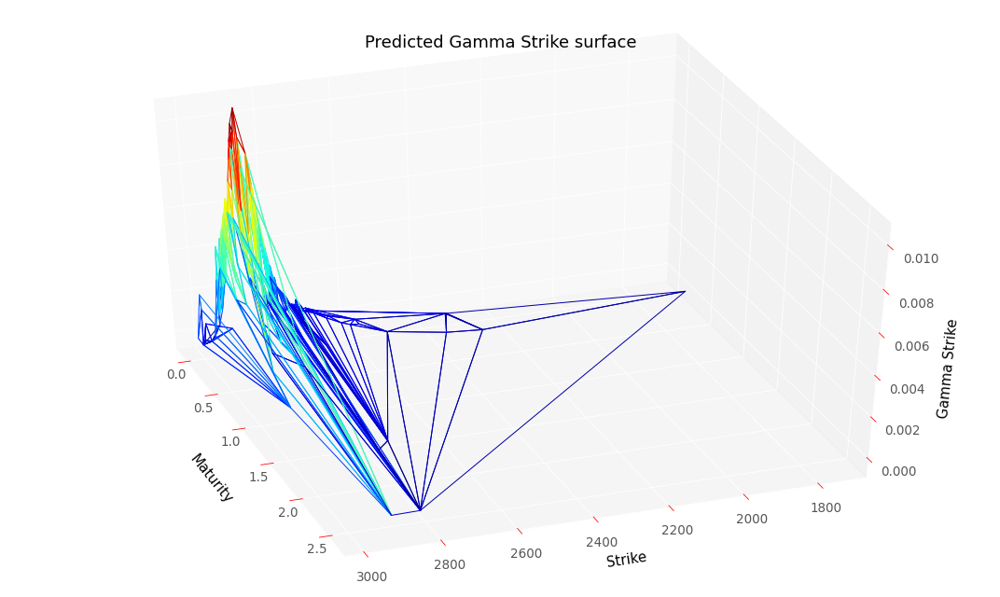

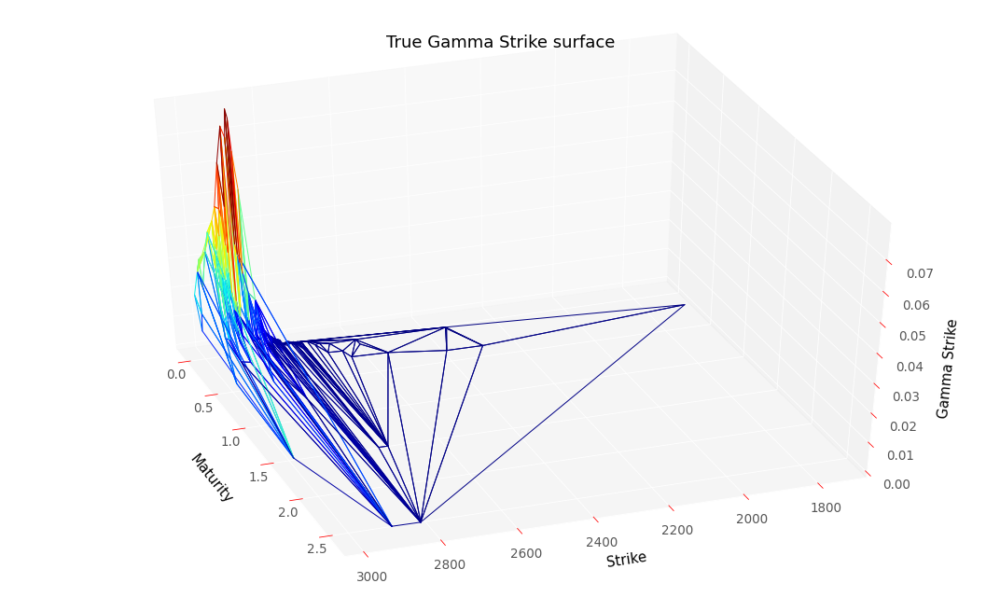

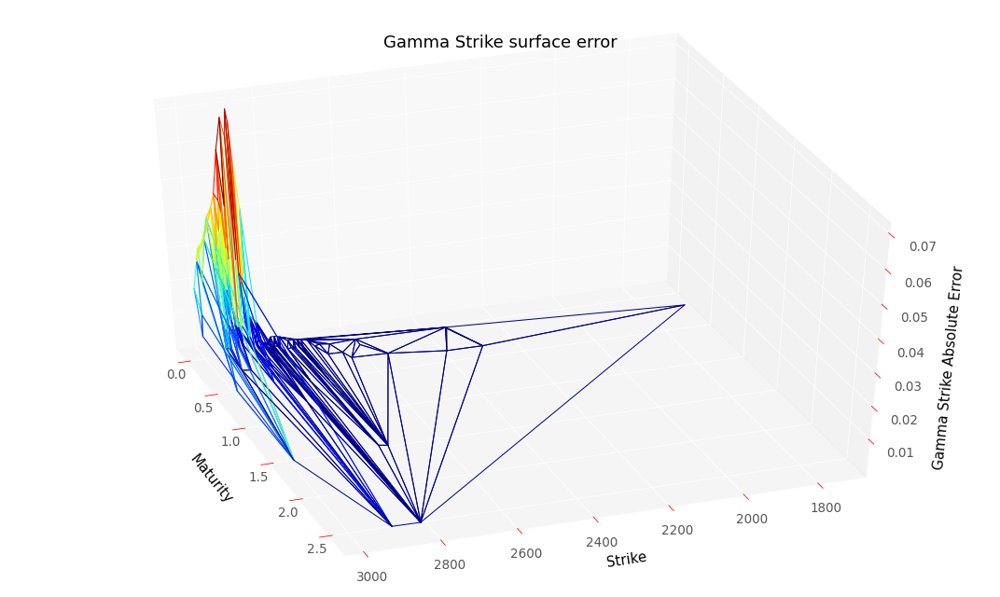

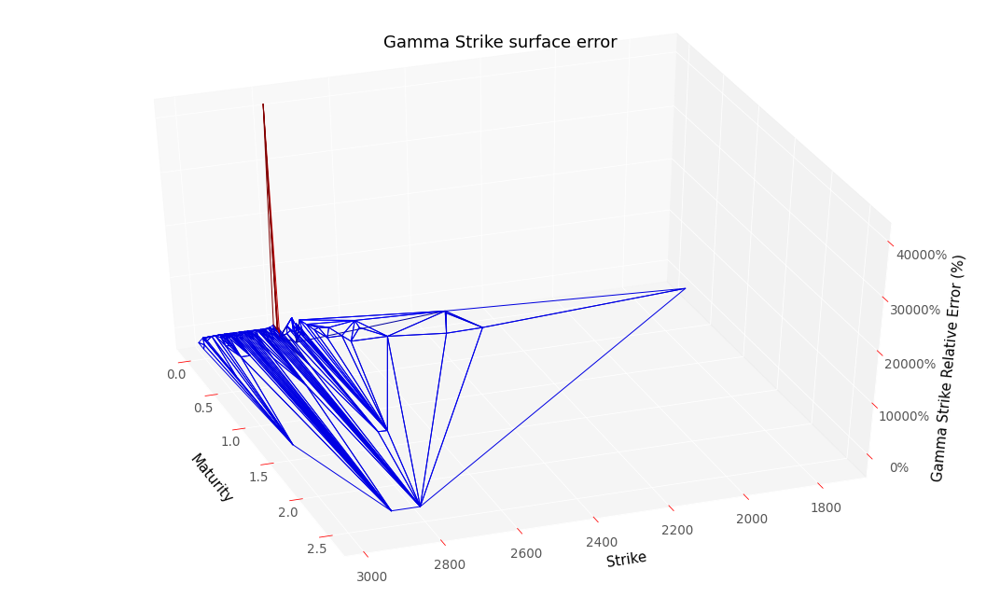

RMSE :  0.020237801060855536
RMSE Relative:  35.576641213409246


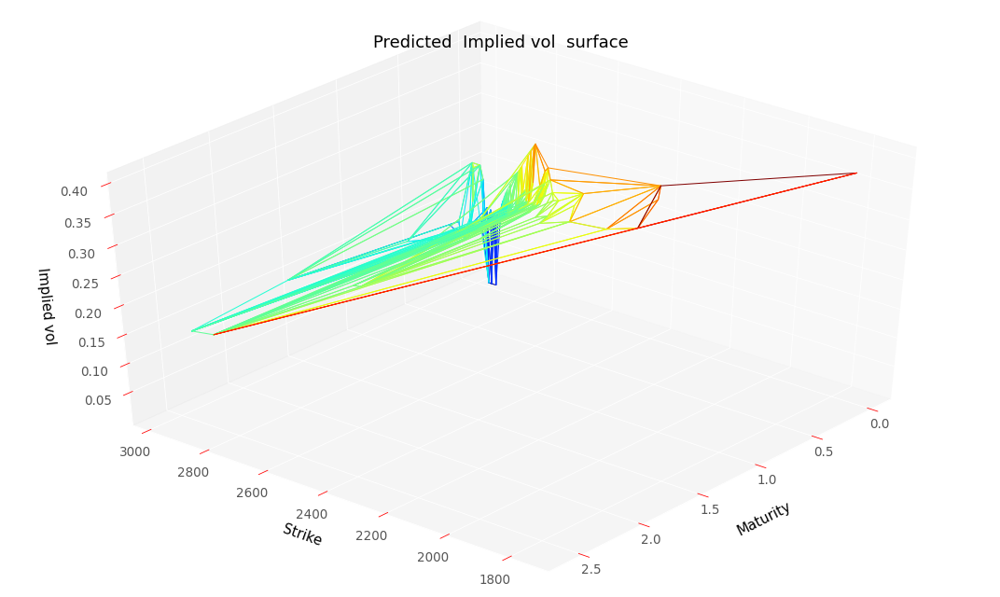

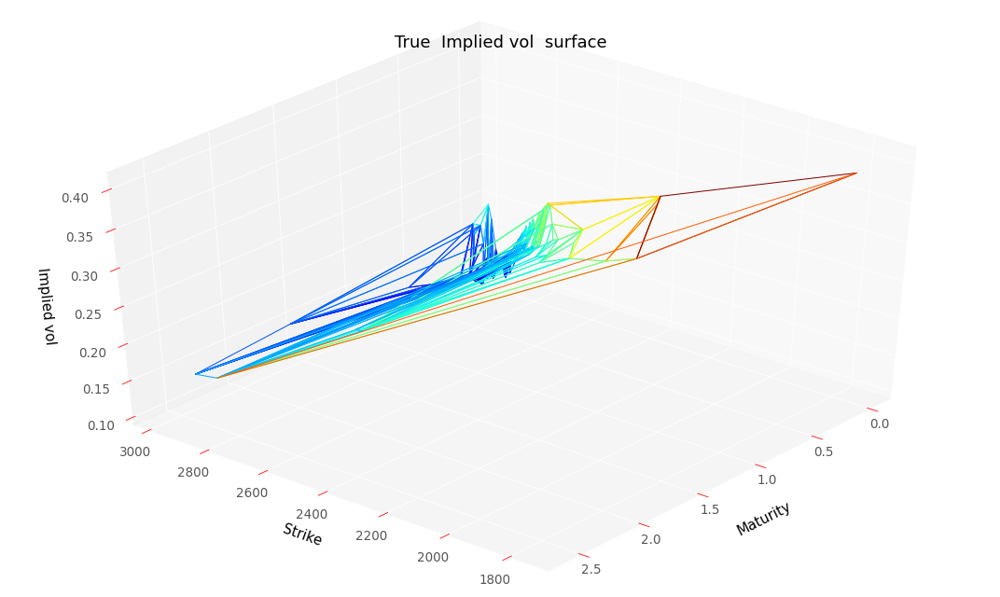

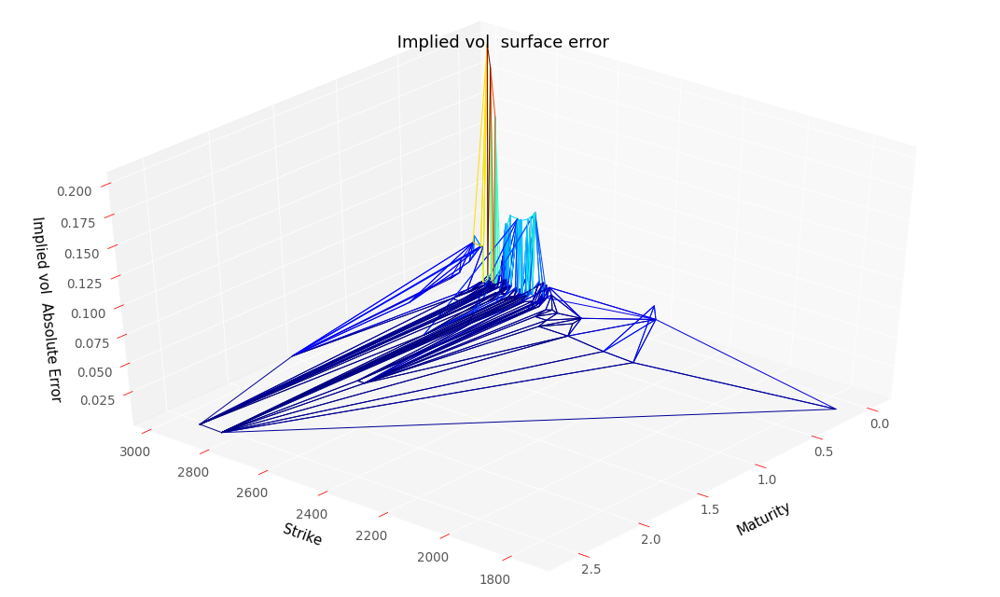

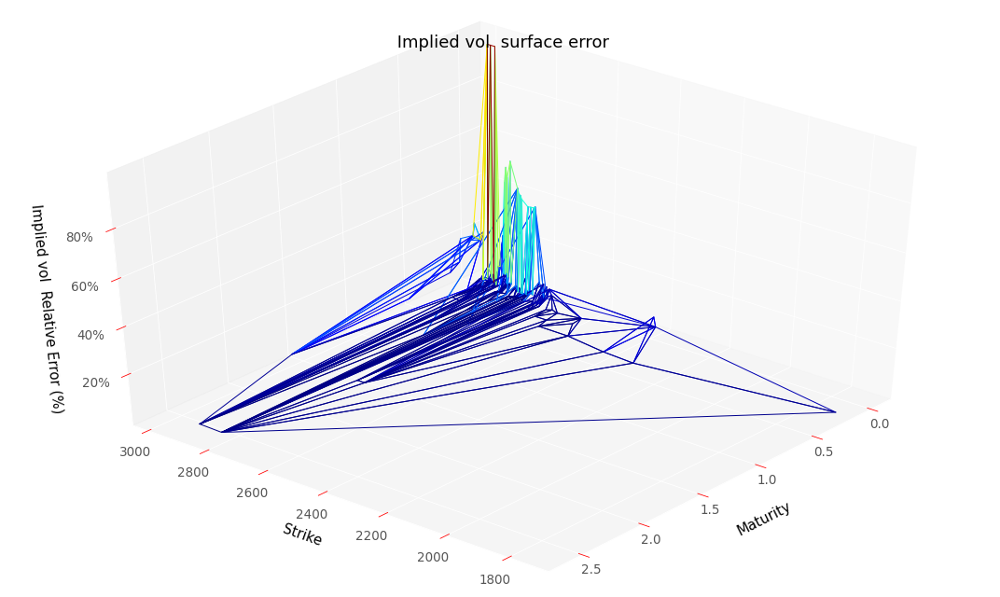

RMSE :  0.03341413483469009
RMSE Relative:  0.20109427511605663


In [ ]:
# Evaluate results on the testing dataset, you can execute that cell without training the model
res = neuralNetwork.create_eval_model(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                      scaledDataSetTest,
                                      True,
                                      hyperparameters,
                                      scaler,
                                      modelName = "convexSoftVolModel")
y_pred4Test, volLocale4Test, dNN_T4Test, gNN_K4Test, lossSerie4TestG = res

plotTools.modelSummary(y_pred4Test,
                       volLocale4Test,
                       dNN_T4Test,
                       gNN_K4Test,
                       dataSetTest,
                       S0,
                       bootstrap,
                       yMin = KMin,
                       yMax = KMax,
                       thresholdPrice = None, 
                       removeNaN = False,
                       savePath = "NeuralPriceTest")

#### Monte Carlo and PDE repricing backtests

During Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

Due to computation time issue we avoid to make millions of call to neural network and we interpolate linearly neural local volatility obtained on one the two possible grid :
- the testing grid i.e. nodes $(T,K)$ of the testing set.
- an artificial grid of 10000 points to check local volatility is correctly interpolated/extrapolated. That grid is the smallest rectangle containing the minimum and maximum maturities and the minimum and maximum strikes of our dataset (union of testing and training set).

During PDE backtest, we used a crank-nicholson scheme to revaluate each option in our testing set.
Time step corresponds to one day and space grid has 100 points. 


In [ ]:
S0

In [ ]:
# Function which evaluates neural local volatility when neural network is fitted on prices
def neuralVolLocalePrix(s,t):
    vLoc = neuralNetwork.evalVolLocale(neuralNetwork.NNArchitectureVanillaSoftDupire,
                                       s, t,
                                       dataSet,
                                       hyperparameters,
                                       scaler,
                                       bootstrap,
                                       S0,
                                       modelName = "convexSoftVolModel")
    return vLoc.dropna()

In [ ]:
importlib.reload(neuralNetwork)

In [ ]:
#Artificial grid with 10000 points which aims to limit the impact of linear interpolation
strikeLow = min(dataSet["Strike"].min(),dataSetTest["Strike"].min()) #dataSet["Strike"].min()
strikeUp = max(dataSet["Strike"].max(),dataSetTest["Strike"].max()) #dataSet["Strike"].max()
strikeGrid = np.linspace(strikeLow, strikeUp, 100)
matLow = min(dataSet["Maturity"].min(),dataSetTest["Maturity"].min()) #dataSet["Maturity"].min()
matUp = max(dataSet["Maturity"].max(),dataSetTest["Maturity"].max()) #dataSetTest["Maturity"].max()
matGrid = np.linspace(matLow, matUp, 100)
volLocaleGrid = np.meshgrid(strikeGrid, matGrid)

In [ ]:
volLocalInterp = neuralVolLocalePrix(volLocaleGrid[0].flatten(),
                                     volLocaleGrid[1].flatten())
volLocalInterp.head()

In [ ]:
volLocalInterp2 = neuralVolLocalePrix(dataSetTest.index.get_level_values("Strike").values.flatten(),
                                      dataSetTest.index.get_level_values("Maturity").values.flatten())
volLocalInterp2.head()

In [ ]:
#Local volatility function for backtests
nnVolLocale = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp, x, y)

In [ ]:
#Local volatility function for backtests
nnVolLocale2 = lambda x,y : backtest.interpolatedMCLocalVolatility(volLocalInterp2, x, y)

In [ ]:
plotTools.plotSerie(volLocalInterp,
                    Title = 'Interpolated Local Volatility Surface',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

In [ ]:
plotTools.plotSerie(volLocalInterp2,
                    Title = 'Interpolated Local Volatility Surface',
                    az=30,
                    yMin=KMin,
                    yMax=KMax,
                    zAsPercent=True)

Monte Carlo backtest, each option in testing set is priced with an underlying which is diffused with the following SDE : 
$$ dS_t = \left( r_t - q_t - \frac{\sigma_{NN}^2(t, S_t)}{2} \right) dt + \sigma_{NN}(t, S_t) dW_t$$
with $\sigma_{NN}$ the neural local volatility function.

In [ ]:
nbTimeStep = 100
nbPaths = 100000

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the 10000 points grid.
mcResVolLocalePrix = backtest.MonteCarloPricerVectorized(S0,
                                                         dataSetTest,
                                                         bootstrap,
                                                         nbPaths,
                                                         nbTimeStep,
                                                         nnVolLocale)
mcResVolLocalePrix.head()

In [ ]:
plotTools.predictionDiagnosis(mcResVolLocalePrix["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocalePrix.to_csv("mcResVolLocalePrix.csv")

In [ ]:
#PDE backtest with cranck-nicolson scheme
pdeResVolLocale = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale, bootstrap)
pdeResVolLocale.head()

In [ ]:
plotTools.predictionDiagnosis(pdeResVolLocale, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResVolLocale.to_csv(workingFolder + "pdeResVolLocale.csv")

In [ ]:
#Local volatility is returned through linear interpolation on neural local volatilities obtained on the testing grid.
mcResVolLocalePrix2 = backtest.MonteCarloPricerVectorized(S0,
                                                          dataSetTest,
                                                          bootstrap,
                                                          nbPaths,
                                                          nbTimeStep,
                                                          nnVolLocale2)
mcResVolLocalePrix2.head()

In [ ]:
plotTools.predictionDiagnosis(mcResVolLocalePrix2["Price"], 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax = KMax)

In [ ]:
mcResVolLocalePrix2.to_csv("mcResVolLocalePrix2.csv")

In [ ]:
#PDE backtest with cranck-nicolson scheme
pdeResVolLocale2 = backtest.PDEPricerVectorized(dataSetTest, S0, nnVolLocale2, bootstrap)
pdeResVolLocale2.head()

In [ ]:
plotTools.predictionDiagnosis(pdeResVolLocale2, 
                              dataSetTest["Price"], 
                              " Price ", 
                              yMin=KMin,
                              yMax=KMax)

In [ ]:
pdeResVolLocale2.to_csv(workingFolder + "pdeResVolLocale2.csv")

# Hyperparameter selection

In [ ]:
#Random selection of several hyperparameters 
neuralNetwork.selectHyperparametersRandom(hyperparameters,
                                          ["lambdaLocVol","lambdaSoft","lambdaGamma"],
                                          neuralNetwork.NNArchitectureVanillaSoftGatheral,
                                          "hyperParameters",
                                          True, 
                                          100,
                                          scaledDataSet,
                                          scaler,
                                          trainedOnPrice = False,
                                          logGrid = True)

In [ ]:
#hyperparameters["lambdaLocVol"] = 100
#hyperparameters["lambdaSoft"] = 100 
#hyperparameters["lambdaGamma"] = 10000
hyperparameters["lambdaLocVol"] = 0.01#0.01 #100
hyperparameters["lambdaSoft"] = 0.01#10#10 #100 
hyperparameters["lambdaGamma"] = 100#10 #10000

In [ ]:
#marginal selection of hypterparameters
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "DupireVarCap", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
hyperparameters["lambdaLocVol"] = 100



In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
hyperparameters["nbUnits"] = 40



In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "nbUnits", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = False)

In [ ]:
hyperparameters["nbUnits"] = 200


In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "lambdaLocVol", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = True)

In [ ]:
hyperparameters["nbUnits"] = 40

In [ ]:
neuralNetwork.selectHyperparameters(hyperparameters, 
                                    "nbUnits", 
                                    neuralNetwork.NNArchitectureVanillaSoftGatheral, 
                                    "hyperParameters", 
                                    True, 
                                    scaledDataSet,
                                    scaler,
                                    trainedOnPrice = False,
                                    logGrid = False)

In [ ]:
hyperparameters["nbUnits"] = 200